# Wasserstein GAN with Gradient Penalty (WGAN-GP)

### Goals
In this notebook, you're going to build a Wasserstein GAN with Gradient Penalty (WGAN-GP) that solves some of the stability issues with the GANs that you have been using up until this point. Specifically, you'll use a special kind of loss function known as the W-loss, where W stands for Wasserstein, and gradient penalties to prevent mode collapse.

*Fun Fact: Wasserstein is named after a mathematician at Penn State, Leonid Vaseršteĭn. You'll see it abbreviated to W (e.g. WGAN, W-loss, W-distance).*

### Learning Objectives
1.   Get hands-on experience building a more stable GAN: Wasserstein GAN with Gradient Penalty (WGAN-GP).
2.   Train the more advanced WGAN-GP model.



## Generator and Critic

You will begin by importing some useful packages, defining visualization functions, building the generator, and building the critic. Since the changes for WGAN-GP are done to the loss function during training, you can simply reuse your previous GAN code for the generator and critic class. Remember that in WGAN-GP, you no longer use a discriminator that classifies fake and real as 0 and 1 but rather a critic that scores images with real numbers.

#### Packages and Visualizations

In [1]:
import torch
from torch import nn
from tqdm.auto import tqdm
from torchvision import transforms
from torchvision.datasets import MNIST
from torchvision.utils import make_grid
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt
torch.manual_seed(0) # Set for testing purposes, please do not change!

def show_tensor_images(image_tensor, num_images=25, size=(1, 28, 28)):
    '''
    Function for visualizing images: Given a tensor of images, number of images, and
    size per image, plots and prints the images in an uniform grid.
    '''
    image_tensor = (image_tensor + 1) / 2
    image_unflat = image_tensor.detach().cpu()
    image_grid = make_grid(image_unflat[:num_images], nrow=5)
    plt.imshow(image_grid.permute(1, 2, 0).squeeze())
    plt.show()

def make_grad_hook():
    '''
    Function to keep track of gradients for visualization purposes, 
    which fills the grads list when using model.apply(grad_hook).
    '''
    grads = []
    def grad_hook(m):
        if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
            grads.append(m.weight.grad)
    return grads, grad_hook

#### Generator and Noise

In [2]:
class Generator(nn.Module):
    '''
    Generator Class
    Values:
        z_dim: the dimension of the noise vector, a scalar
        im_chan: the number of channels in the images, fitted for the dataset used, a scalar
              (MNIST is black-and-white, so 1 channel is your default)
        hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, z_dim=10, im_chan=1, hidden_dim=64):
        super(Generator, self).__init__()
        self.z_dim = z_dim
        # Build the neural network
        self.gen = nn.Sequential(
            self.make_gen_block(z_dim, hidden_dim * 4),
            self.make_gen_block(hidden_dim * 4, hidden_dim * 2, kernel_size=4, stride=1),
            self.make_gen_block(hidden_dim * 2, hidden_dim),
            self.make_gen_block(hidden_dim, im_chan, kernel_size=4, final_layer=True),
        )

    def make_gen_block(self, input_channels, output_channels, kernel_size=3, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a generator block of DCGAN;
        a transposed convolution, a batchnorm (except in the final layer), and an activation.
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''
        if not final_layer:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.ReLU(inplace=True),
            )
        else:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.Tanh(),
            )

    def forward(self, noise):
        '''
        Function for completing a forward pass of the generator: Given a noise tensor,
        returns generated images.
        Parameters:
            noise: a noise tensor with dimensions (n_samples, z_dim)
        '''
        x = noise.view(len(noise), self.z_dim, 1, 1)
        return self.gen(x)

def get_noise(n_samples, z_dim, device='cpu'):
    '''
    Function for creating noise vectors: Given the dimensions (n_samples, z_dim)
    creates a tensor of that shape filled with random numbers from the normal distribution.
    Parameters:
      n_samples: the number of samples to generate, a scalar
      z_dim: the dimension of the noise vector, a scalar
      device: the device type
    '''
    return torch.randn(n_samples, z_dim, device=device)

#### Critic

In [3]:
class Critic(nn.Module):
    '''
    Critic Class
    Values:
        im_chan: the number of channels in the images, fitted for the dataset used, a scalar
              (MNIST is black-and-white, so 1 channel is your default)
        hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, im_chan=1, hidden_dim=64):
        super(Critic, self).__init__()
        self.crit = nn.Sequential(
            self.make_crit_block(im_chan, hidden_dim),
            self.make_crit_block(hidden_dim, hidden_dim * 2),
            self.make_crit_block(hidden_dim * 2, 1, final_layer=True),
        )

    def make_crit_block(self, input_channels, output_channels, kernel_size=4, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a critic block of DCGAN;
        a convolution, a batchnorm (except in the final layer), and an activation (except in the final layer).
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''
        if not final_layer:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.LeakyReLU(0.2, inplace=True),
            )
        else:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
            )

    def forward(self, image):
        '''
        Function for completing a forward pass of the critic: Given an image tensor, 
        returns a 1-dimension tensor representing fake/real.
        Parameters:
            image: a flattened image tensor with dimension (im_chan)
        '''
        crit_pred = self.crit(image)
        return crit_pred.view(len(crit_pred), -1)

## Training Initializations
Now you can start putting it all together.
As usual, you will start by setting the parameters:
  *   n_epochs: the number of times you iterate through the entire dataset when training
  *   z_dim: the dimension of the noise vector
  *   display_step: how often to display/visualize the images
  *   batch_size: the number of images per forward/backward pass
  *   lr: the learning rate
  *   beta_1, beta_2: the momentum terms
  *   c_lambda: weight of the gradient penalty
  *   crit_repeats: number of times to update the critic per generator update - there are more details about this in the *Putting It All Together* section
  *   device: the device type

You will also load and transform the MNIST dataset to tensors.




In [5]:
n_epochs = 100
z_dim = 64
display_step = 50
batch_size = 128
lr = 0.0002
beta_1 = 0.5
beta_2 = 0.999
c_lambda = 10
crit_repeats = 5
device = 'cuda'

transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize((0.5,), (0.5,)),
])

dataloader = DataLoader(
    MNIST('.', download=False, transform=transform),
    batch_size=batch_size,
    shuffle=True)

Then, you can initialize your generator, critic, and optimizers.

In [6]:
gen = Generator(z_dim).to(device)
gen_opt = torch.optim.Adam(gen.parameters(), lr=lr, betas=(beta_1, beta_2))
crit = Critic().to(device) 
crit_opt = torch.optim.Adam(crit.parameters(), lr=lr, betas=(beta_1, beta_2))

def weights_init(m):
    if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
    if isinstance(m, nn.BatchNorm2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
        torch.nn.init.constant_(m.bias, 0)
gen = gen.apply(weights_init)
crit = crit.apply(weights_init)


## Gradient Penalty
Calculating the gradient penalty can be broken into two functions: (1) compute the gradient with respect to the images and (2) compute the gradient penalty given the gradient.

You can start by getting the gradient. The gradient is computed by first creating a mixed image. This is done by weighing the fake and real image using epsilon and then adding them together. Once you have the intermediate image, you can get the critic's output on the image. Finally, you compute the gradient of the critic score's on the mixed images (output) with respect to the pixels of the mixed images (input). You will need to fill in the code to get the gradient wherever you see *None*. There is a test function in the next block for you to test your solution.

In [7]:
# UNQ_C1 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_gradient
def get_gradient(crit, real, fake, epsilon):
    '''
    Return the gradient of the critic's scores with respect to mixes of real and fake images.
    Parameters:
        crit: the critic model
        real: a batch of real images
        fake: a batch of fake images
        epsilon: a vector of the uniformly random proportions of real/fake per mixed image
    Returns:
        gradient: the gradient of the critic's scores, with respect to the mixed image
    '''
    # Mix the images together
    mixed_images = real * epsilon + fake * (1 - epsilon)

    # Calculate the critic's scores on the mixed images
    mixed_scores = crit(mixed_images)
    
    # Take the gradient of the scores with respect to the images
    gradient = torch.autograd.grad(
        # Note: You need to take the gradient of outputs with respect to inputs.
        # This documentation may be useful, but it should not be necessary:
        # https://pytorch.org/docs/stable/autograd.html#torch.autograd.grad
        #### START CODE HERE ####
        inputs=mixed_images,
        outputs=mixed_scores,
        #### END CODE HERE ####
        # These other parameters have to do with the pytorch autograd engine works
        grad_outputs=torch.ones_like(mixed_scores), 
        create_graph=True,
        retain_graph=True,
    )[0]
    return gradient


In [8]:
# UNIT TEST
# DO NOT MODIFY THIS
def test_get_gradient(image_shape):
    real = torch.randn(*image_shape, device=device) + 1
    fake = torch.randn(*image_shape, device=device) - 1
    epsilon_shape = [1 for _ in image_shape]
    epsilon_shape[0] = image_shape[0]
    epsilon = torch.rand(epsilon_shape, device=device).requires_grad_()
    gradient = get_gradient(crit, real, fake, epsilon)
    assert tuple(gradient.shape) == image_shape
    assert gradient.max() > 0
    assert gradient.min() < 0
    return gradient

gradient = test_get_gradient((256, 1, 28, 28))
print("Success!")

Success!


The second function you need to complete is to compute the gradient penalty given the gradient. First, you calculate the magnitude of each image's gradient. The magnitude of a gradient is also called the norm. Then, you calculate the penalty by squaring the distance between each magnitude and the ideal norm of 1 and taking the mean of all the squared distances.

Again, you will need to fill in the code wherever you see *None*. There are hints below that you can view if you need help and there is a test function in the next block for you to test your solution.

<details>

<summary>
<font size="3" color="green">
<b>Optional hints for <code><font size="4">gradient_penalty</font></code></b>
</font>
</summary>


1.   Make sure you take the mean at the end.
2.   Note that the magnitude of each gradient has already been calculated for you.

</details>


In [9]:
# UNQ_C2 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: gradient_penalty
def gradient_penalty(gradient):
    '''
    Return the gradient penalty, given a gradient.
    Given a batch of image gradients, you calculate the magnitude of each image's gradient
    and penalize the mean quadratic distance of each magnitude to 1.
    Parameters:
        gradient: the gradient of the critic's scores, with respect to the mixed image
    Returns:
        penalty: the gradient penalty
    '''
    # Flatten the gradients so that each row captures one image
    gradient = gradient.view(len(gradient), -1)

    # Calculate the magnitude of every row
    gradient_norm = gradient.norm(2, dim=1)
    
    # Penalize the mean squared distance of the gradient norms from 1
    #### START CODE HERE ####
    penalty = torch.mean((gradient_norm - 1)**2)
    #### END CODE HERE ####
    return penalty

In [10]:
# UNIT TEST
def test_gradient_penalty(image_shape):
    bad_gradient = torch.zeros(*image_shape)
    bad_gradient_penalty = gradient_penalty(bad_gradient)
    assert torch.isclose(bad_gradient_penalty, torch.tensor(1.))

    image_size = torch.prod(torch.Tensor(image_shape[1:]))
    good_gradient = torch.ones(*image_shape) / torch.sqrt(image_size)
    good_gradient_penalty = gradient_penalty(good_gradient)
    assert torch.isclose(good_gradient_penalty, torch.tensor(0.))

    random_gradient = test_get_gradient(image_shape)
    random_gradient_penalty = gradient_penalty(random_gradient)
    assert torch.abs(random_gradient_penalty - 1) < 0.1

test_gradient_penalty((256, 1, 28, 28))
print("Success!")

Success!


## Losses
Next, you need to calculate the loss for the generator and the critic.

For the generator, the loss is calculated by maximizing the critic's prediction on the generator's fake images. The argument has the scores for all fake images in the batch, but you will use the mean of them.

There are optional hints below and a test function in the next block for you to test your solution.

<details><summary><font size="3" color="green"><b>Optional hints for <code><font size="4">get_gen_loss</font></code></b></font></summary>

1. This can be written in one line.
2. This is the negative of the mean of the critic's scores.

</details>

In [11]:
# UNQ_C3 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_gen_loss
def get_gen_loss(crit_fake_pred):
    '''
    Return the loss of a generator given the critic's scores of the generator's fake images.
    Parameters:
        crit_fake_pred: the critic's scores of the fake images
    Returns:
        gen_loss: a scalar loss value for the current batch of the generator
    '''
    #### START CODE HERE ####
    gen_loss = -1. * torch.mean(crit_fake_pred)
    #### END CODE HERE ####
    return gen_loss

In [12]:
# UNIT TEST
assert torch.isclose(
    get_gen_loss(torch.tensor(1.)), torch.tensor(-1.0)
)

assert torch.isclose(
    get_gen_loss(torch.rand(10000)), torch.tensor(-0.5), 0.05
)

print("Success!")

Success!


For the critic, the loss is calculated by maximizing the distance between the critic's predictions on the real images and the predictions on the fake images while also adding a gradient penalty. The gradient penalty is weighed according to lambda. The arguments are the scores for all the images in the batch, and you will use the mean of them.

There are hints below if you get stuck and a test function in the next block for you to test your solution.

<details><summary><font size="3" color="green"><b>Optional hints for <code><font size="4">get_crit_loss</font></code></b></font></summary>

1. The higher the mean fake score, the higher the critic's loss is.
2. What does this suggest about the mean real score?
3. The higher the gradient penalty, the higher the critic's loss is, proportional to lambda.


</details>


In [13]:
# UNQ_C4 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_crit_loss
def get_crit_loss(crit_fake_pred, crit_real_pred, gp, c_lambda):
    '''
    Return the loss of a critic given the critic's scores for fake and real images,
    the gradient penalty, and gradient penalty weight.
    Parameters:
        crit_fake_pred: the critic's scores of the fake images
        crit_real_pred: the critic's scores of the real images
        gp: the unweighted gradient penalty
        c_lambda: the current weight of the gradient penalty 
    Returns:
        crit_loss: a scalar for the critic's loss, accounting for the relevant factors
    '''
    #### START CODE HERE ####
    crit_loss = torch.mean(crit_fake_pred) - torch.mean(crit_real_pred) + c_lambda * gp
    #### END CODE HERE ####
    return crit_loss

In [14]:
# UNIT TEST
assert torch.isclose(
    get_crit_loss(torch.tensor(1.), torch.tensor(2.), torch.tensor(3.), 0.1),
    torch.tensor(-0.7)
)
assert torch.isclose(
    get_crit_loss(torch.tensor(20.), torch.tensor(-20.), torch.tensor(2.), 10),
    torch.tensor(60.)
)

print("Success!")

Success!


## Putting It All Together
Before you put everything together, there are a few things to note.
1.   Even on GPU, the **training will run more slowly** than previous labs because the gradient penalty requires you to compute the gradient of a gradient -- this means potentially a few minutes per epoch! For best results, run this for as long as you can while on GPU.
2.   One important difference from earlier versions is that you will **update the critic multiple times** every time you update the generator This helps prevent the generator from overpowering the critic. Sometimes, you might see the reverse, with the generator updated more times than the critic. This depends on architectural (e.g. the depth and width of the network) and algorithmic choices (e.g. which loss you're using). 
3.   WGAN-GP isn't necessarily meant to improve overall performance of a GAN, but just **increases stability** and avoids mode collapse. In general, a WGAN will be able to train in a much more stable way than the vanilla DCGAN from last assignment, though it will generally run a bit slower. You should also be able to train your model for more epochs without it collapsing.


<!-- Once again, be warned that this runs very slowly on a CPU. One way to run this more quickly is to download the .ipynb and upload it to Google Drive, then open it with Google Colab and make the runtime type GPU and replace
`device = "cpu"`
with
`device = "cuda"`
and make sure that your `get_noise` function uses the right device.  -->

Here is a snapshot of what your WGAN-GP outputs should resemble:
![MNIST Digits Progression](MNIST_WGAN_Progression.png)

Step 50: Generator loss: -0.08884104683063924, critic loss: 1.8799178291708236


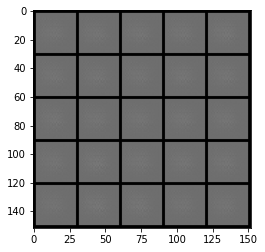

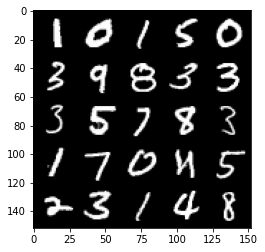

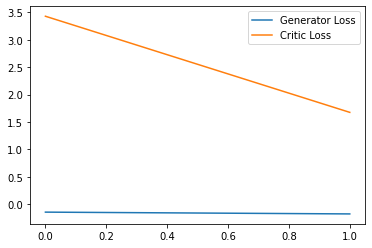

Step 100: Generator loss: 0.9973109360784292, critic loss: -1.9690147653222088


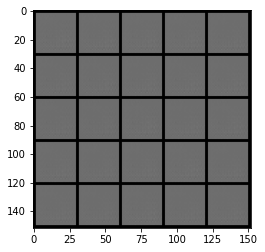

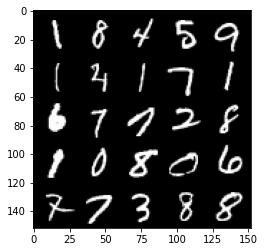

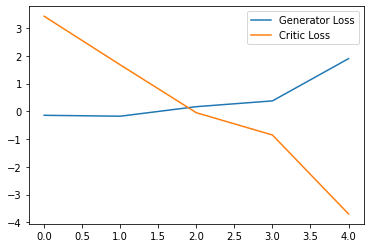

Step 150: Generator loss: 2.53308382332325, critic loss: -10.910133216857911


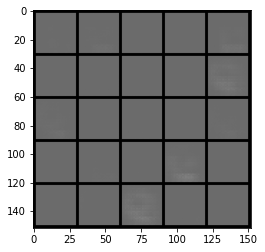

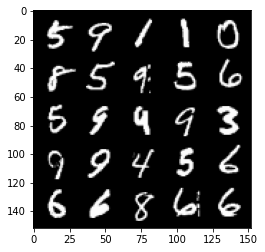

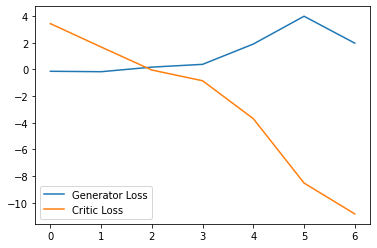

Step 200: Generator loss: -0.4268875750154257, critic loss: -28.52419809722901


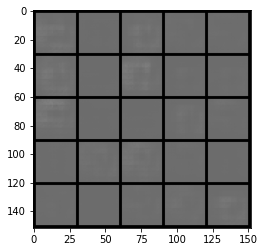

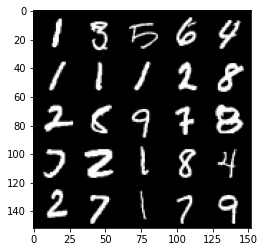

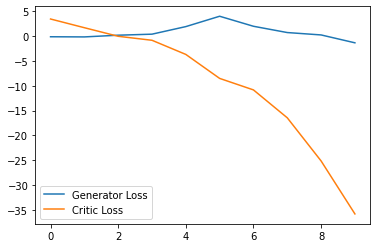

Step 250: Generator loss: -3.3648418188095093, critic loss: -60.23496449279787


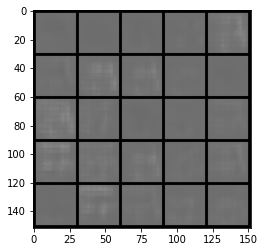

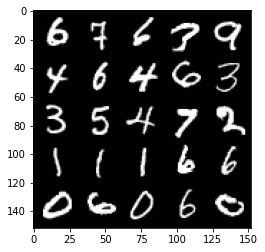

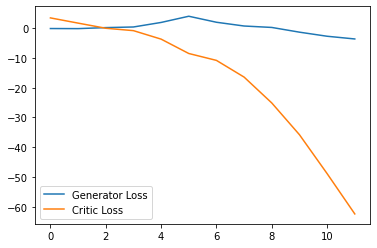

Step 300: Generator loss: -2.5259959414601325, critic loss: -101.63739173889158


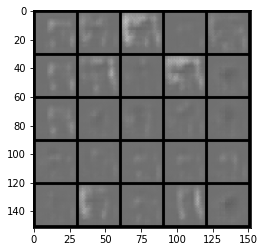

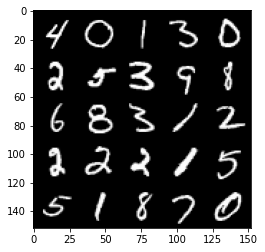

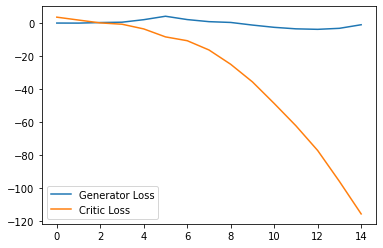

Step 350: Generator loss: 1.2041969448328018, critic loss: -151.11230166625978


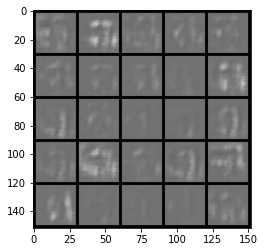

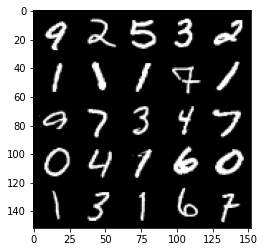

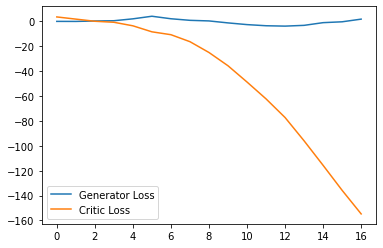

Step 400: Generator loss: 5.867496279478073, critic loss: -209.30875549316406


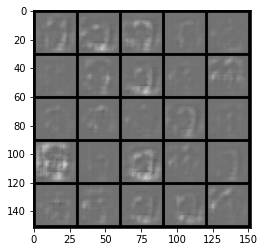

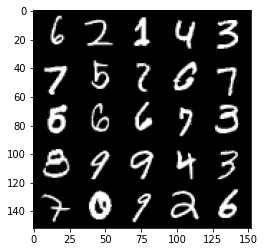

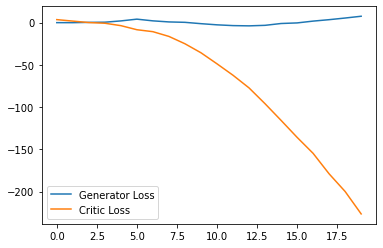

Step 450: Generator loss: 10.62200743675232, critic loss: -253.65446539306635


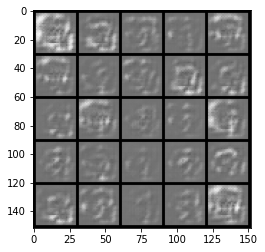

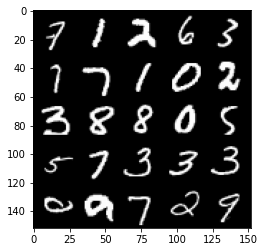

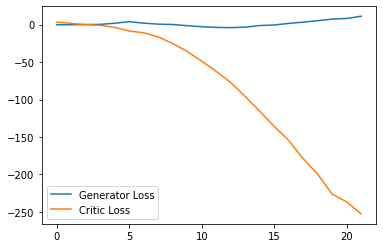

Step 500: Generator loss: -21.46169353365898, critic loss: -213.56937364196787


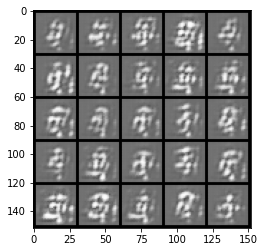

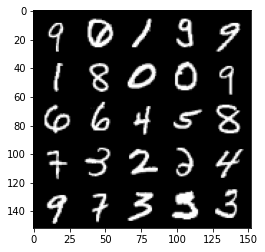

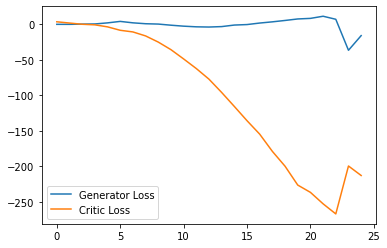

Step 550: Generator loss: 18.171592625379564, critic loss: -256.50289047241205


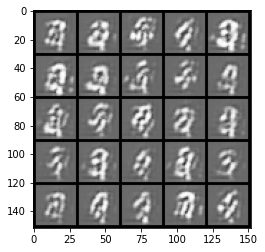

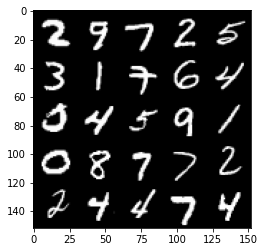

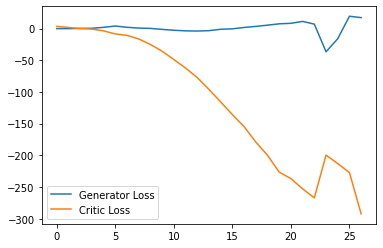

Step 600: Generator loss: 13.869186370372772, critic loss: -303.1608283081055


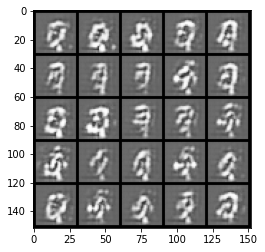

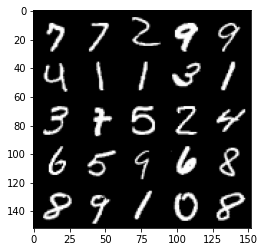

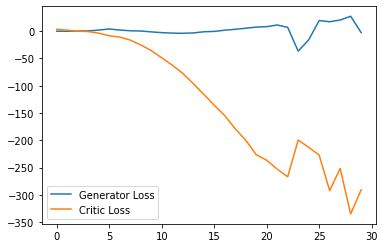

Step 650: Generator loss: 8.319438564777375, critic loss: -306.2447021484375


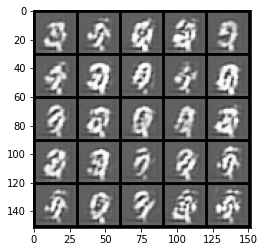

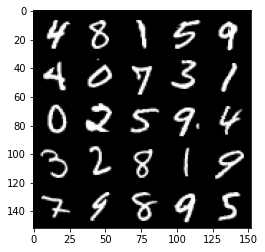

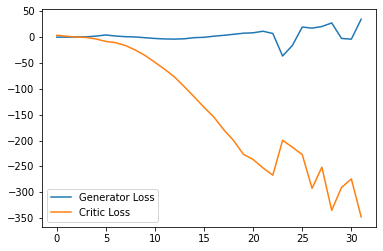

Step 700: Generator loss: 12.376580751538278, critic loss: -305.83832196044926


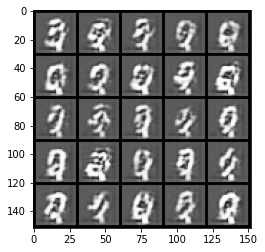

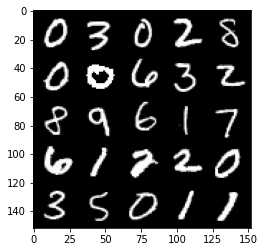

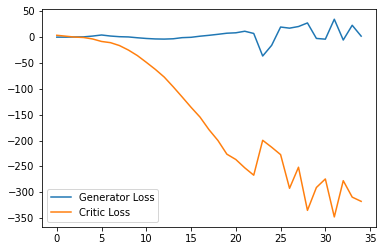

Step 750: Generator loss: 2.352979704141617, critic loss: -307.52218490600586


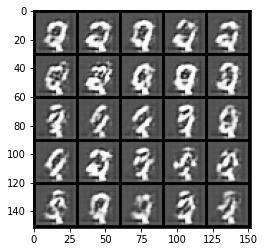

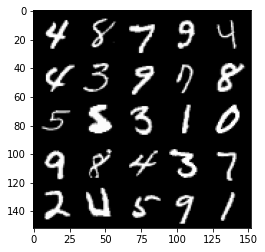

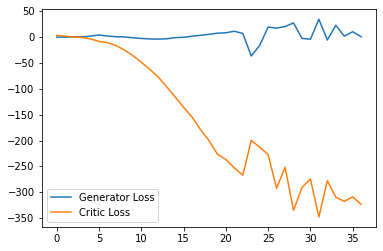

Step 800: Generator loss: -14.963558005094528, critic loss: -257.3080153503417


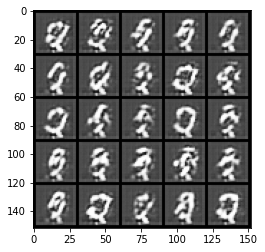

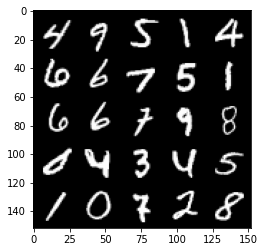

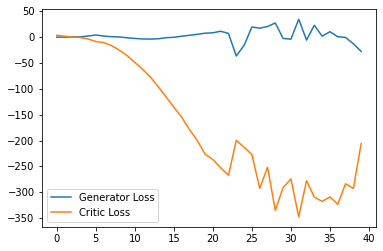

Step 850: Generator loss: -26.50797437131405, critic loss: -193.55955908203126


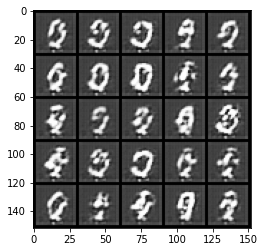

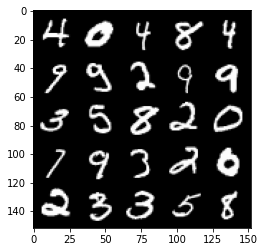

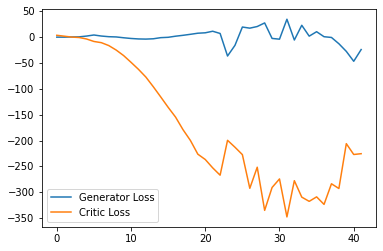

Step 900: Generator loss: -40.30679395198822, critic loss: -177.41792259216305


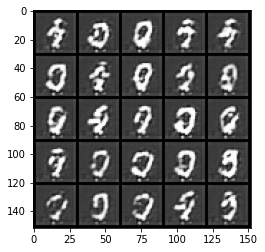

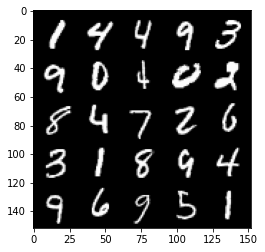

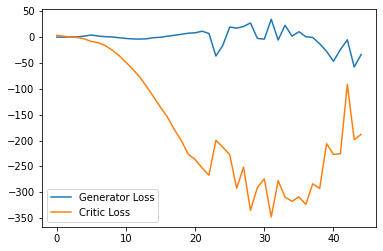

Step 950: Generator loss: -29.95818127512932, critic loss: -132.24269668579103


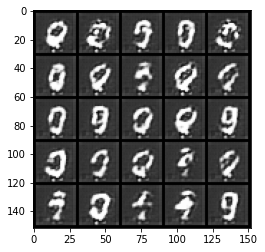

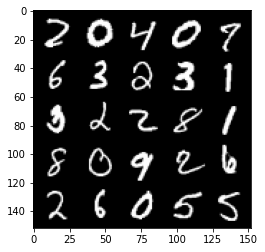

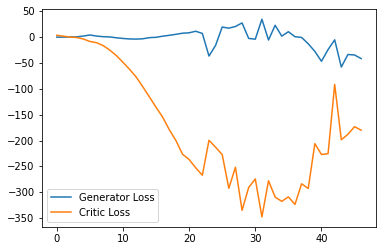

Step 1000: Generator loss: -58.80825068354606, critic loss: -97.13954617309571


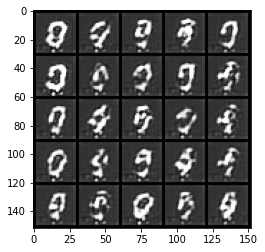

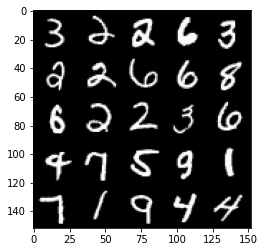

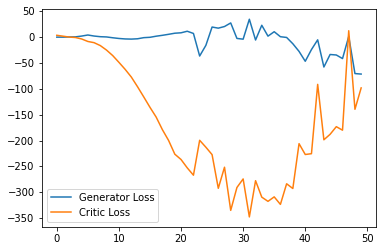

Step 1050: Generator loss: -67.05015027165413, critic loss: -115.64452087402344


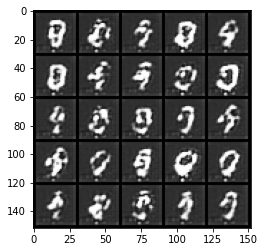

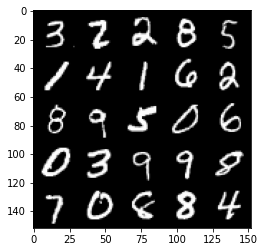

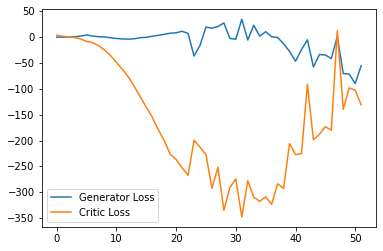

Step 1100: Generator loss: -46.101070146560666, critic loss: -85.26645368576048


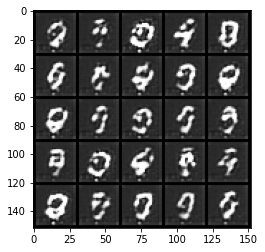

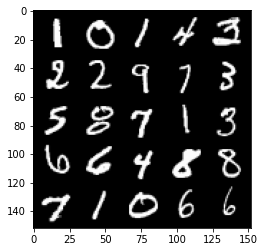

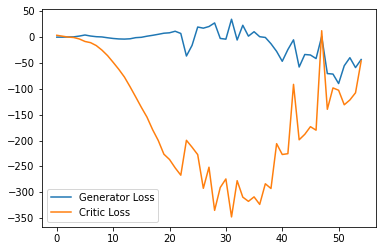

Step 1150: Generator loss: -20.708049135208128, critic loss: -25.588319023132325


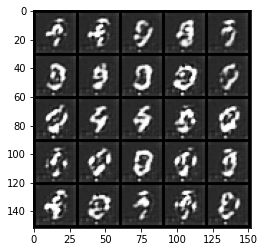

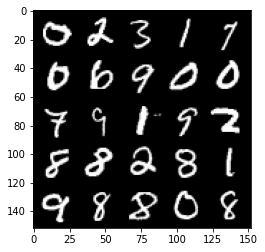

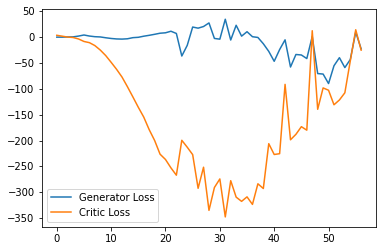

Step 1200: Generator loss: -63.507839336395264, critic loss: -79.05393530273437


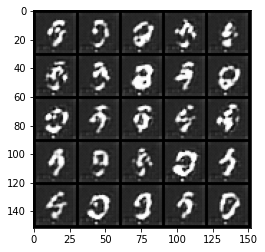

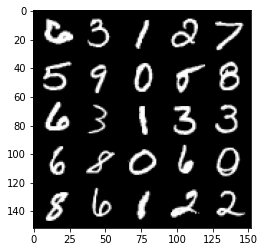

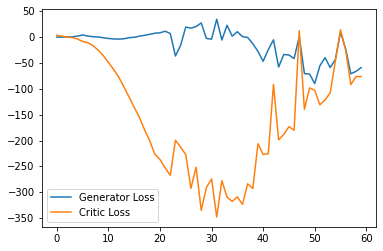

Step 1250: Generator loss: -9.510577082633972, critic loss: 35.4716043434143


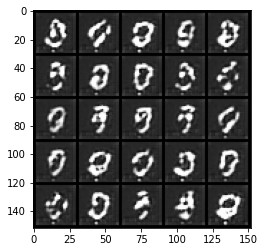

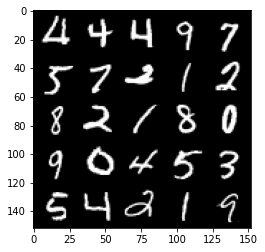

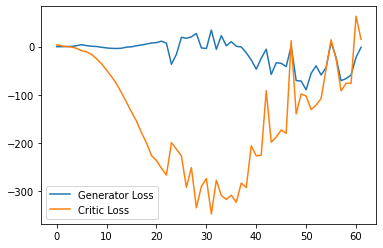

Step 1300: Generator loss: -0.7375499088317156, critic loss: 7.595461427688598


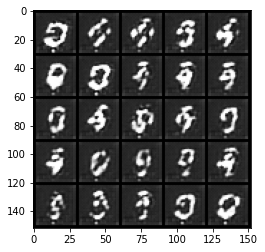

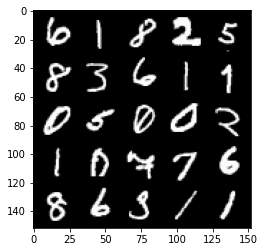

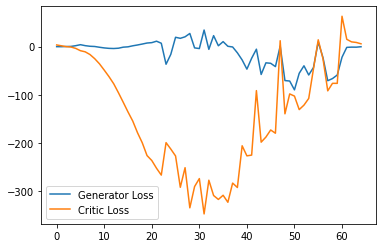

Step 1350: Generator loss: 0.7685455693304539, critic loss: 5.483885473251343


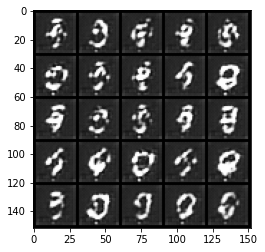

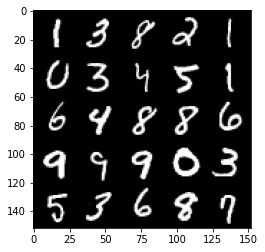

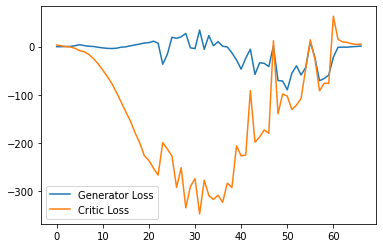

Step 1400: Generator loss: 1.2830491292476653, critic loss: 17.505732233047482


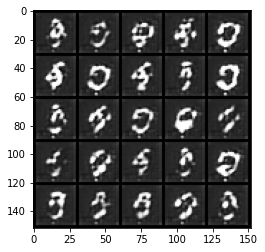

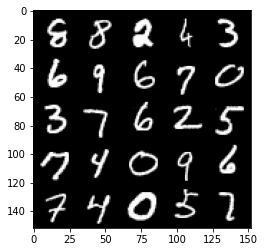

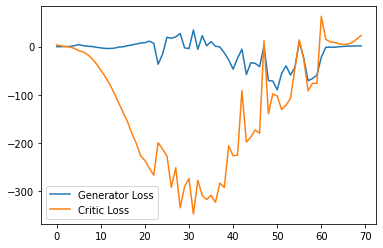

Step 1450: Generator loss: 1.9598278462886811, critic loss: 32.24387384033203


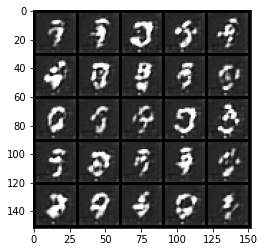

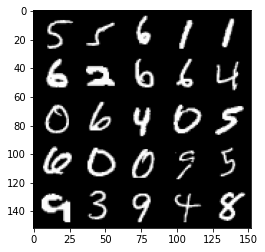

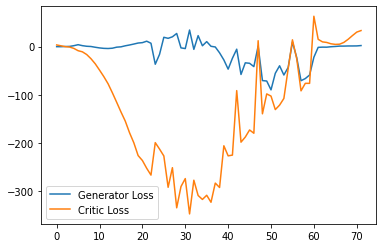

Step 1500: Generator loss: 1.6620608115196227, critic loss: 25.711887443542476


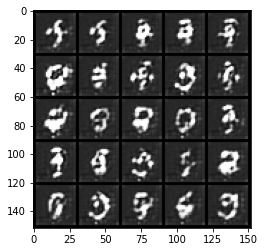

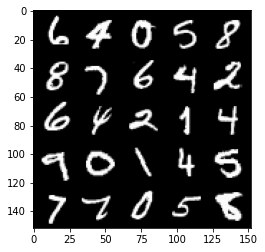

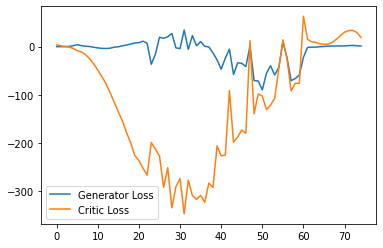

Step 1550: Generator loss: 1.901774924993515, critic loss: 25.012638381958006


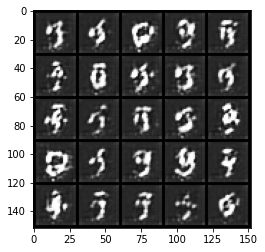

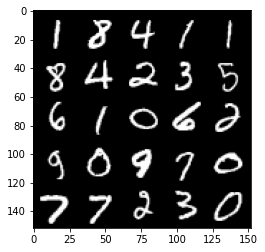

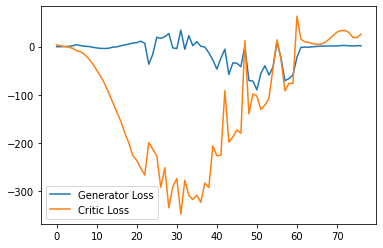

Step 1600: Generator loss: 0.3710978853702545, critic loss: 39.433996795654295


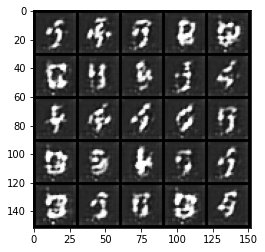

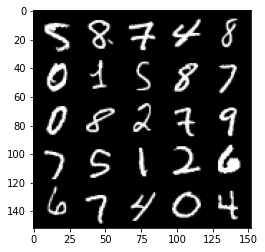

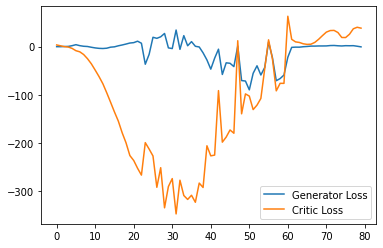

Step 1650: Generator loss: -1.2890729089081288, critic loss: 28.108224288940413


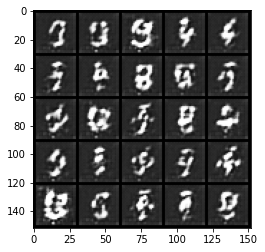

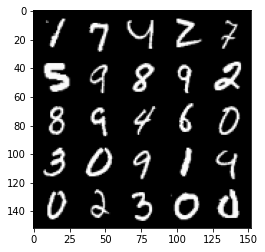

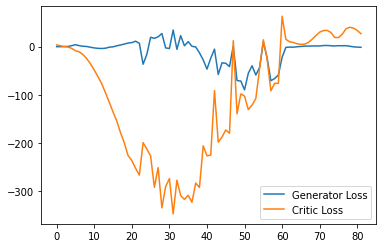

Step 1700: Generator loss: -0.7462445448338986, critic loss: 15.54411561203003


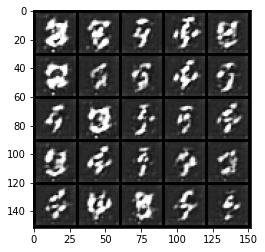

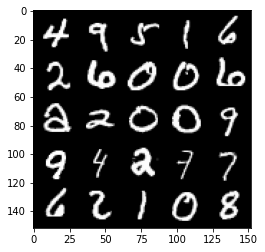

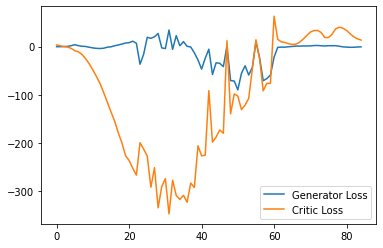

Step 1750: Generator loss: -0.4532358711212873, critic loss: 9.91734487915039


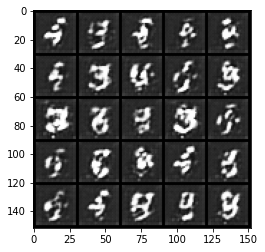

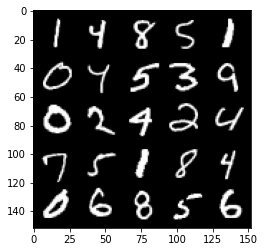

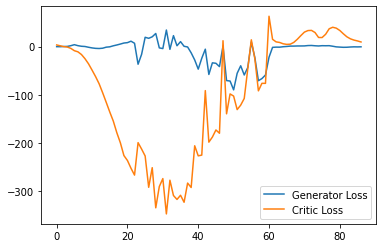

Step 1800: Generator loss: 0.14829024836421012, critic loss: 7.069938709259031


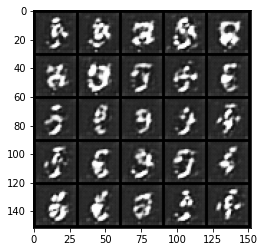

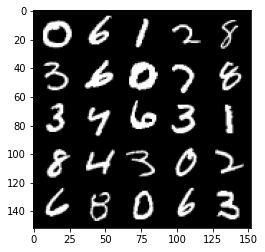

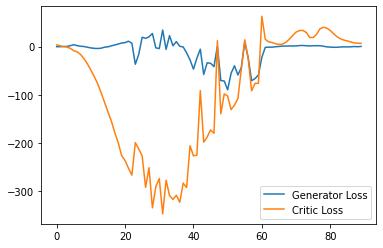

Step 1850: Generator loss: -0.23454482182860376, critic loss: 5.450963941574097


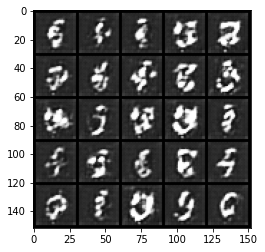

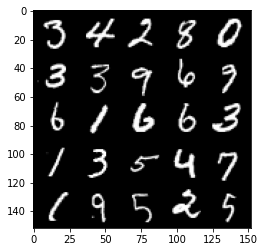

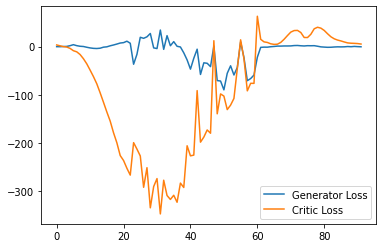

Step 1900: Generator loss: -0.6155276216566563, critic loss: 4.188148439407349


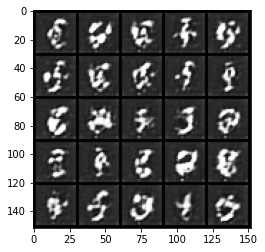

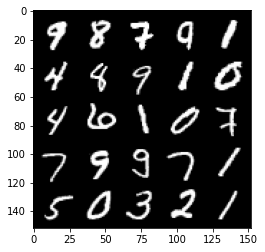

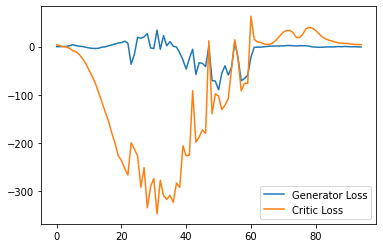

Step 1950: Generator loss: -2.228237173259258, critic loss: 2.084998601913452


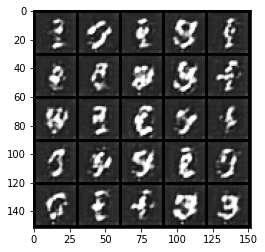

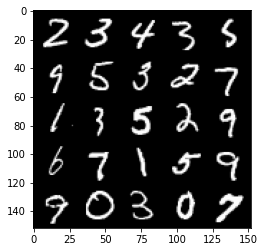

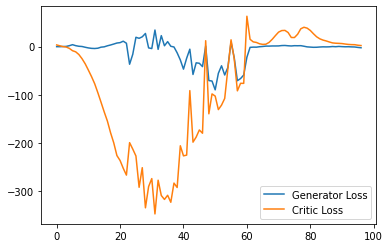

Step 2000: Generator loss: -2.5401551438868046, critic loss: -1.389081922531128


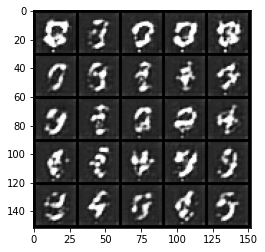

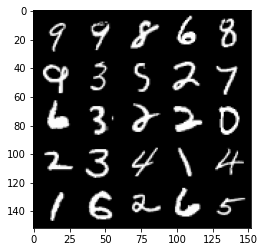

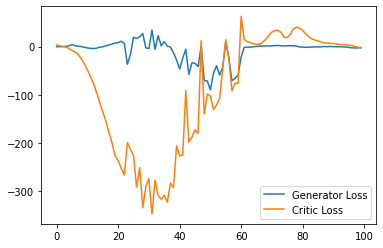

Step 2050: Generator loss: -1.2240743980556728, critic loss: -5.059725254058836


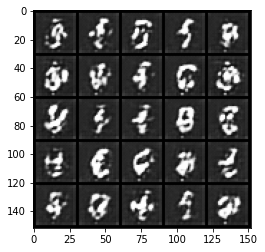

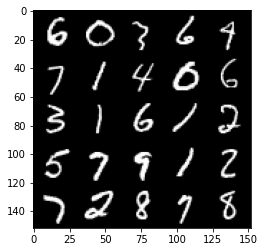

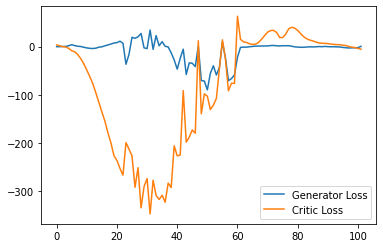

Step 2100: Generator loss: -1.1672963571548463, critic loss: -9.246567993164062


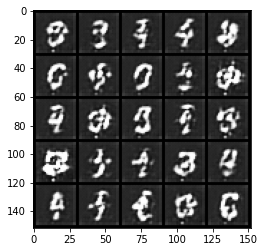

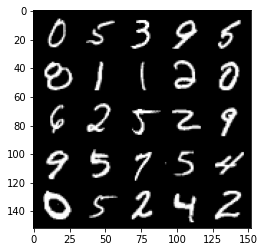

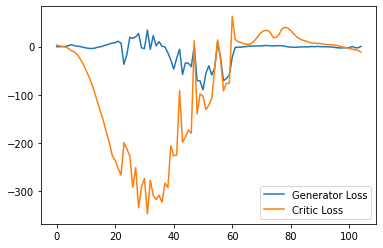

Step 2150: Generator loss: 0.8449612778425216, critic loss: -9.343980873107908


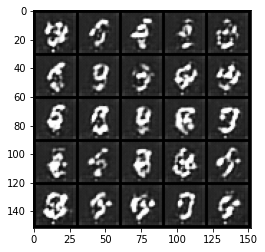

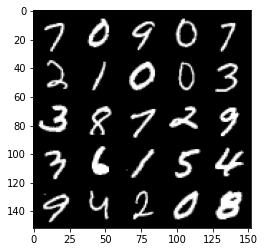

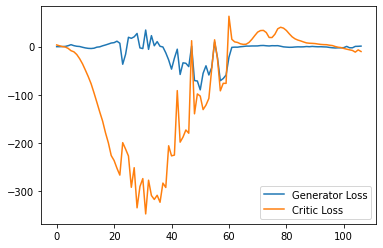

Step 2200: Generator loss: 2.36467409580946, critic loss: -15.492423891067503


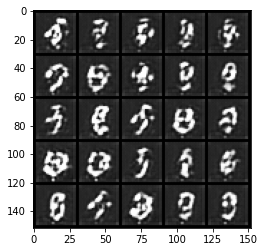

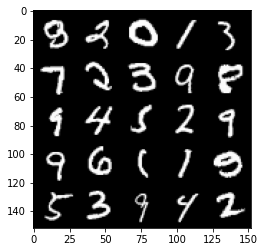

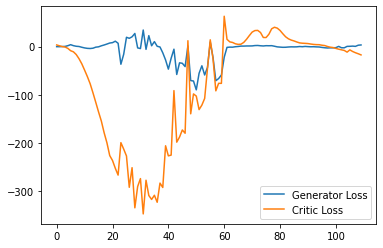

Step 2250: Generator loss: 3.7020584493875504, critic loss: -16.397284284591677


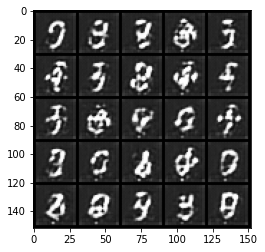

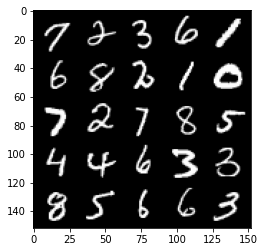

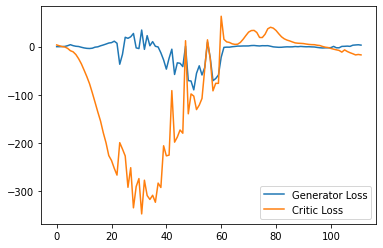

Step 2300: Generator loss: 5.742748699188232, critic loss: -20.747207908630372


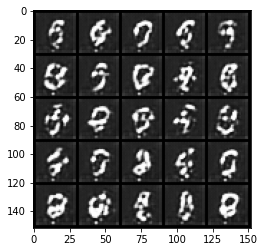

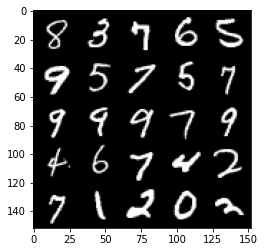

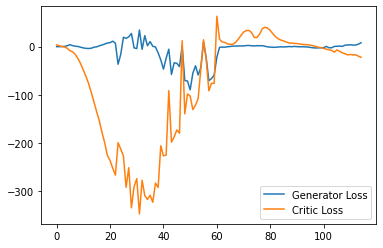

Step 2350: Generator loss: 5.838007717132569, critic loss: -23.13297275161743


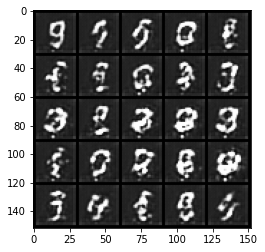

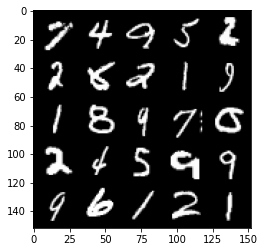

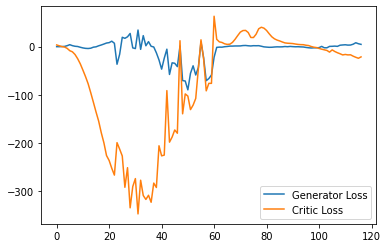

Step 2400: Generator loss: 7.002517606019974, critic loss: -26.2581662902832


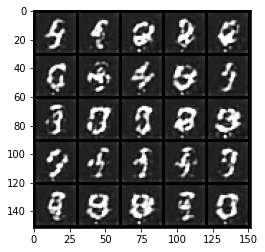

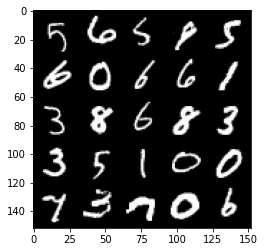

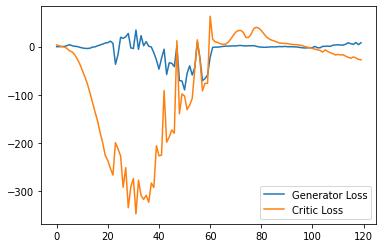

Step 2450: Generator loss: 7.264421148300171, critic loss: -0.49202376365661615


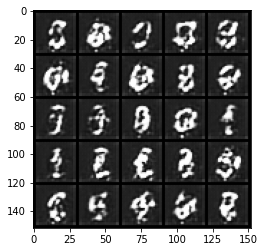

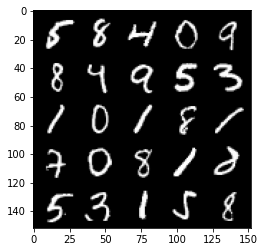

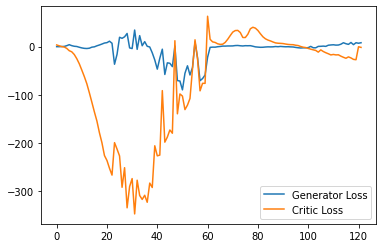

Step 2500: Generator loss: 5.793142957687378, critic loss: -1.3935255122184755


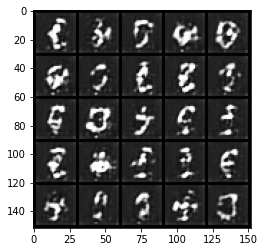

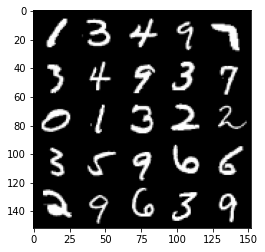

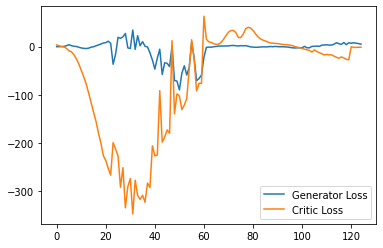

Step 2550: Generator loss: 3.8571165704727175, critic loss: -2.1302647972106934


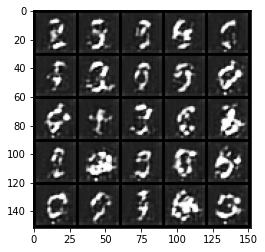

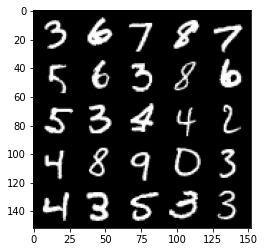

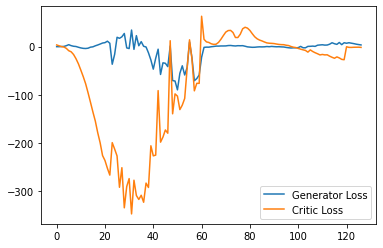

Step 2600: Generator loss: 0.23380413085222243, critic loss: -16.388808685302735


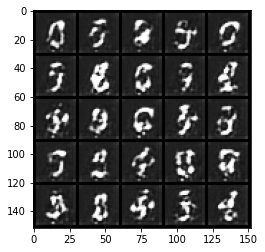

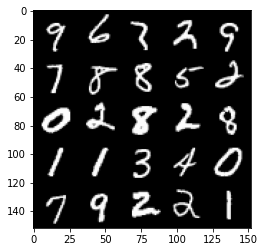

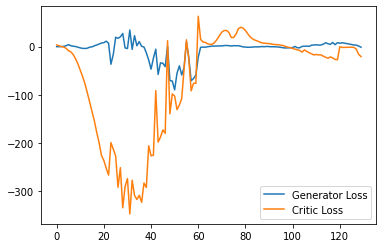

Step 2650: Generator loss: 0.43786208748817446, critic loss: -19.695985760688785


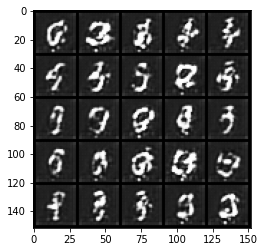

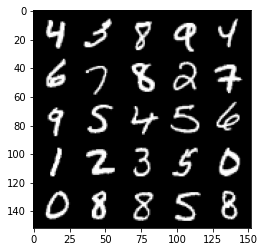

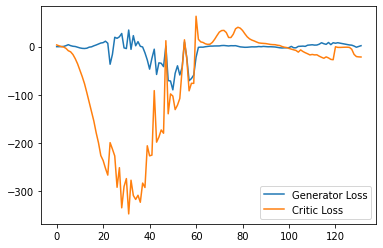

Step 2700: Generator loss: 3.2981591047346592, critic loss: -22.98385175704956


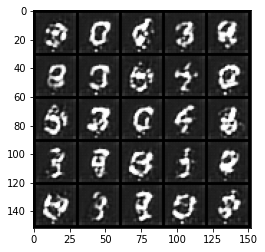

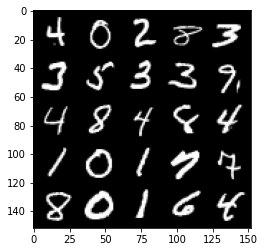

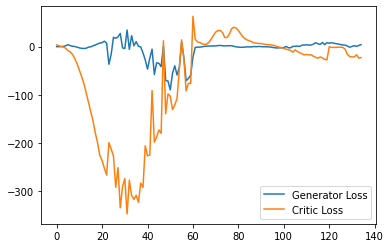

Step 2750: Generator loss: 5.231655288338661, critic loss: -23.502279020309444


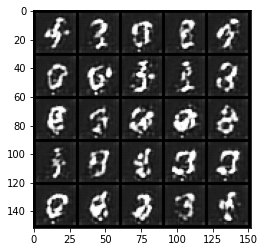

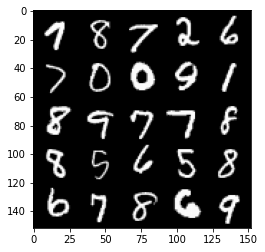

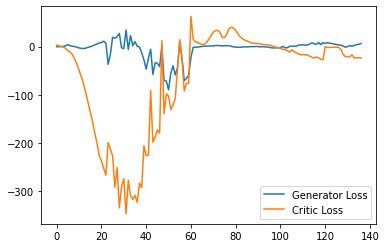

Step 2800: Generator loss: 2.8101830196380617, critic loss: -26.007626146316532


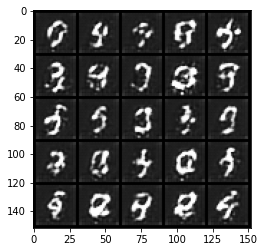

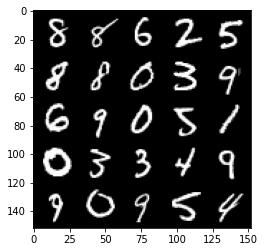

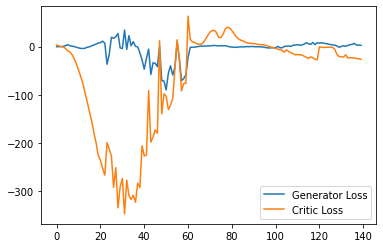

Step 3000: Generator loss: 0.7918649461865425, critic loss: -29.361396356582635


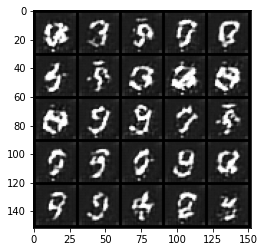

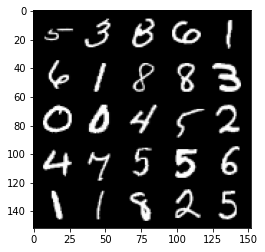

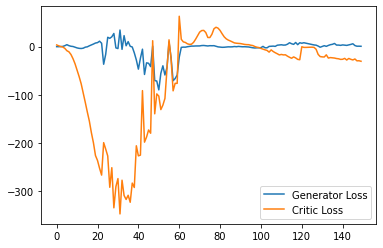

Step 3050: Generator loss: 0.0024189066886901854, critic loss: -28.31141196250915


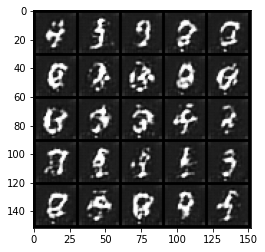

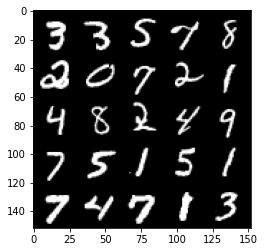

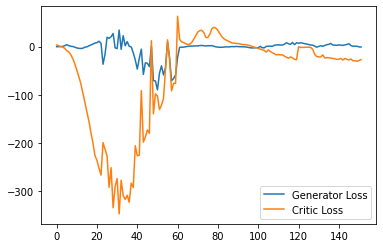

Step 3100: Generator loss: 1.5948180469870568, critic loss: -30.42313848304749


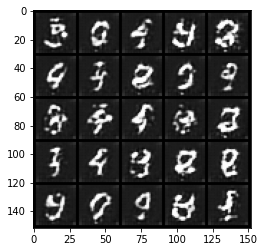

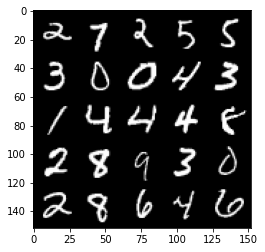

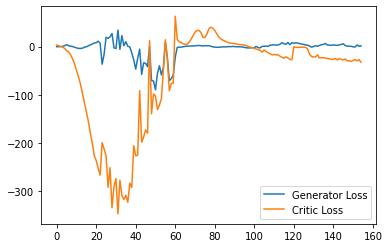

Step 3150: Generator loss: 3.427683099061251, critic loss: -17.823583271980294


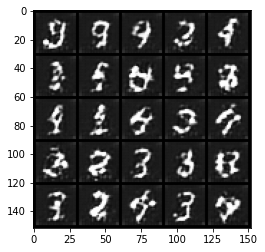

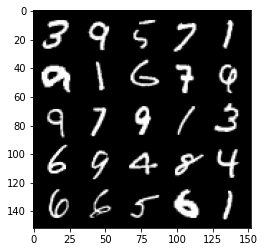

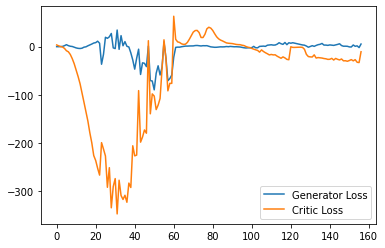

Step 3200: Generator loss: 2.7069731241464616, critic loss: -9.724970430374144


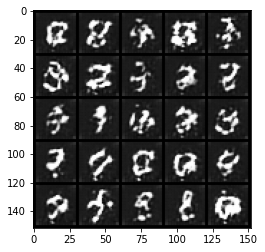

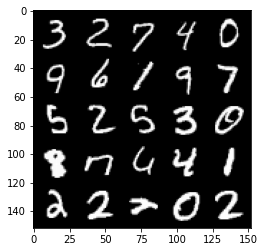

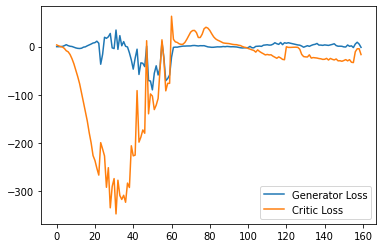

Step 3250: Generator loss: -5.243678553104401, critic loss: -28.104984165191652


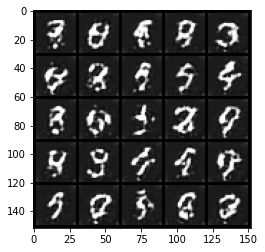

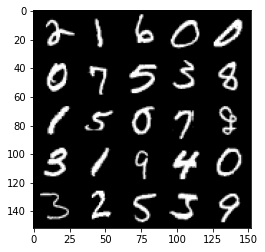

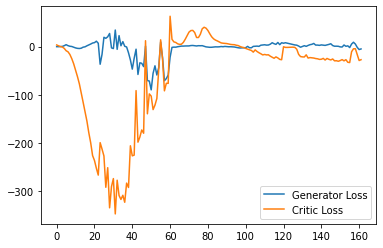

Step 3300: Generator loss: -2.7306566309928892, critic loss: -28.33818151664733


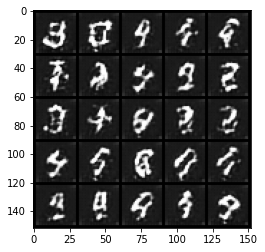

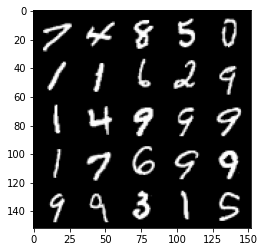

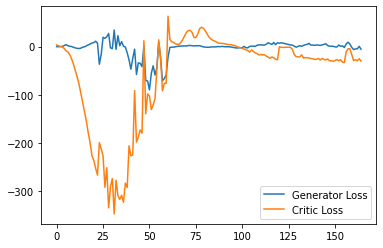

Step 3350: Generator loss: -4.219871805310249, critic loss: -26.38363327407837


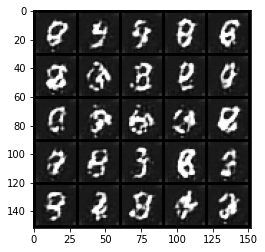

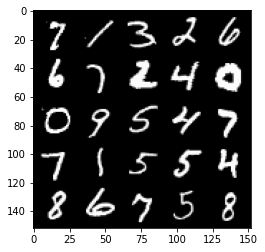

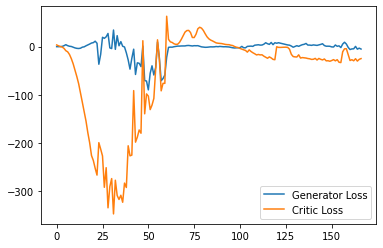

Step 3400: Generator loss: 0.5889017752185464, critic loss: -18.266018214225763


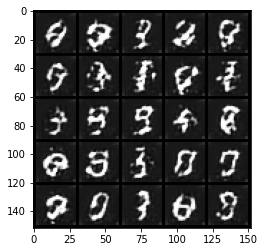

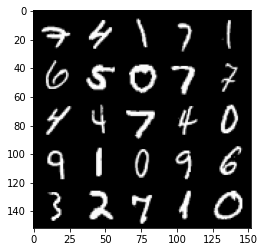

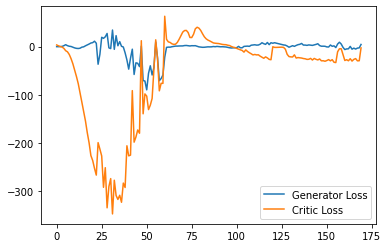

Step 3450: Generator loss: -0.7251506215333938, critic loss: -18.09678490257263


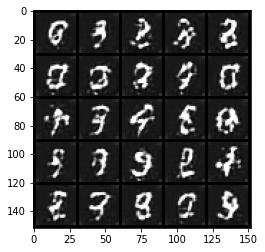

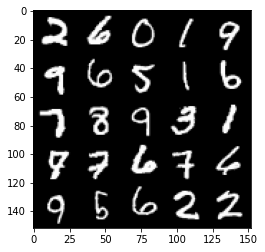

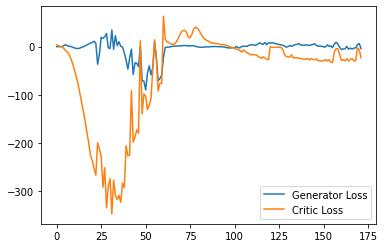

Step 3500: Generator loss: -5.834726751446724, critic loss: -27.997206000328063


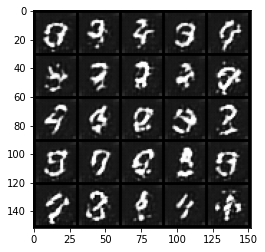

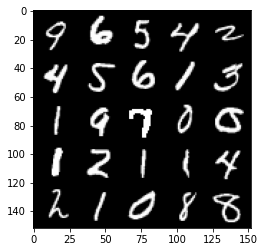

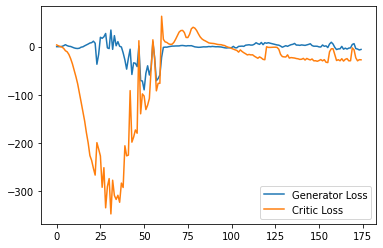

Step 3550: Generator loss: -5.409315124154091, critic loss: -22.08270080566406


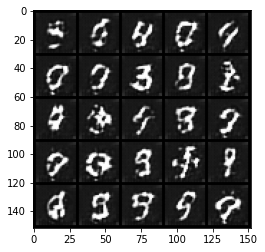

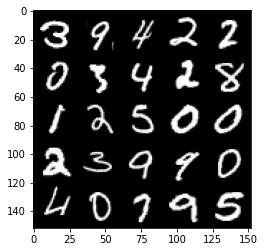

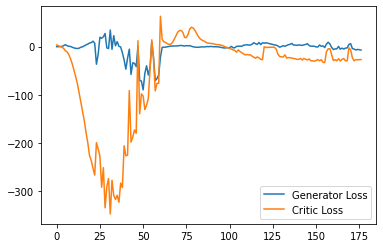

Step 3600: Generator loss: -3.9465126967430115, critic loss: -25.840281908035276


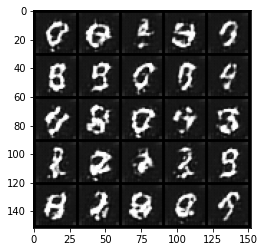

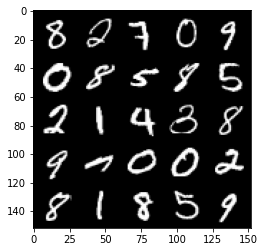

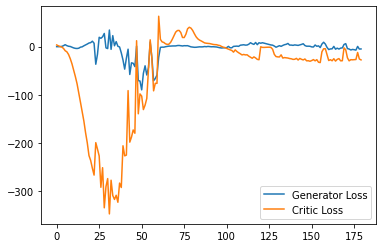

Step 3650: Generator loss: -6.496253054141999, critic loss: -27.7037156791687


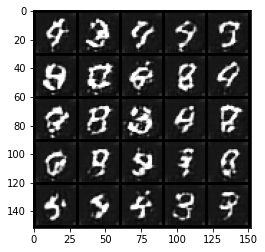

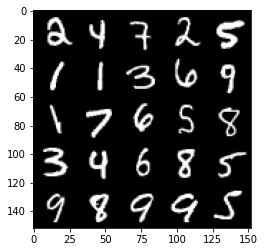

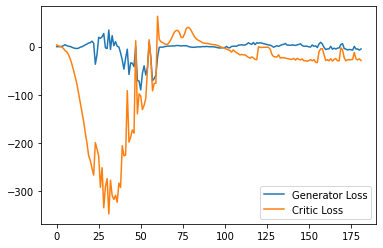

Step 3700: Generator loss: -5.380044455528259, critic loss: -24.820755319595342


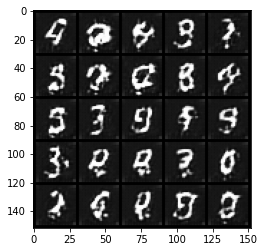

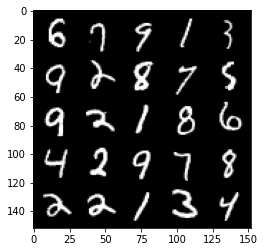

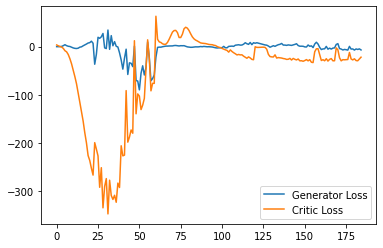

Step 3750: Generator loss: -4.595615431666374, critic loss: -25.620587048530574


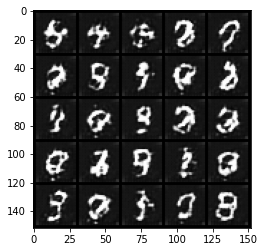

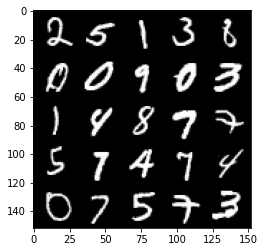

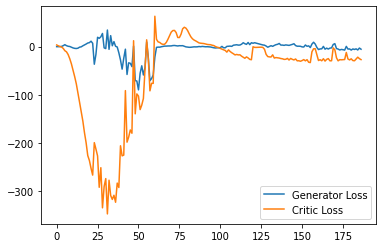

Step 3800: Generator loss: 4.7675413680076595, critic loss: 0.31765734720230066


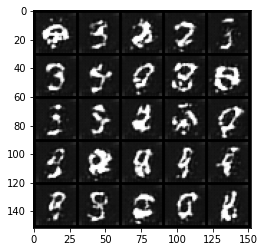

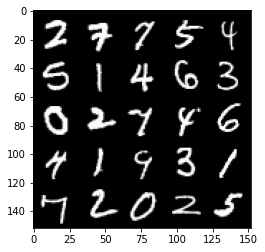

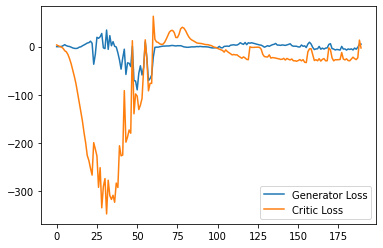

Step 3850: Generator loss: 3.4723517394065855, critic loss: -2.7287775826454164


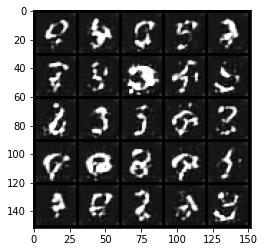

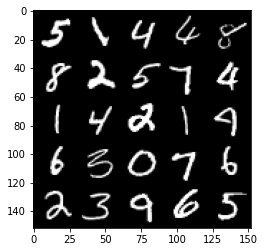

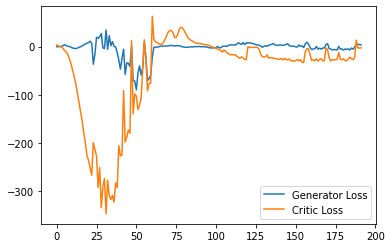

Step 3900: Generator loss: -3.0578956029564144, critic loss: -1.4904069423675534


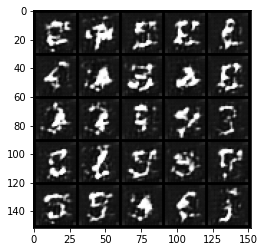

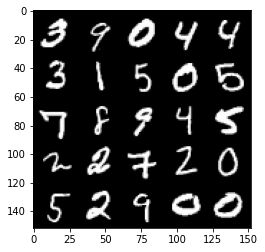

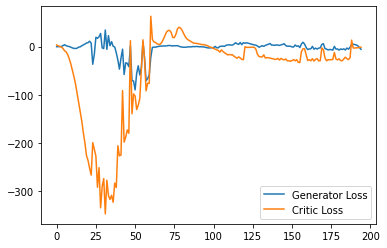

Step 3950: Generator loss: -5.4569323539733885, critic loss: -3.478835570335388


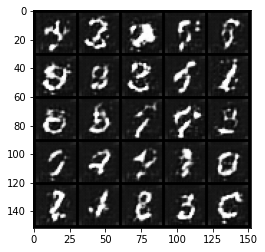

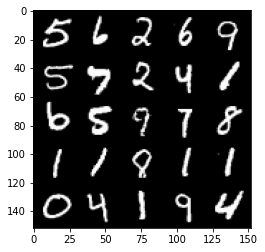

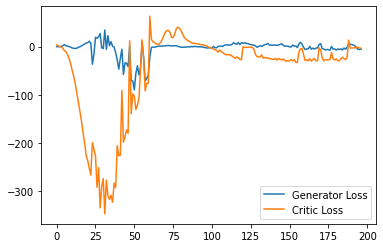

Step 4000: Generator loss: -8.324463514983654, critic loss: -8.521252260208133


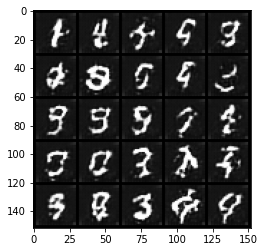

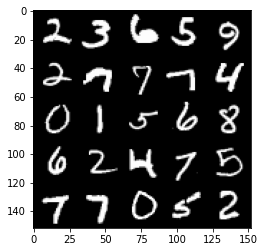

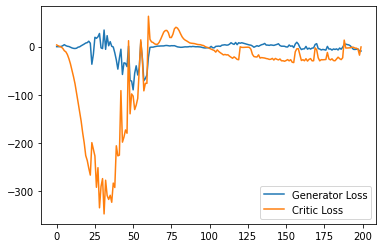

Step 4050: Generator loss: 0.9578006793558598, critic loss: -1.3284770030975341


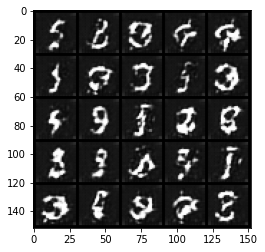

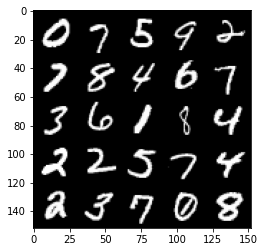

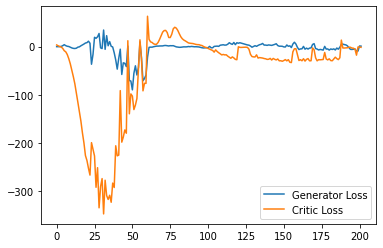

Step 4100: Generator loss: -1.1355669731646776, critic loss: -1.6840689568519591


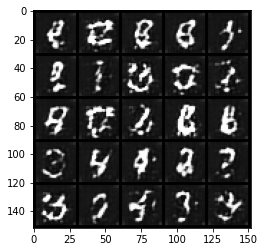

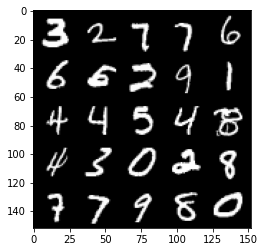

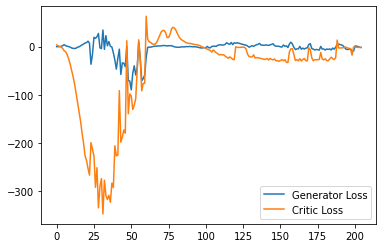

Step 4150: Generator loss: -2.7392786836624143, critic loss: -1.7179811625480652


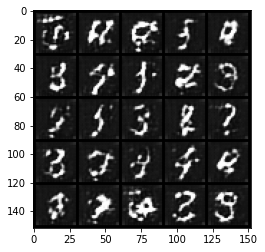

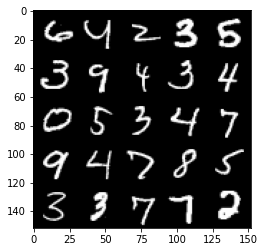

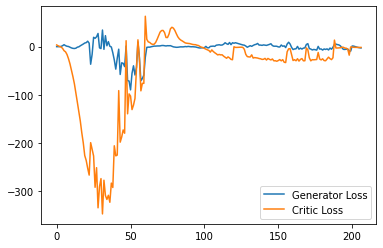

Step 4200: Generator loss: -3.961592984199524, critic loss: -1.7664845261573792


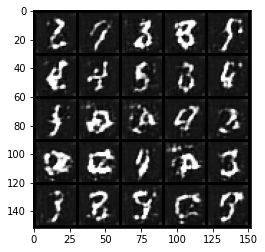

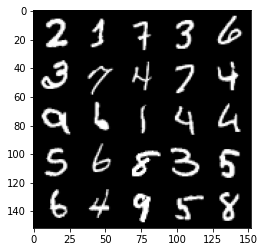

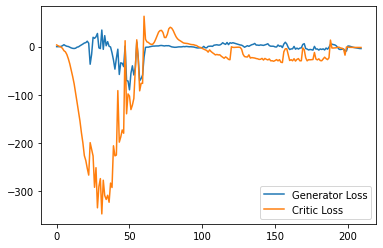

Step 4250: Generator loss: -4.2387149477005, critic loss: -1.9747584571838377


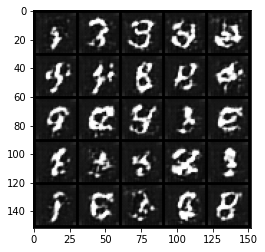

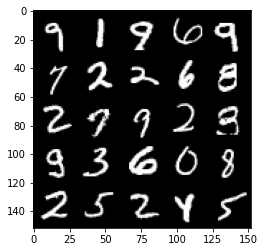

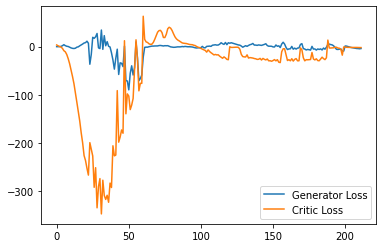

Step 4300: Generator loss: -3.695619516372681, critic loss: -2.2127210116386413


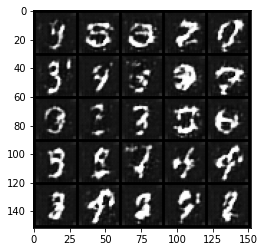

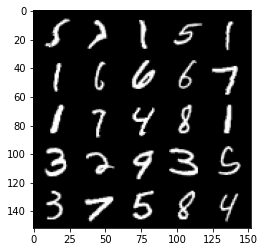

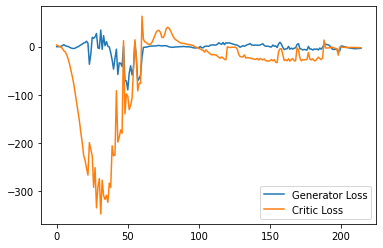

Step 4350: Generator loss: -3.798023862838745, critic loss: -2.602391345977784


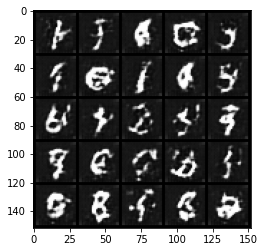

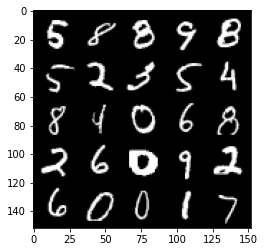

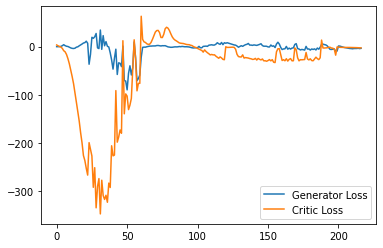

Step 4400: Generator loss: -3.8300713682174683, critic loss: -3.3717475309371947


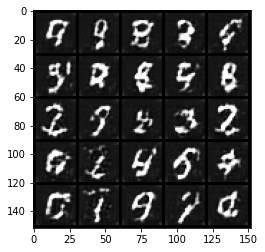

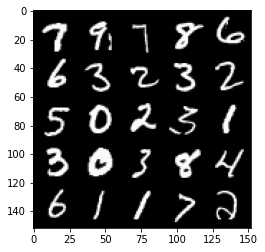

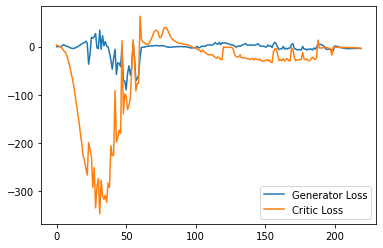

Step 4450: Generator loss: -4.911669778823852, critic loss: -3.8389730842113488


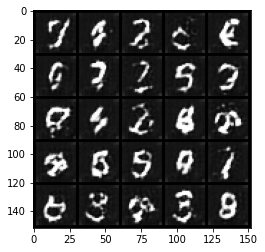

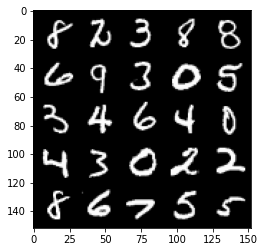

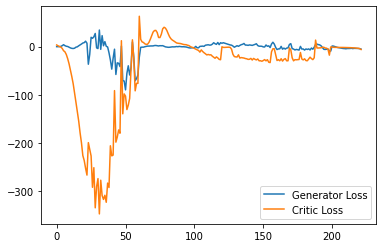

Step 4500: Generator loss: -2.597648001909256, critic loss: -2.233183769226074


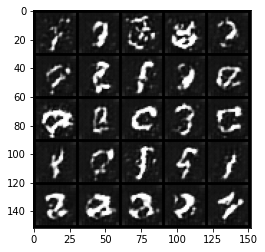

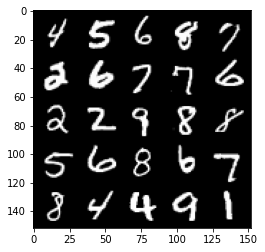

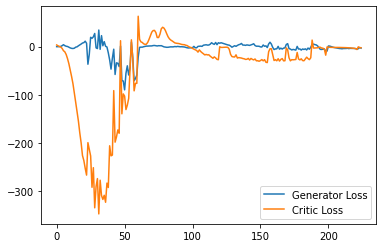

Step 4550: Generator loss: -4.873014588356018, critic loss: -4.3860523710250865


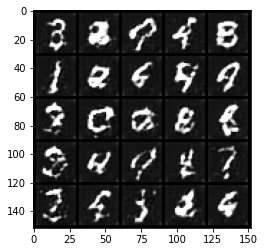

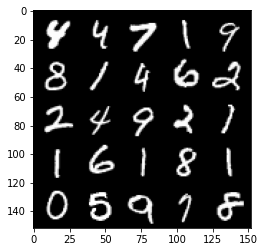

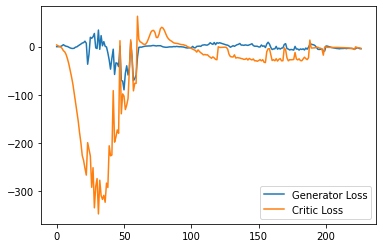

Step 4600: Generator loss: -6.078919761776924, critic loss: -8.578912208557126


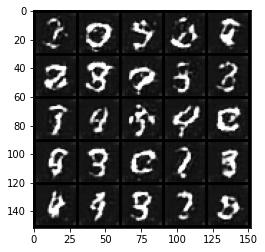

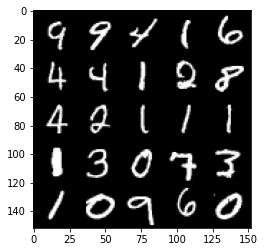

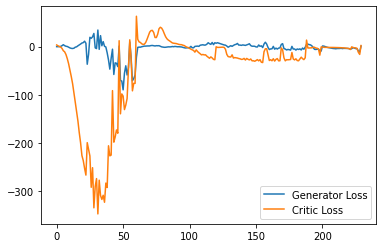

Step 4650: Generator loss: 0.6192180521786212, critic loss: -2.8552655401229856


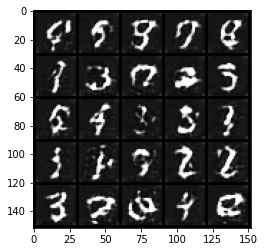

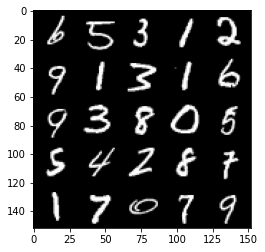

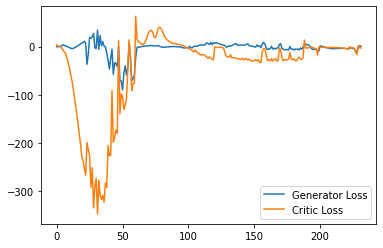

Step 4700: Generator loss: -5.612249443531036, critic loss: -7.800883118629456


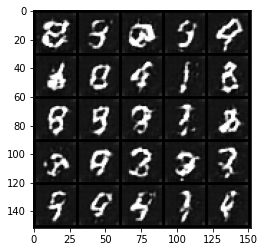

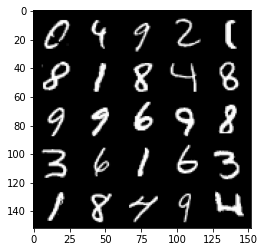

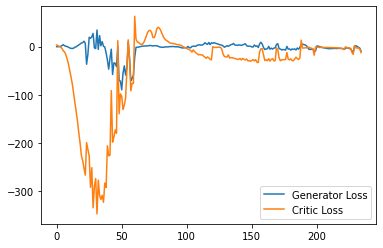

Step 4750: Generator loss: -1.0044605398178101, critic loss: -5.111767807006837


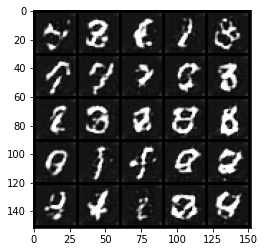

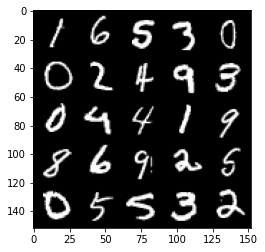

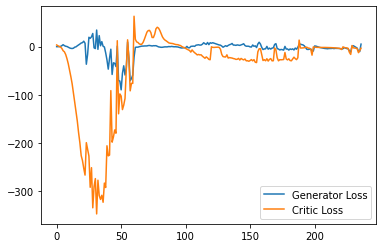

Step 4800: Generator loss: -5.420368217974901, critic loss: -11.729985518932342


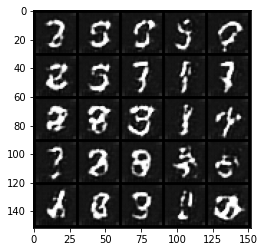

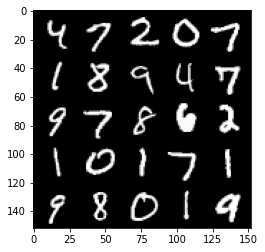

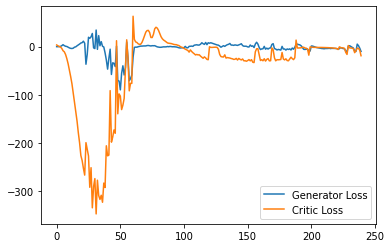

Step 4850: Generator loss: -7.296430072188377, critic loss: -21.721482521057126


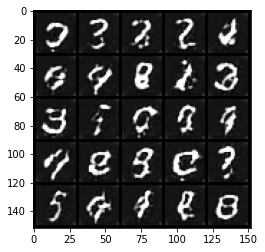

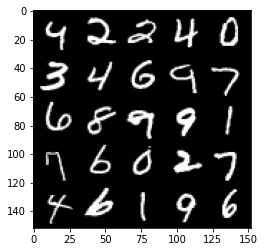

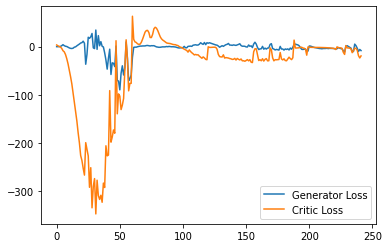

Step 4900: Generator loss: -7.139154681861401, critic loss: -21.705523643493652


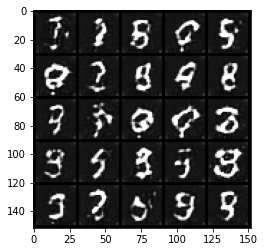

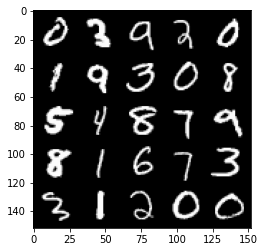

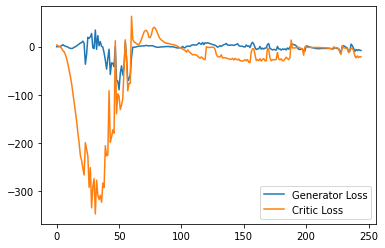

Step 4950: Generator loss: -6.751869463920594, critic loss: -21.22126212310791


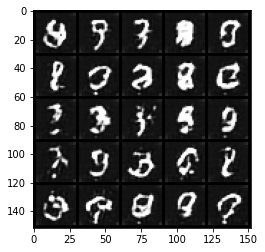

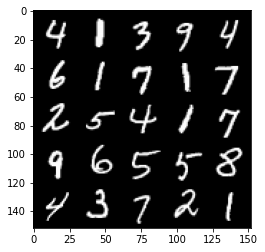

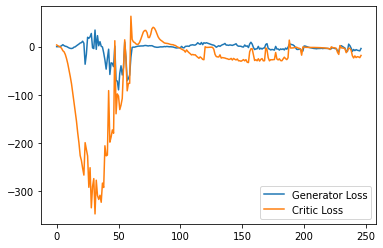

Step 5000: Generator loss: -2.721222384572029, critic loss: -7.876065830230711


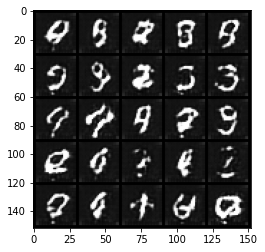

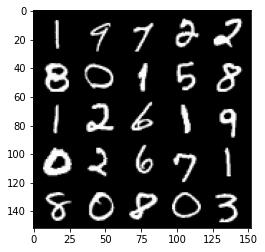

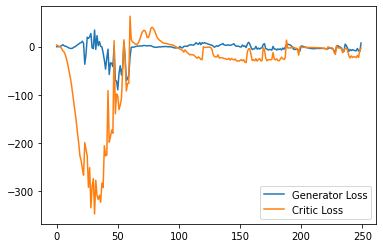

Step 5050: Generator loss: 4.237029612064362, critic loss: -2.9649096841812144


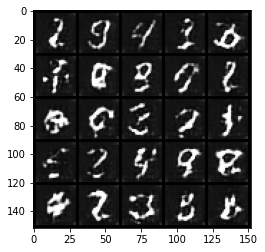

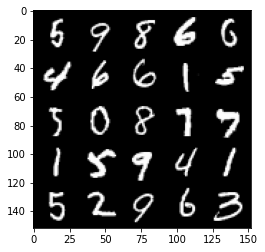

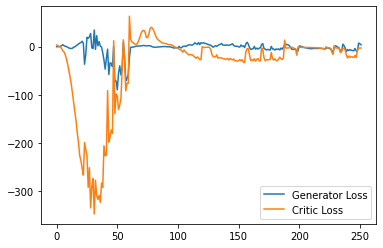

Step 5100: Generator loss: -0.7043740026652813, critic loss: -5.936647388458251


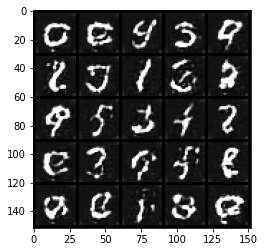

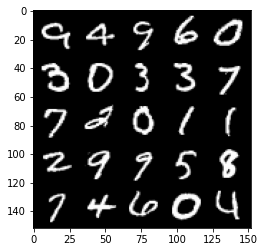

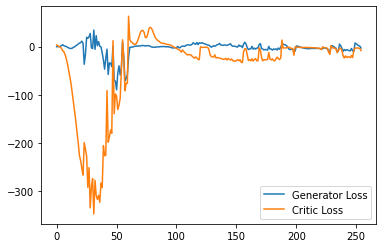

Step 5150: Generator loss: -9.904431029558182, critic loss: -22.013573571681977


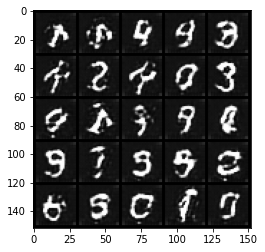

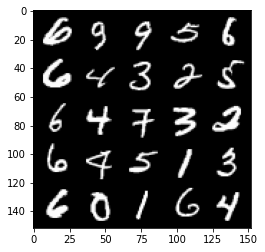

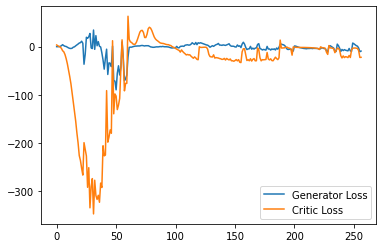

Step 5200: Generator loss: -7.4153208875656125, critic loss: -21.369988637924187


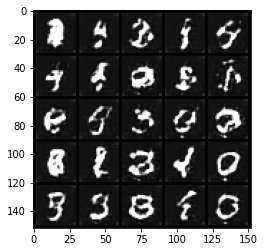

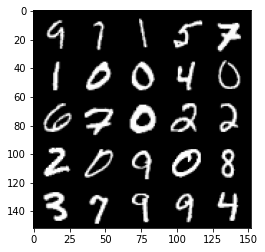

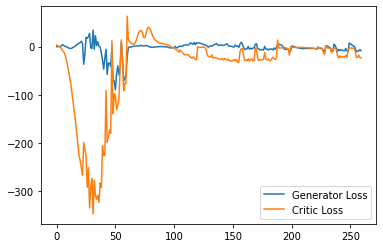

Step 5250: Generator loss: 3.638258595466614, critic loss: 1.0144250659942622


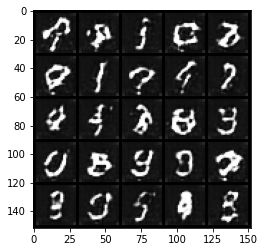

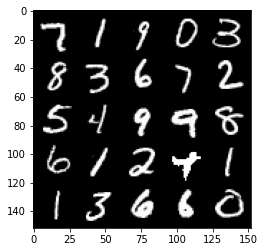

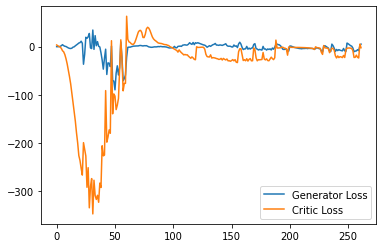

Step 5300: Generator loss: -0.7855250301957131, critic loss: -2.1802839117050175


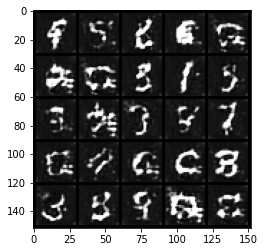

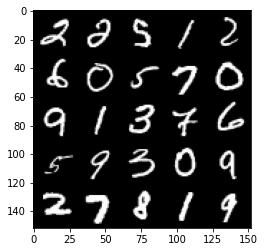

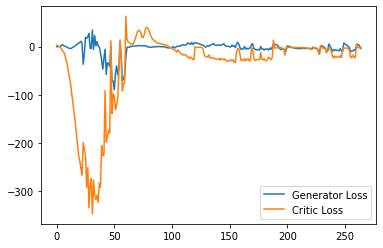

Step 5350: Generator loss: -2.892684998512268, critic loss: -3.3628053560256954


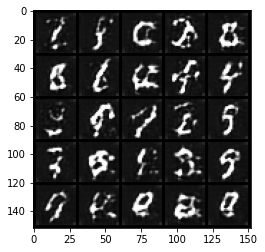

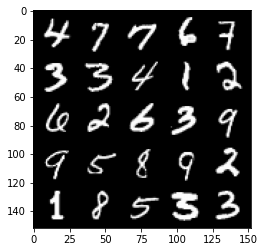

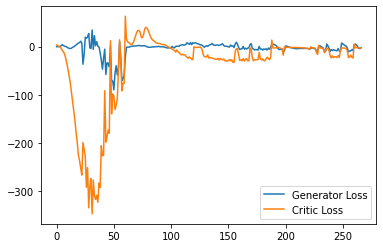

Step 5400: Generator loss: -8.895991163253784, critic loss: -16.90720628833771


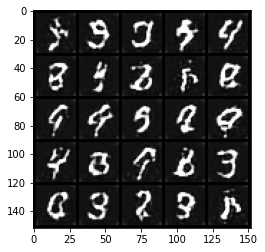

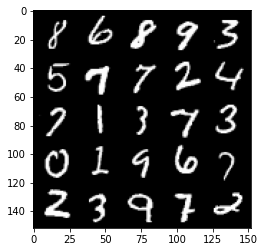

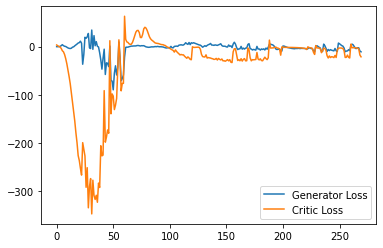

Step 5450: Generator loss: -8.662662397623063, critic loss: -21.11709581089019


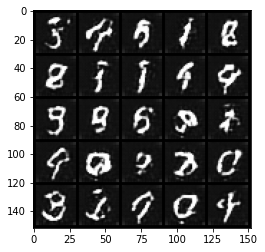

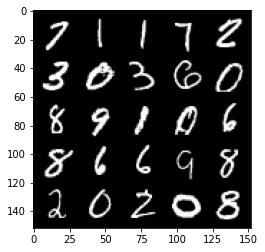

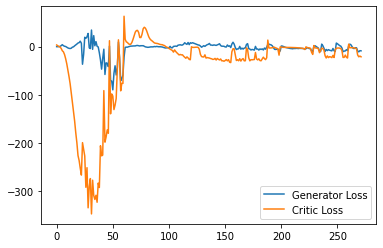

Step 5500: Generator loss: -1.4942587380111219, critic loss: -17.140822553634642


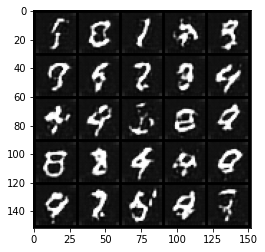

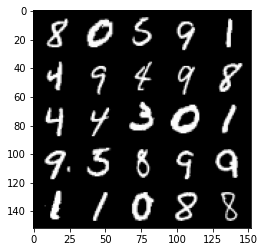

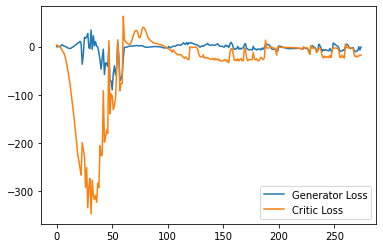

Step 5550: Generator loss: -0.3376953339576721, critic loss: -4.425370458126069


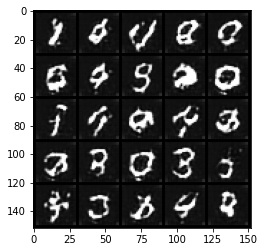

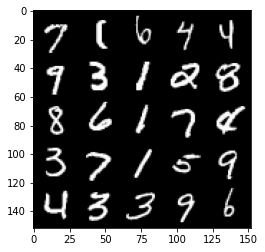

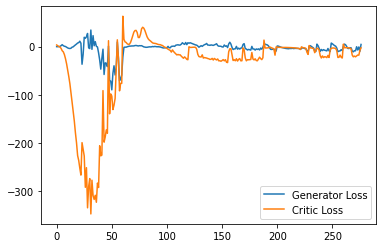

Step 5600: Generator loss: 4.607739214897156, critic loss: -3.1214856166839606


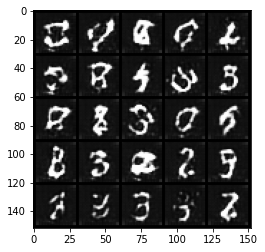

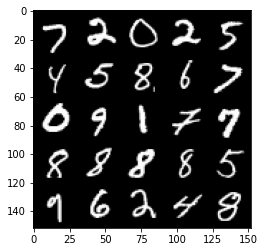

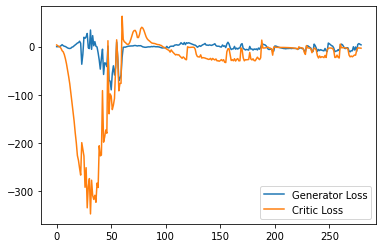

Step 5650: Generator loss: 0.1818662965297699, critic loss: -5.299850491523744


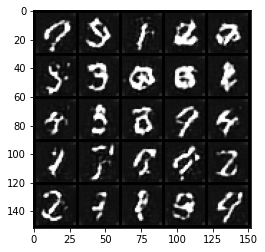

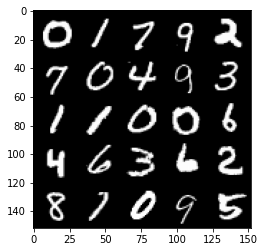

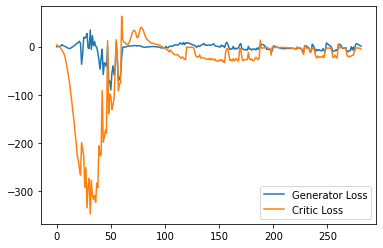

Step 5700: Generator loss: 2.937511429786682, critic loss: -2.810314098358155


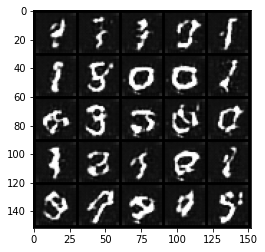

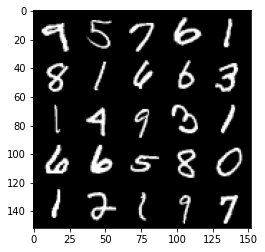

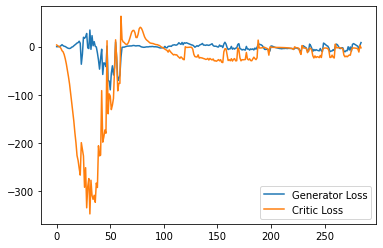

Step 5750: Generator loss: 4.49138560295105, critic loss: -2.8718307943344117


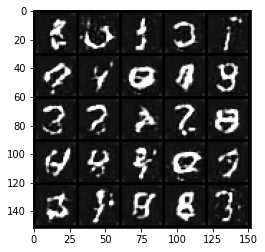

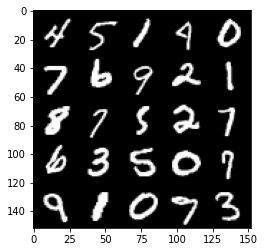

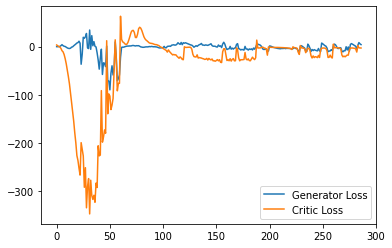

Step 5800: Generator loss: 1.4960814020037652, critic loss: -6.544466603279114


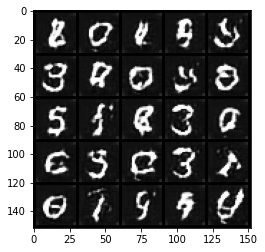

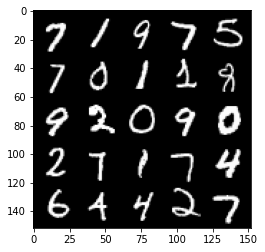

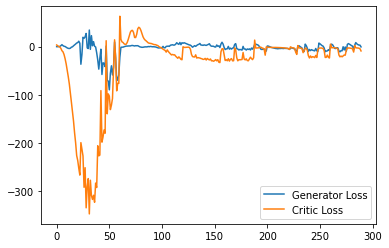

Step 5850: Generator loss: -6.730496383905411, critic loss: -17.51176638126373


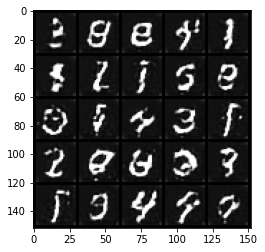

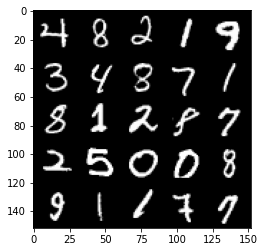

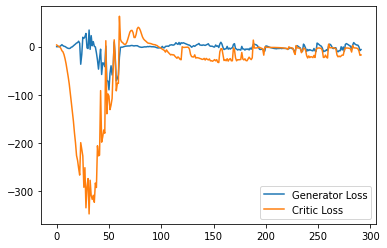

Step 5900: Generator loss: 4.412185810208321, critic loss: -5.9513804454803445


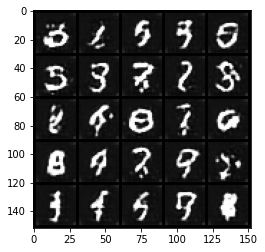

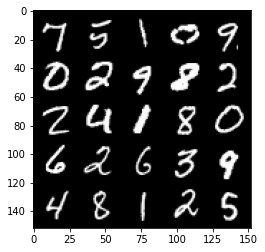

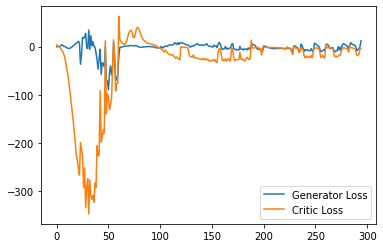

Step 5950: Generator loss: 6.8530348515510555, critic loss: -6.532903953552245


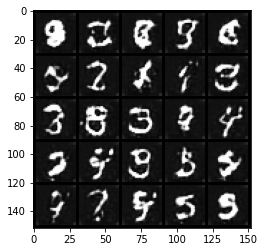

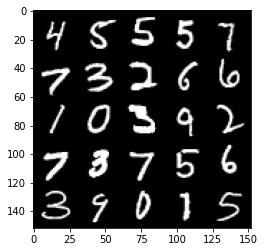

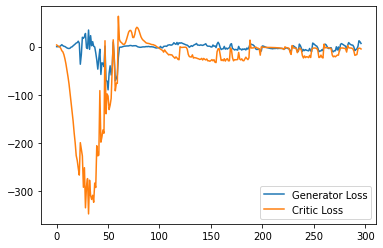

Step 6000: Generator loss: -2.7851138323545457, critic loss: -20.136181873083117


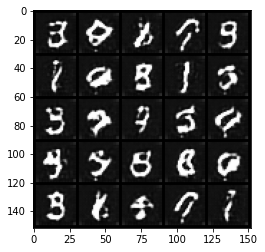

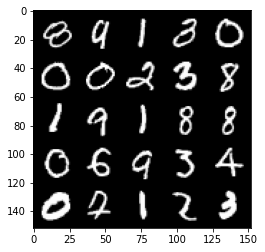

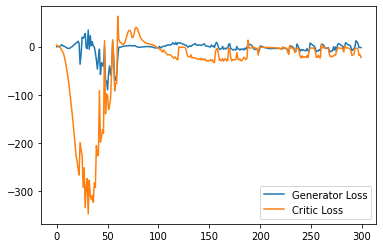

Step 6050: Generator loss: -0.38729979455471036, critic loss: -19.63391003894806


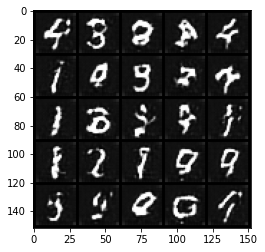

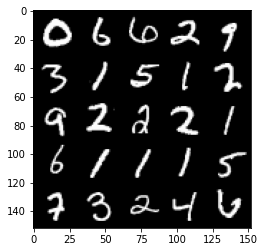

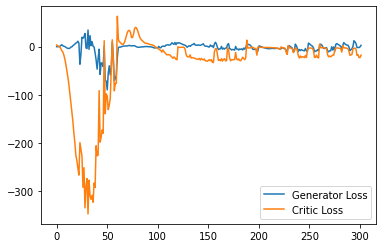

Step 6100: Generator loss: 1.0407110381126403, critic loss: -19.09324088430404


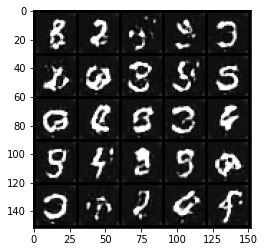

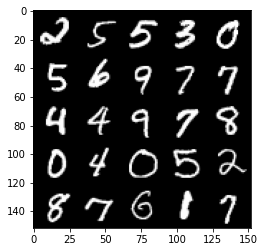

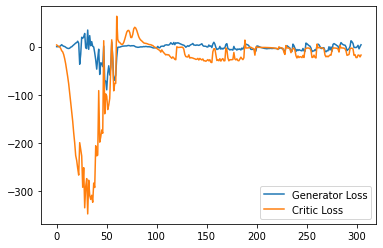

Step 6150: Generator loss: -2.3645322784781455, critic loss: -19.78626376867294


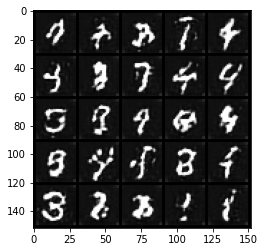

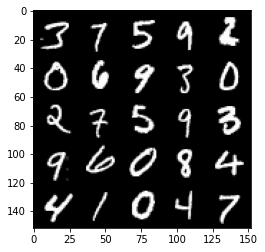

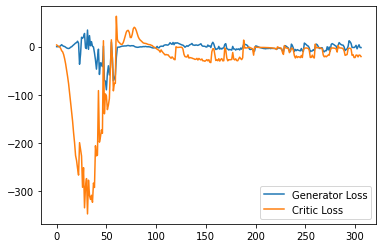

Step 6200: Generator loss: -0.6230754470825195, critic loss: -20.419807144165027


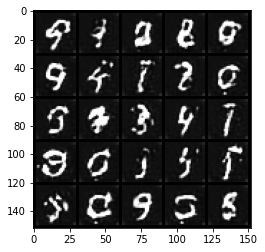

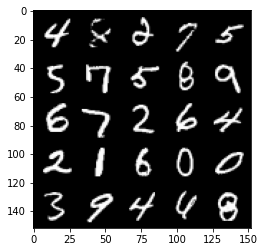

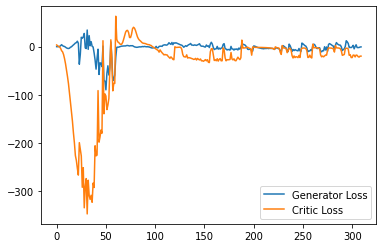

Step 6250: Generator loss: 1.2798107534646987, critic loss: -13.878301737308504


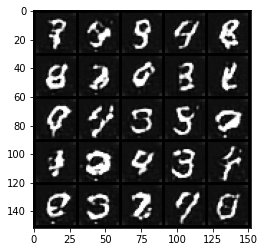

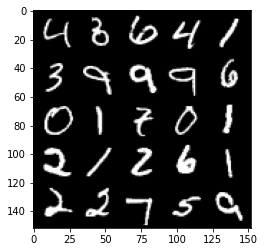

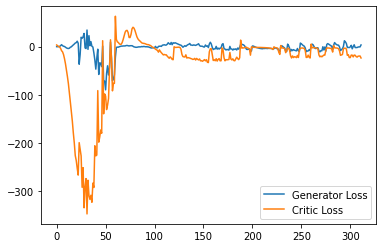

Step 6300: Generator loss: 15.563302745819092, critic loss: -2.682378123283387


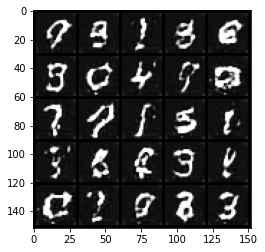

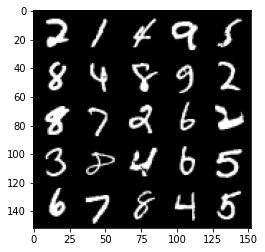

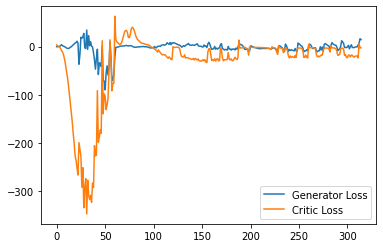

Step 6350: Generator loss: 11.11261417388916, critic loss: -2.721037509441375


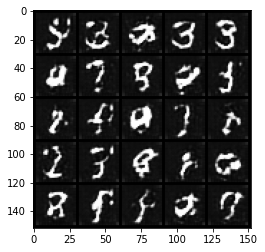

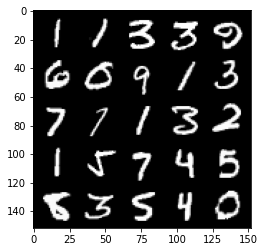

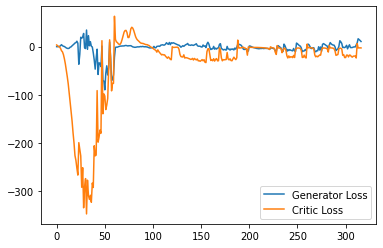

Step 6400: Generator loss: 8.3850035572052, critic loss: -3.4545346326828006


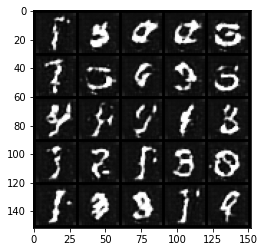

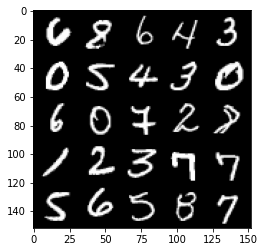

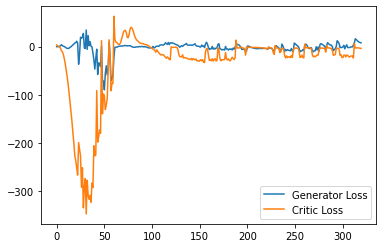

Step 6450: Generator loss: 4.900600700378418, critic loss: -0.2427308912277233


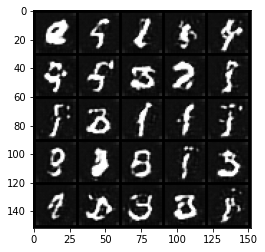

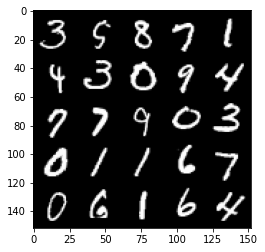

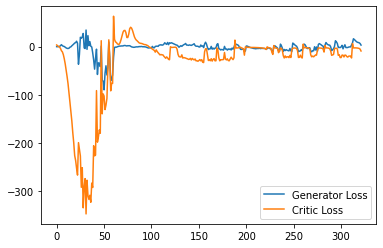

Step 6500: Generator loss: 12.133449974060058, critic loss: -2.4324425969123835


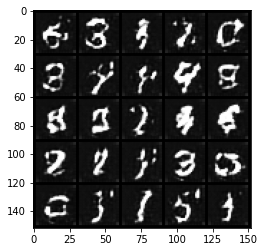

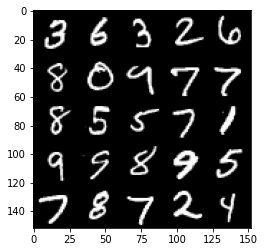

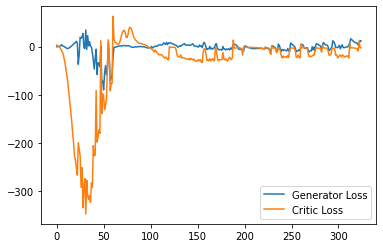

Step 6550: Generator loss: 9.042960052490235, critic loss: -2.8706314001083375


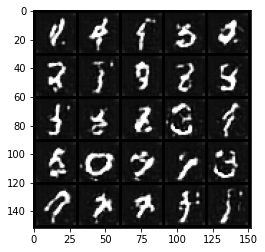

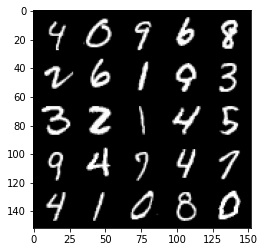

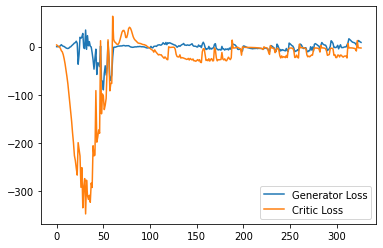

Step 6600: Generator loss: 7.83085262298584, critic loss: -3.6438945674896233


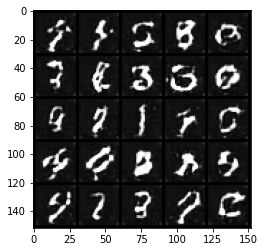

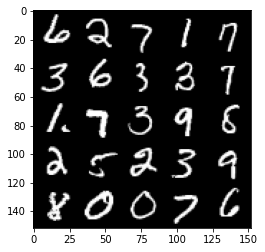

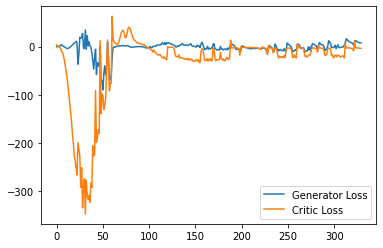

Step 6650: Generator loss: 7.727480564117432, critic loss: -5.679296465873718


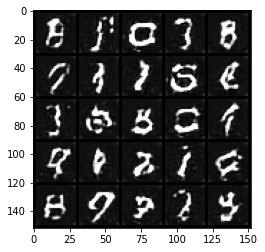

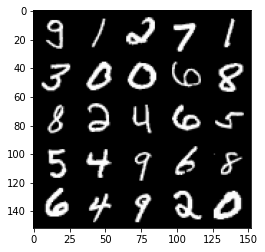

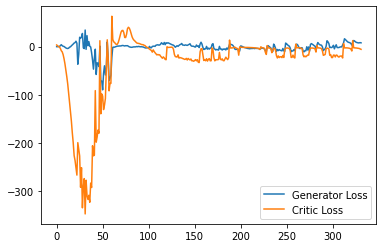

Step 6700: Generator loss: 3.6598639667034147, critic loss: -15.550645829200747


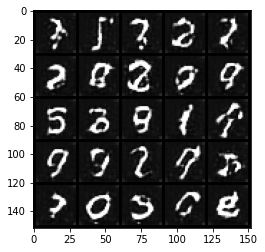

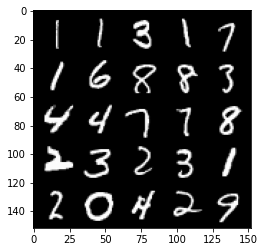

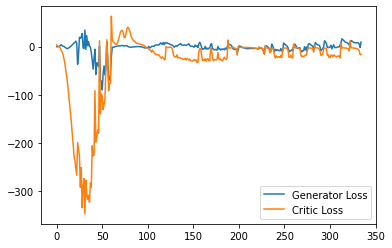

Step 6750: Generator loss: 9.13321848154068, critic loss: -6.094040376663209


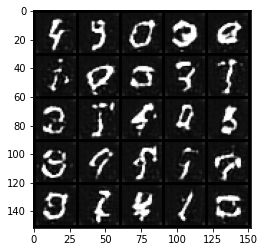

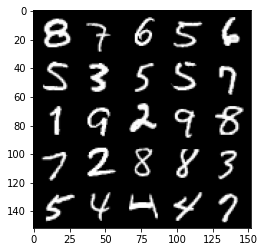

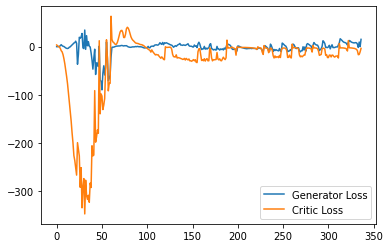

Step 6800: Generator loss: 6.115642536878585, critic loss: -11.688436423540118


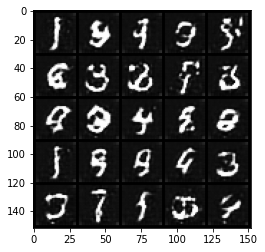

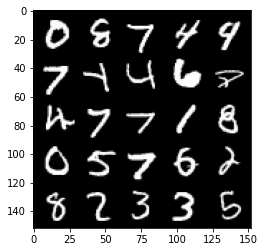

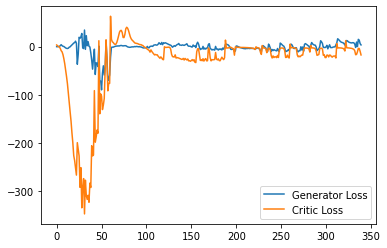

Step 6850: Generator loss: 6.4341167449951175, critic loss: -17.116458075046538


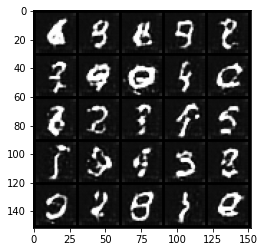

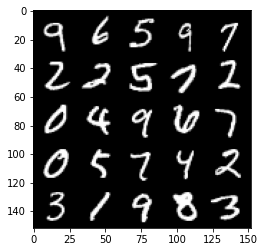

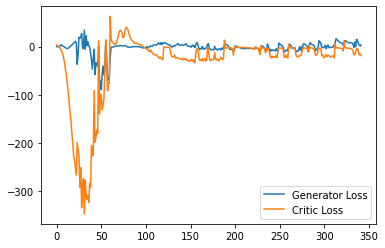

Step 6900: Generator loss: 1.6355089747905731, critic loss: -20.218704387426378


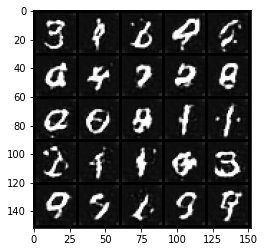

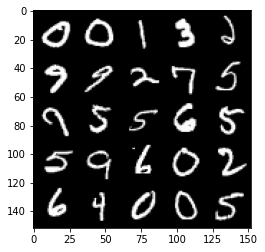

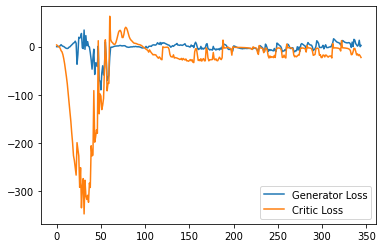

Step 6950: Generator loss: 16.083695908784865, critic loss: -0.5150757064819345


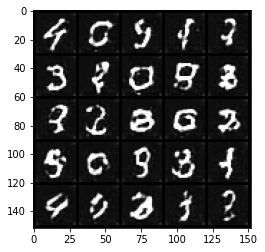

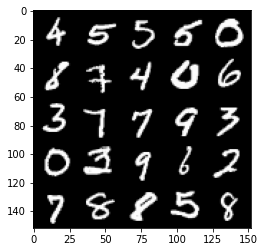

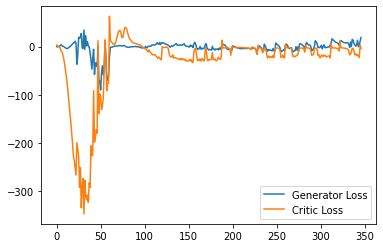

Step 7000: Generator loss: 10.403337175846099, critic loss: -8.70471689462662


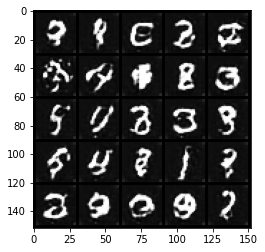

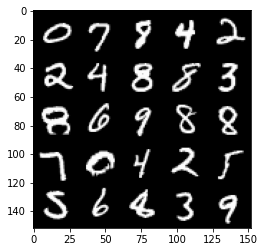

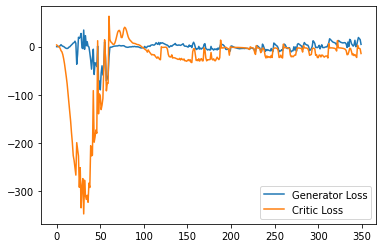

Step 7050: Generator loss: 5.930377380251884, critic loss: -13.31076799201965


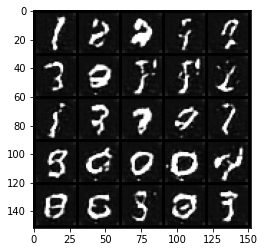

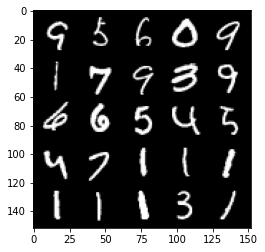

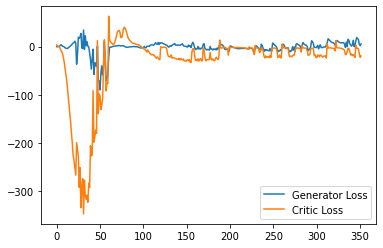

Step 7100: Generator loss: 12.862074851989746, critic loss: -12.767218006849287


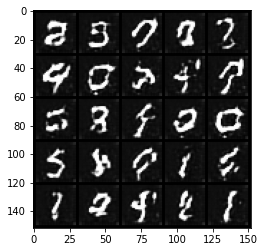

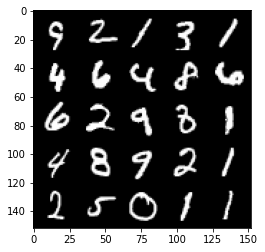

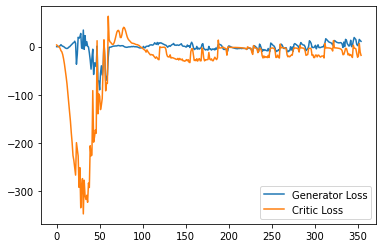

Step 7150: Generator loss: 6.13918880790472, critic loss: -18.931614973545074


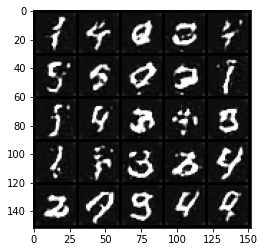

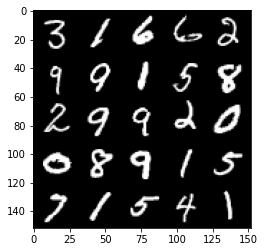

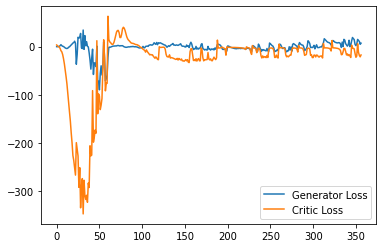

Step 7200: Generator loss: 10.58305860877037, critic loss: -17.480912276744846


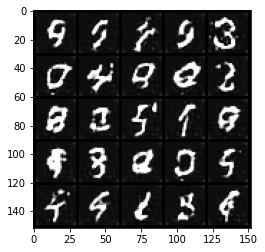

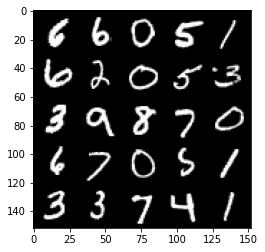

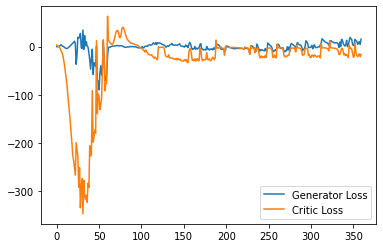

Step 7250: Generator loss: 10.901371522843839, critic loss: -18.19981884717941


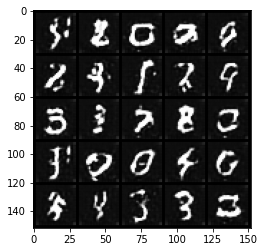

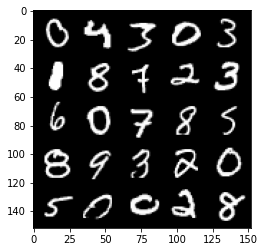

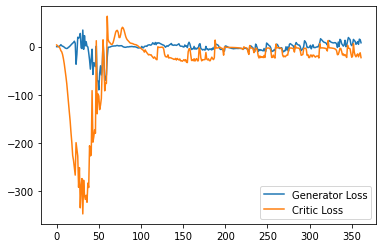

Step 7300: Generator loss: 11.555446258187294, critic loss: -15.744325133800503


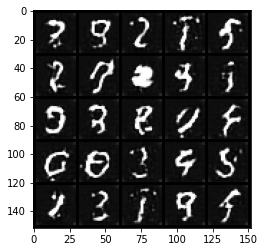

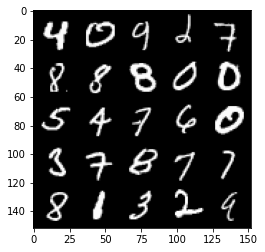

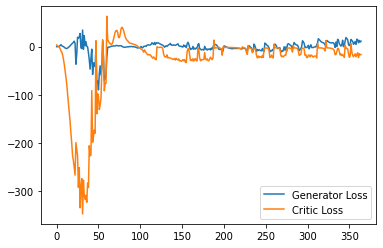

Step 7350: Generator loss: 11.493509251773357, critic loss: -2.36922053527832


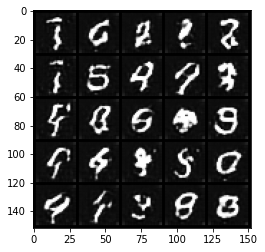

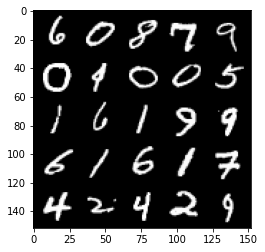

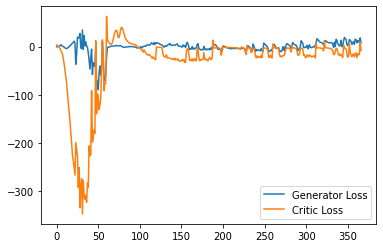

Step 7400: Generator loss: 7.712429246902466, critic loss: -15.129471086978908


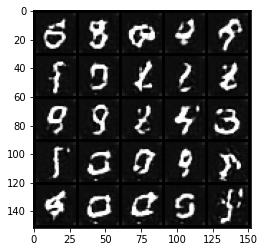

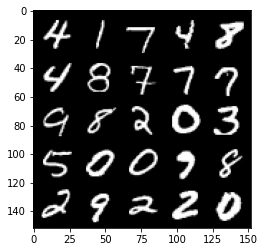

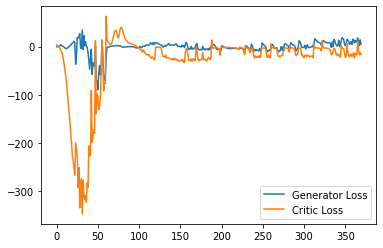

Step 7450: Generator loss: 14.054492094516753, critic loss: -15.557197436332698


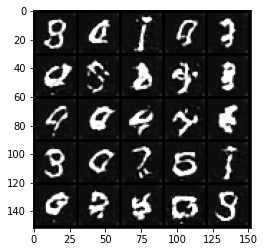

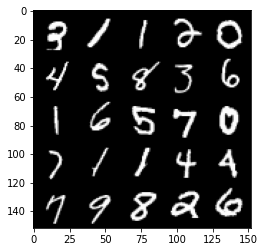

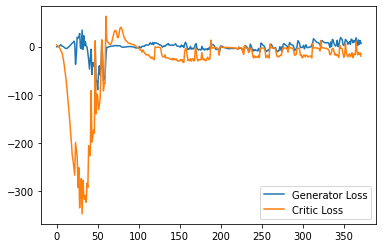

Step 7500: Generator loss: 8.29627049252391, critic loss: -14.07228735113144


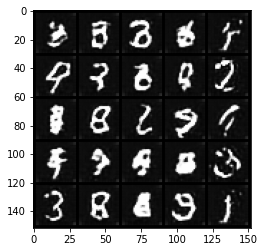

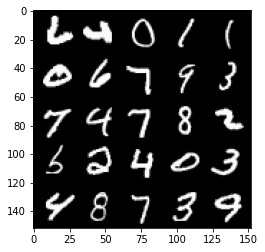

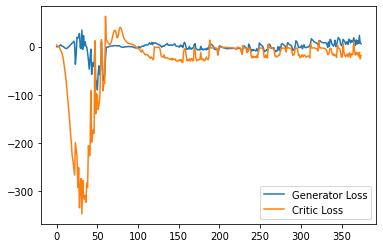

Step 7550: Generator loss: 17.089870971441268, critic loss: -7.5883782677650435


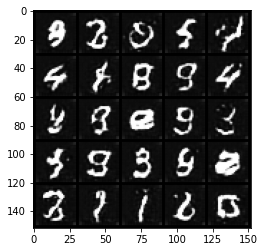

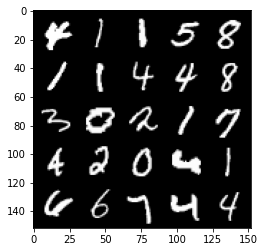

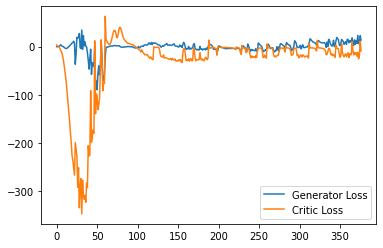

Step 7600: Generator loss: 9.39636639893055, critic loss: -14.911769063949583


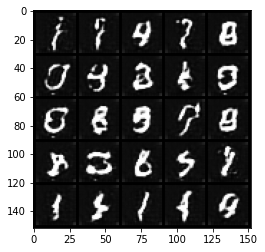

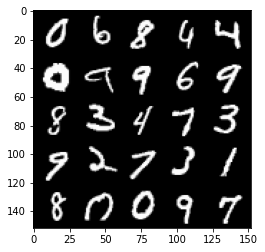

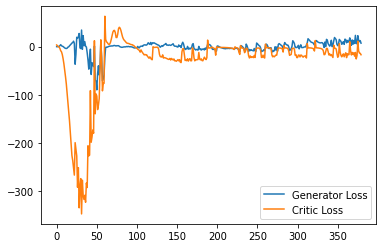

Step 7650: Generator loss: 22.357685774564743, critic loss: -6.254386925220488


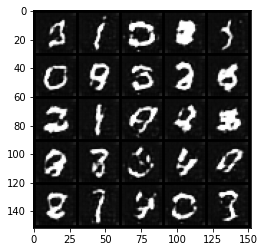

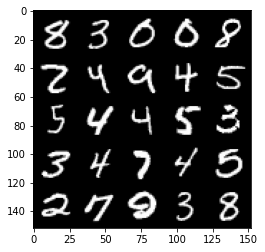

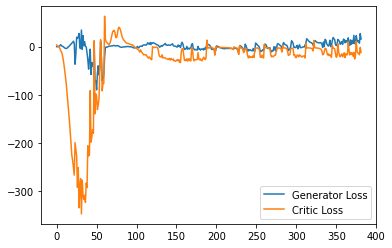

Step 7700: Generator loss: 12.036259907484055, critic loss: -14.330008967161179


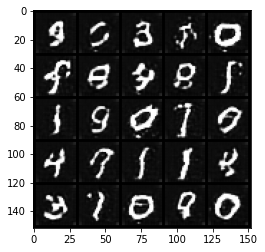

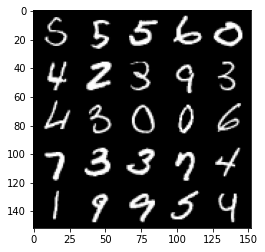

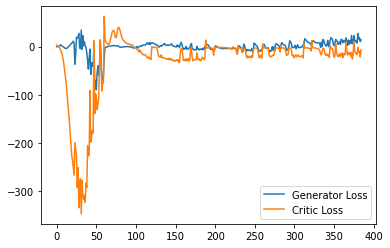

Step 7750: Generator loss: 15.94523343205452, critic loss: -12.83528545856476


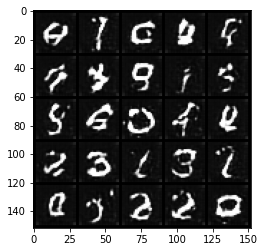

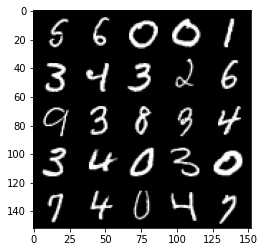

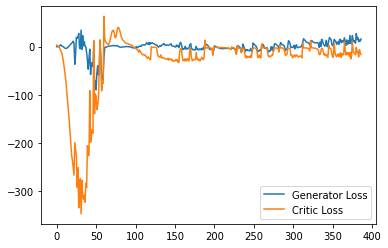

Step 7800: Generator loss: 12.231589047908782, critic loss: -16.429056853771208


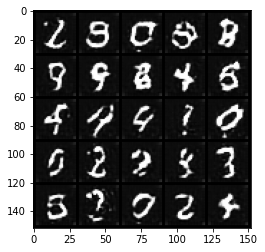

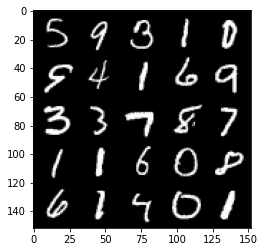

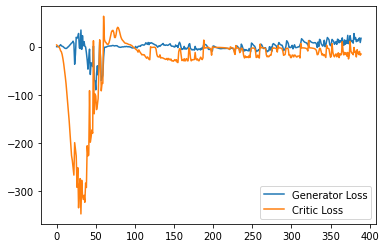

Step 7850: Generator loss: 12.427933447360992, critic loss: -17.71117556142807


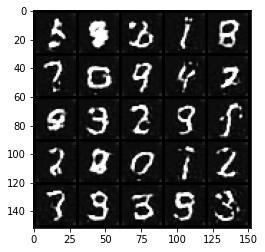

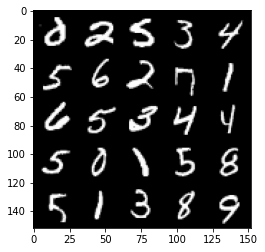

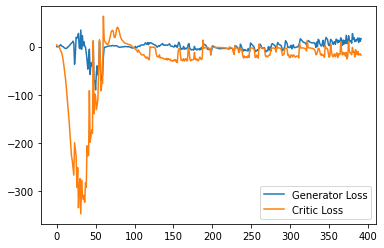

Step 7900: Generator loss: 17.265816631019117, critic loss: -14.031823150157923


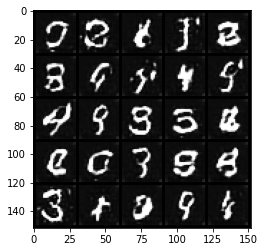

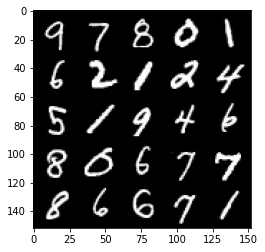

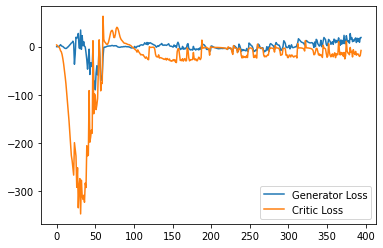

Step 7950: Generator loss: 13.527538020014763, critic loss: -13.389890552997592


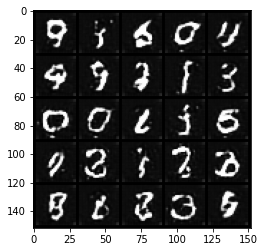

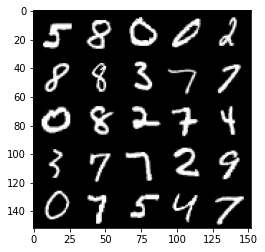

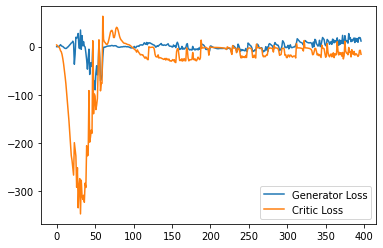

Step 8000: Generator loss: 18.712205419540407, critic loss: -10.358163347005847


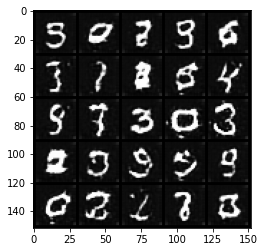

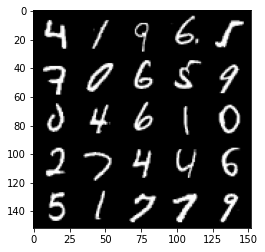

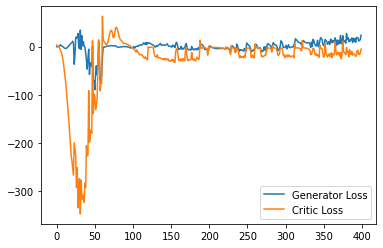

Step 8050: Generator loss: 18.433199011981486, critic loss: -3.5575702428817726


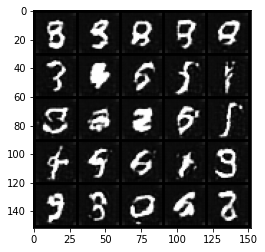

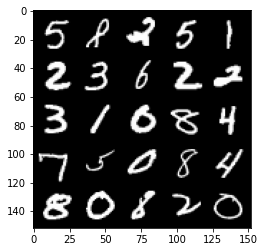

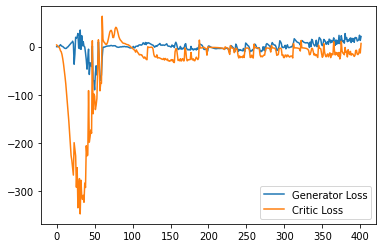

Step 8100: Generator loss: 13.480982093811035, critic loss: -11.603839490413666


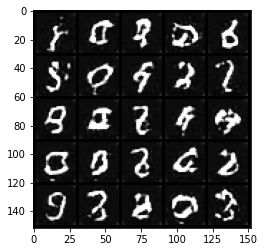

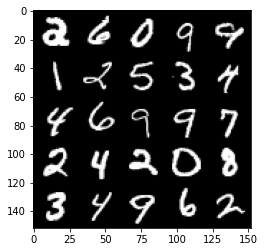

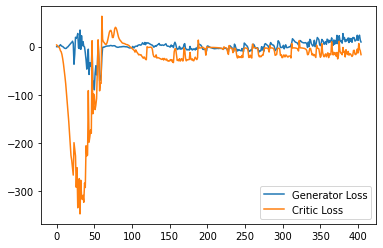

Step 8150: Generator loss: 18.312198181152343, critic loss: -13.261419488191606


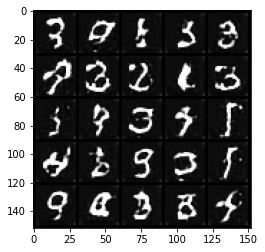

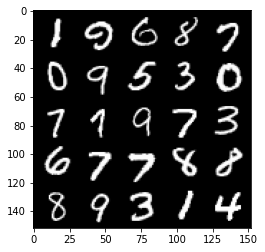

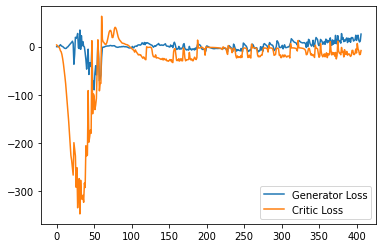

Step 8200: Generator loss: 14.644154585003854, critic loss: -14.339406874895099


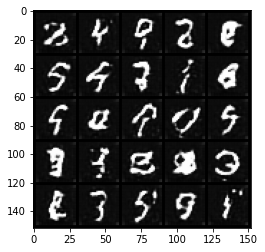

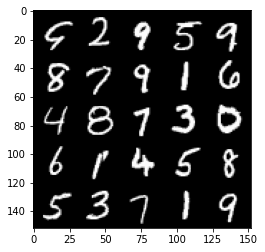

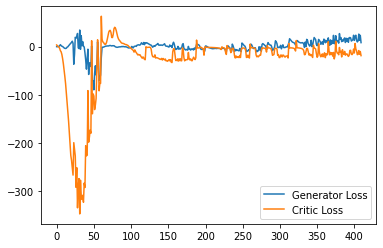

Step 8250: Generator loss: 16.045637807250024, critic loss: -16.115973896503444


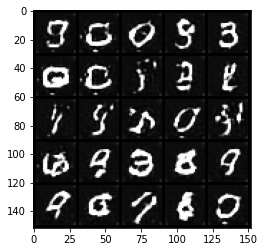

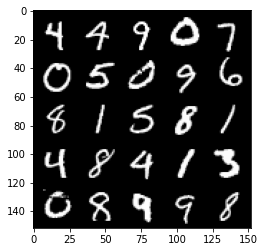

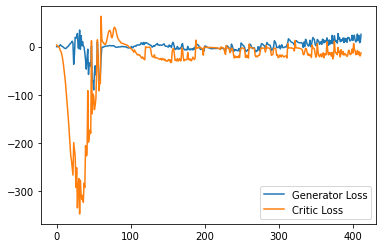

Step 8300: Generator loss: 17.13963055729866, critic loss: -15.893929286956784


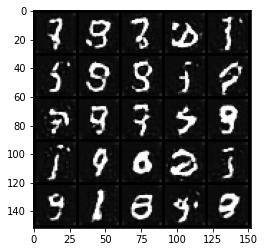

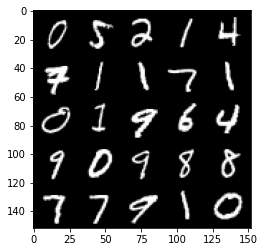

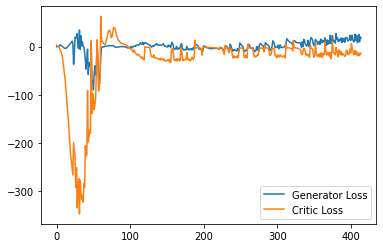

Step 8350: Generator loss: 17.80496607542038, critic loss: -15.036011789798739


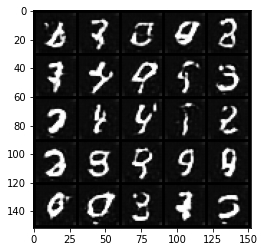

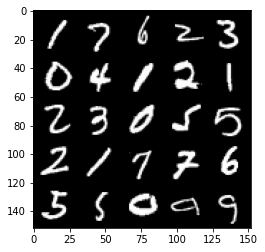

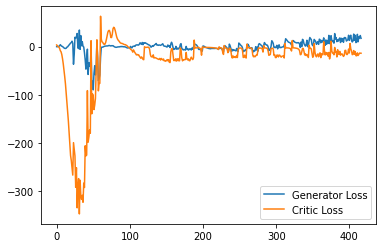

Step 8400: Generator loss: 20.10453218758106, critic loss: -5.64803874015808


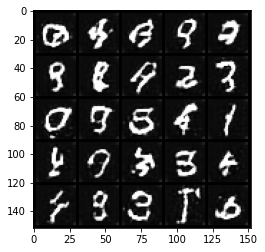

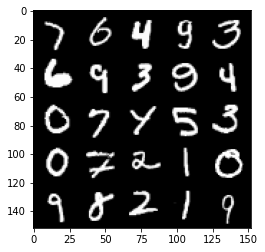

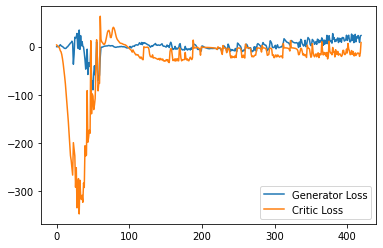

Step 8450: Generator loss: 20.5049521112442, critic loss: -6.536945820808412


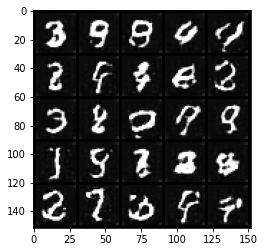

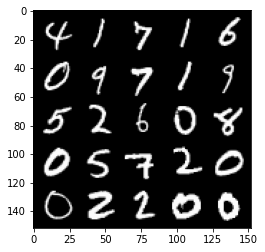

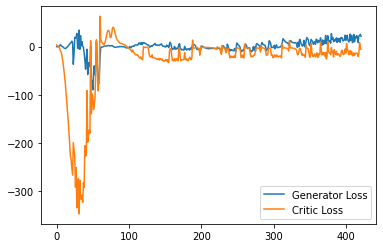

Step 8500: Generator loss: 16.454873567819597, critic loss: -15.36146953058243


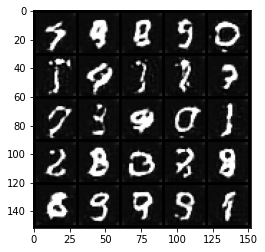

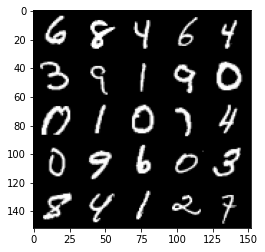

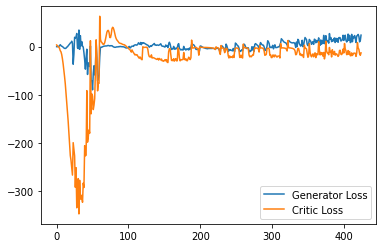

Step 8550: Generator loss: 14.665914351940154, critic loss: -10.6085583319664


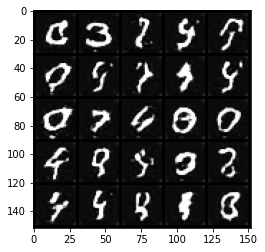

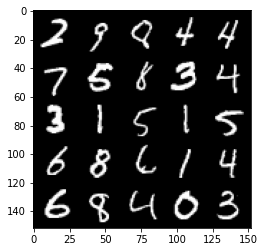

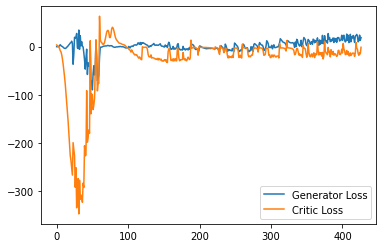

Step 8600: Generator loss: 20.795421297550202, critic loss: -12.21279624581337


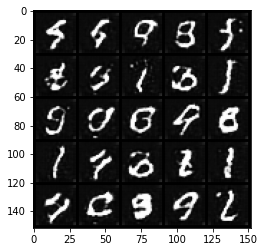

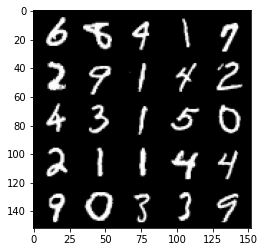

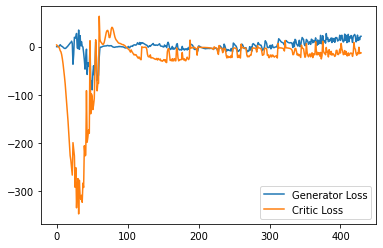

Step 8650: Generator loss: 19.775888948440553, critic loss: -15.733910174369816


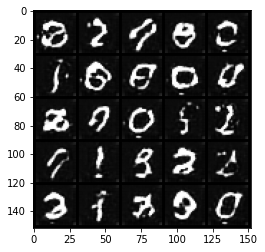

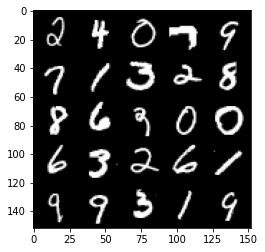

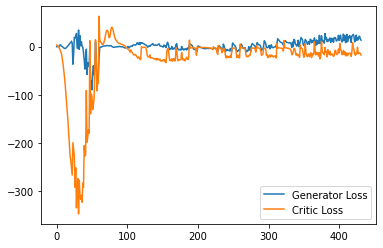

Step 8700: Generator loss: 15.037210859060288, critic loss: -17.42592177534103


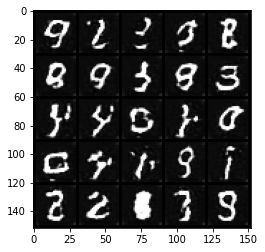

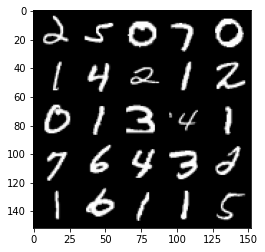

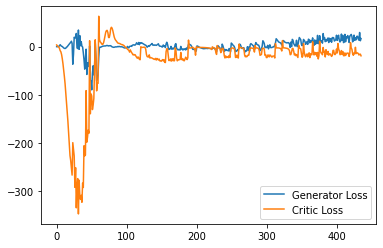

Step 8750: Generator loss: 16.90960726559162, critic loss: -17.79572891378403


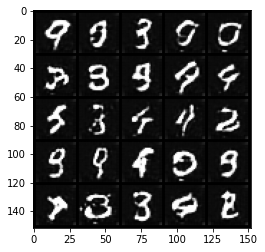

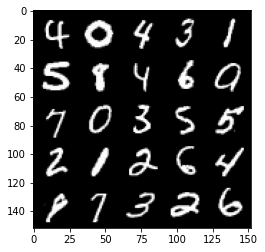

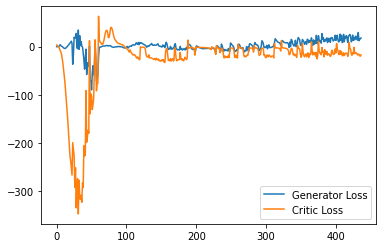

Step 8800: Generator loss: 18.18212914466858, critic loss: -11.826101114749907


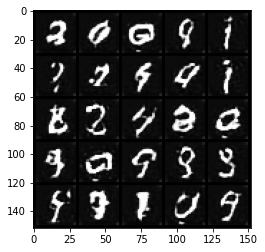

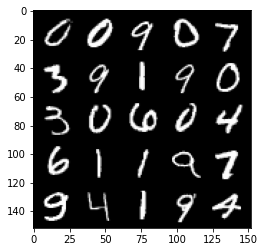

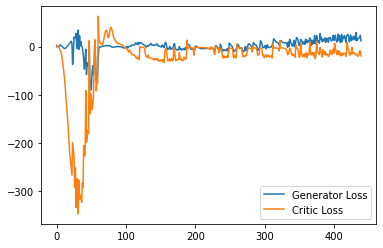

Step 8850: Generator loss: 13.654919879436493, critic loss: -18.23481776380539


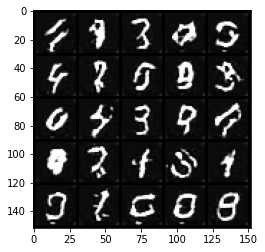

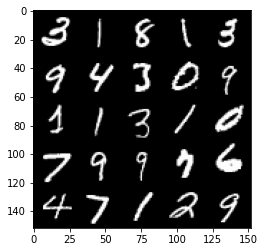

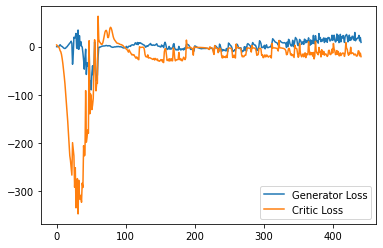

Step 8900: Generator loss: 27.49047985076904, critic loss: -2.125069468975067


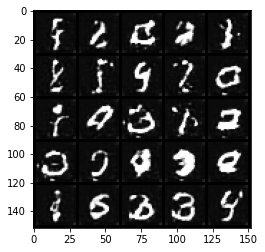

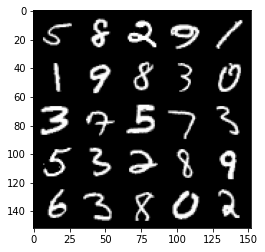

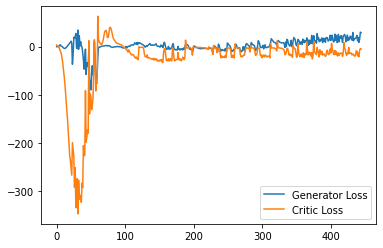

Step 8950: Generator loss: 24.82297055244446, critic loss: -14.395024712562565


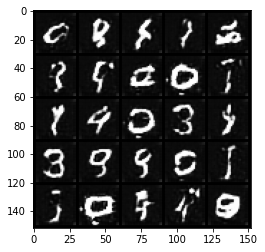

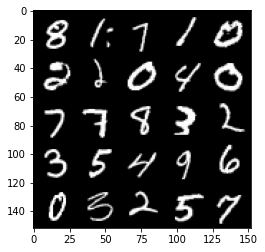

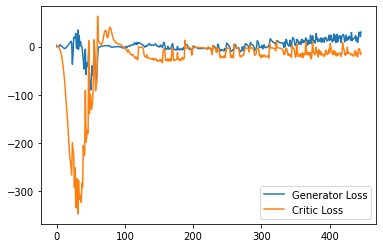

Step 9000: Generator loss: 14.778647830486298, critic loss: -16.041261007785796


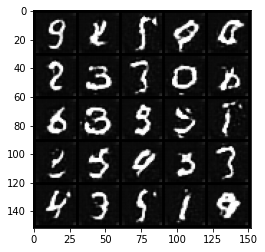

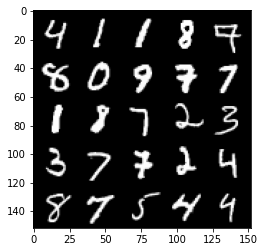

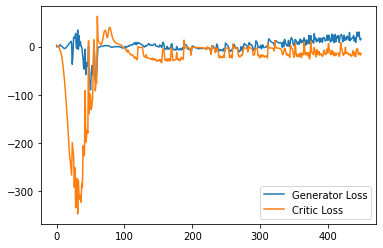

Step 9050: Generator loss: 21.846950283050536, critic loss: 0.808207952737809


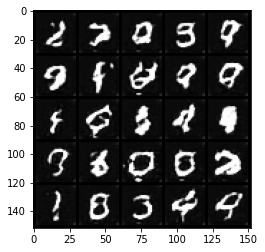

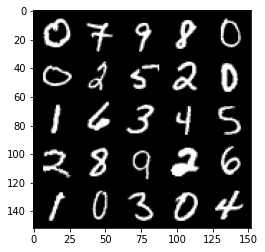

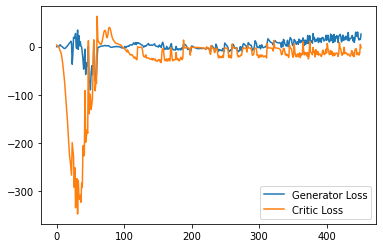

Step 9100: Generator loss: 24.894452171325682, critic loss: -2.989356746673584


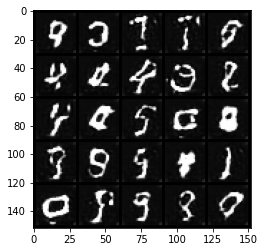

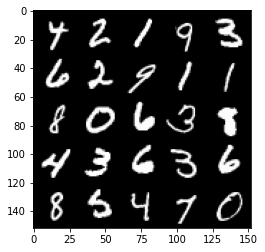

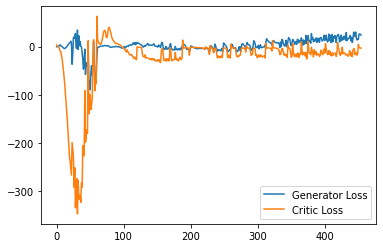

Step 9150: Generator loss: 21.65476333618164, critic loss: -3.9287352342605595


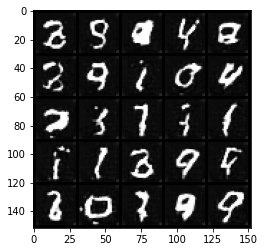

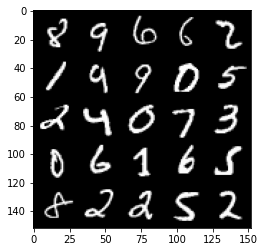

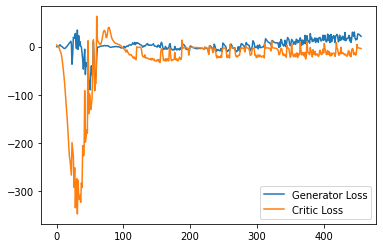

Step 9200: Generator loss: 19.65995677947998, critic loss: -6.65551866006851


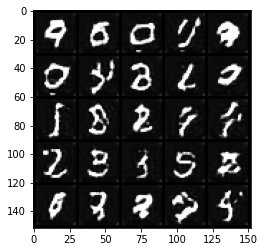

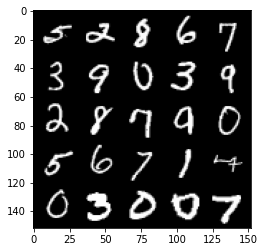

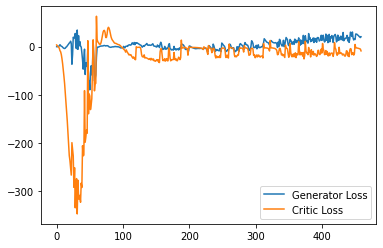

Step 9250: Generator loss: 20.494813828468324, critic loss: -13.105046581268311


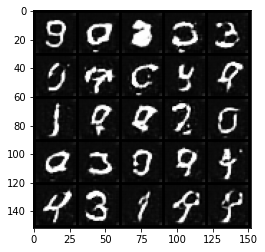

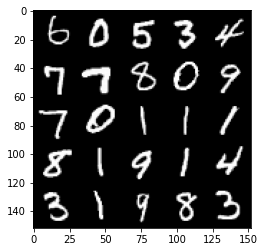

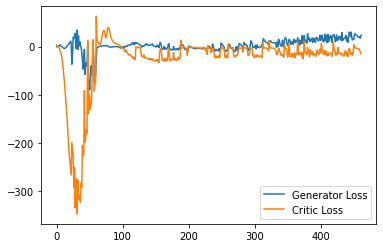

Step 9300: Generator loss: 24.324934825897216, critic loss: -5.125154230117798


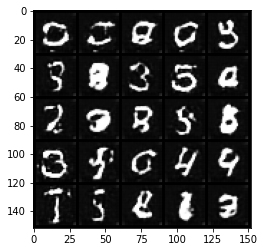

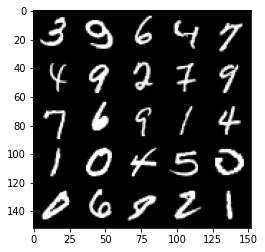

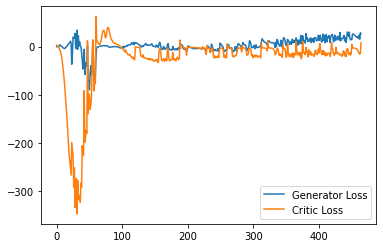

Step 9350: Generator loss: 16.75741404235363, critic loss: -14.15689715909958


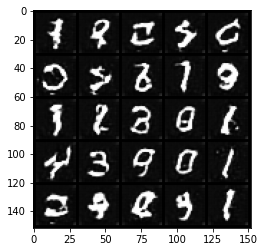

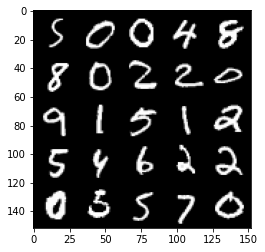

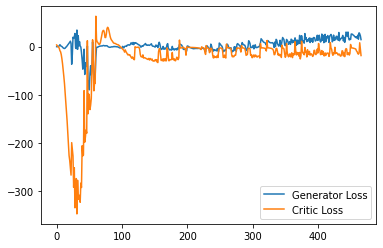

Step 9400: Generator loss: 22.334472414255142, critic loss: -12.16575051021576


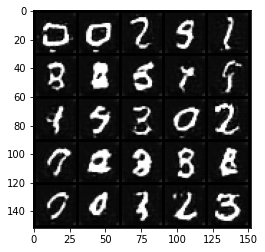

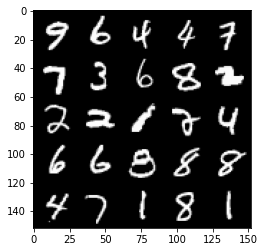

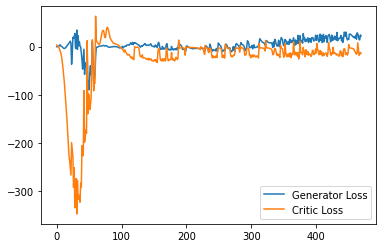

Step 9450: Generator loss: 18.829459935426712, critic loss: -11.529442934155462


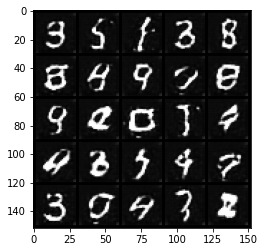

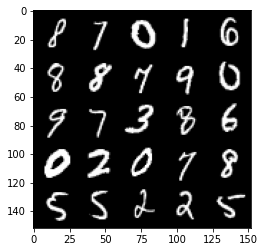

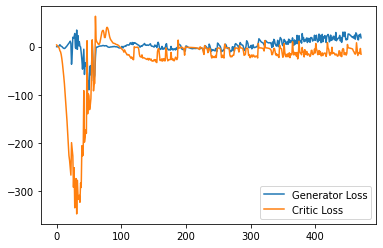

Step 9500: Generator loss: 23.013459997177122, critic loss: -15.803711276054385


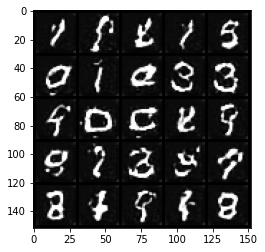

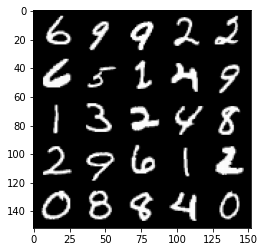

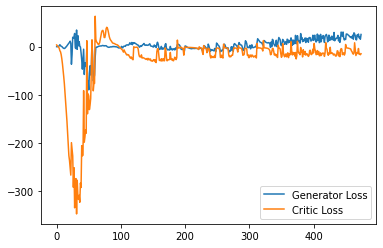

Step 9550: Generator loss: 17.02773631095886, critic loss: -15.553365887641911


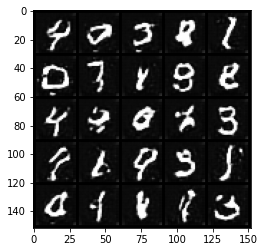

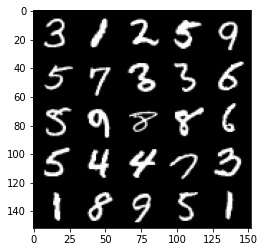

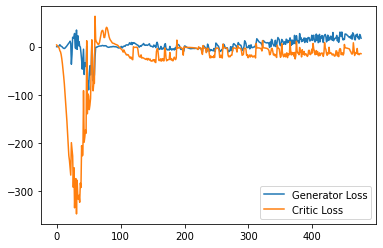

Step 9600: Generator loss: 24.173656101226808, critic loss: -8.486601462364195


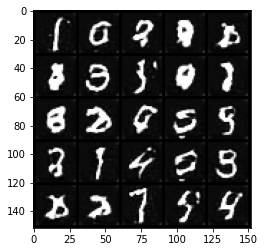

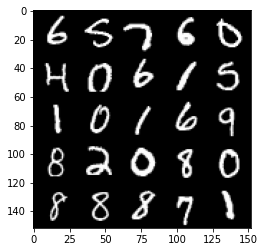

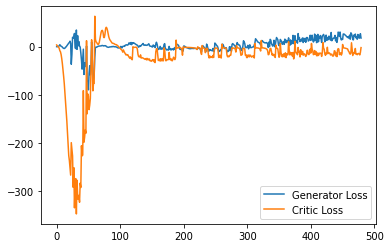

Step 9650: Generator loss: 16.397684932351112, critic loss: -16.44976896715164


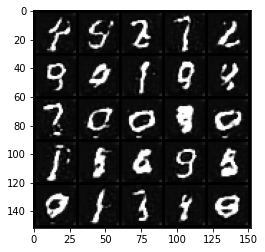

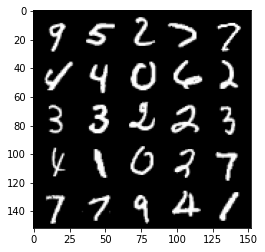

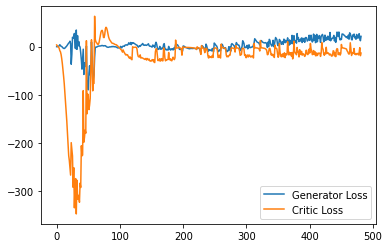

Step 9700: Generator loss: 22.858894643783568, critic loss: -10.787615346431732


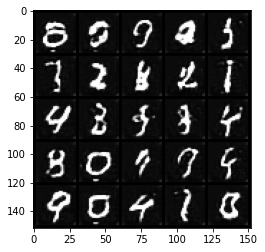

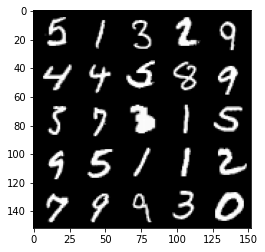

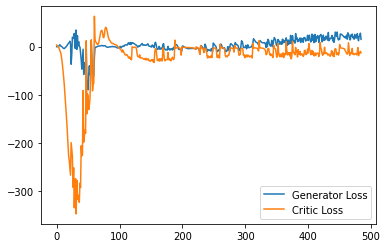

Step 9750: Generator loss: 18.42782018661499, critic loss: -17.921782183647156


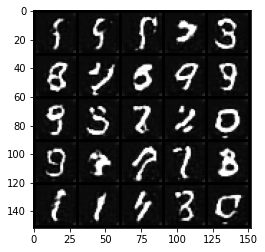

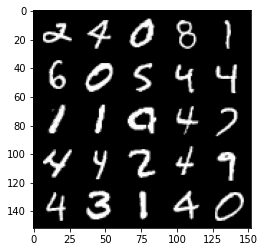

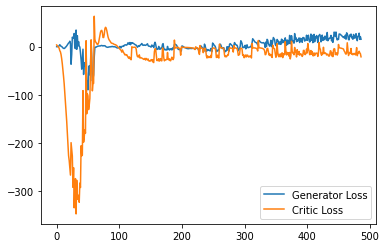

Step 9800: Generator loss: 24.05280041217804, critic loss: -13.823517366409305


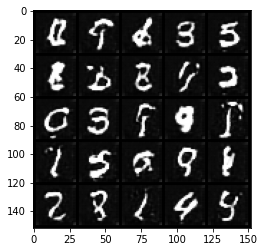

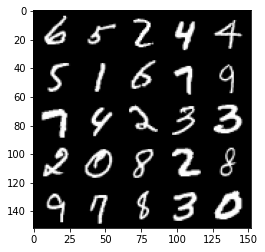

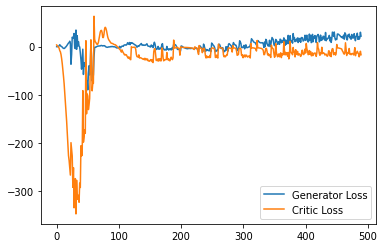

Step 9850: Generator loss: 14.167132334709168, critic loss: -19.62816851043701


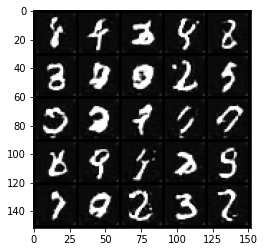

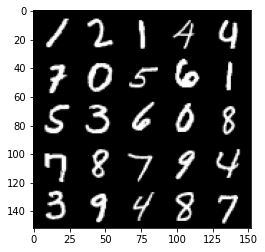

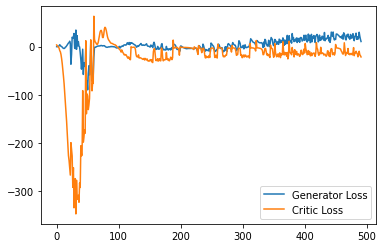

Step 9900: Generator loss: 25.196986088752748, critic loss: -13.802852742671966


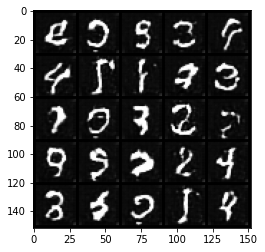

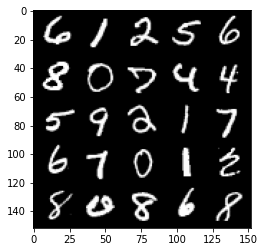

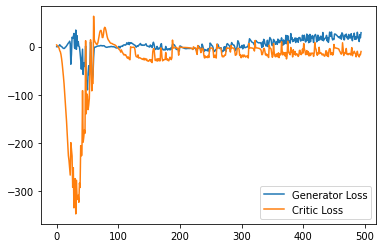

Step 9950: Generator loss: 19.961140441894532, critic loss: -37.05735101890565


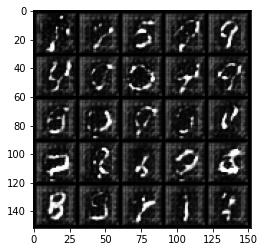

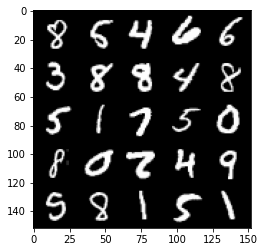

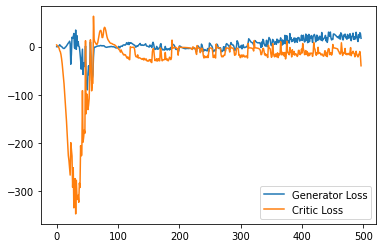

Step 10000: Generator loss: 5.820894355773926, critic loss: -78.97116849517825


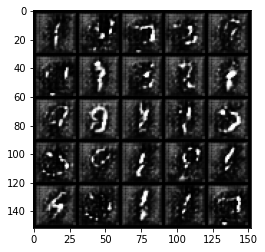

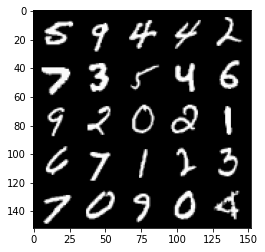

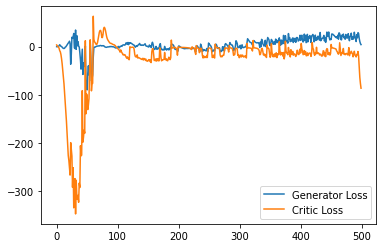

Step 10050: Generator loss: 0.44793155074119567, critic loss: -108.20932296752927


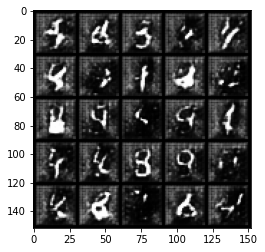

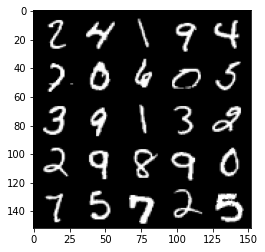

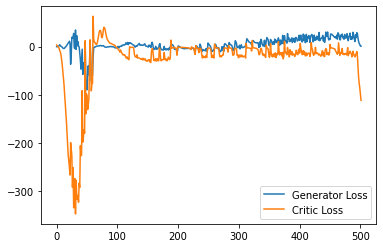

Step 10100: Generator loss: -2.9363981676101685, critic loss: -121.60893527221677


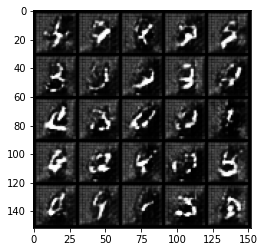

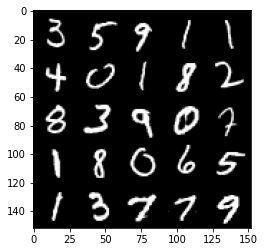

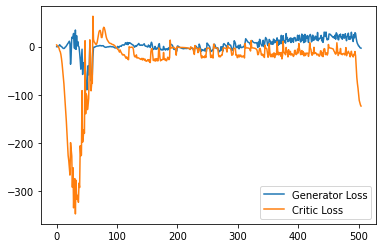

Step 10150: Generator loss: -3.2197849464416506, critic loss: -130.07510241699222


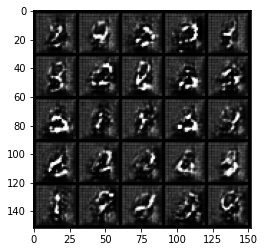

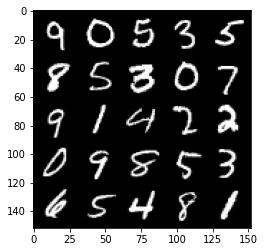

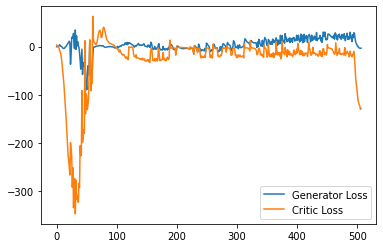

Step 10200: Generator loss: -1.4763554900884628, critic loss: -141.61657966613774


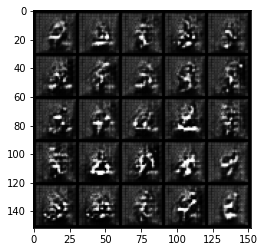

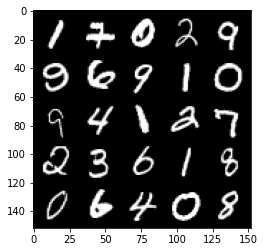

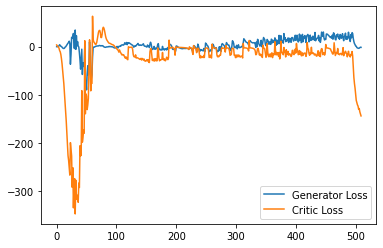

Step 10250: Generator loss: -1.8101575568318367, critic loss: -162.03748904418947


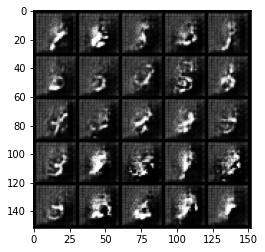

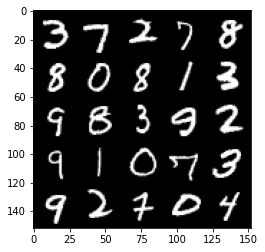

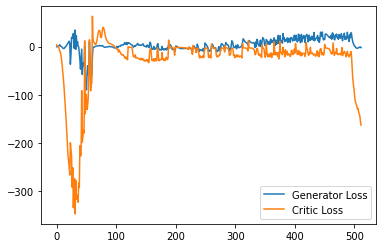

Step 10300: Generator loss: -3.347440452575684, critic loss: -185.2082359008789


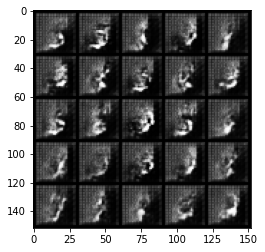

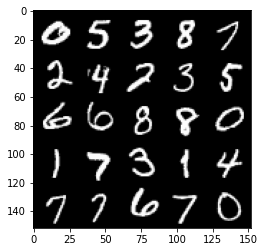

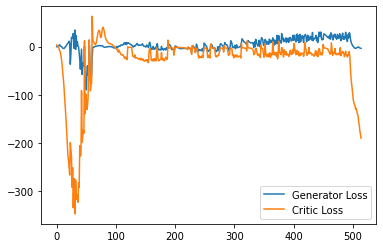

Step 10350: Generator loss: -4.810625219345093, critic loss: -203.08612530517584


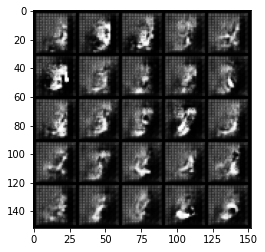

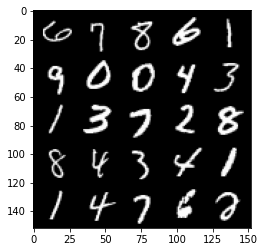

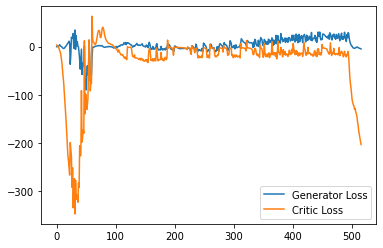

Step 10400: Generator loss: -8.316979770660401, critic loss: -221.81745190429686


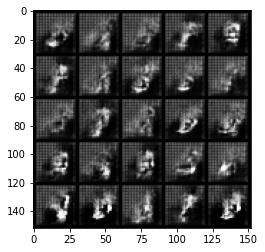

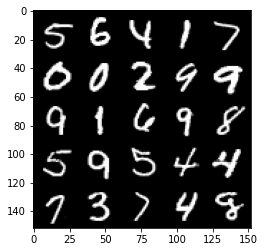

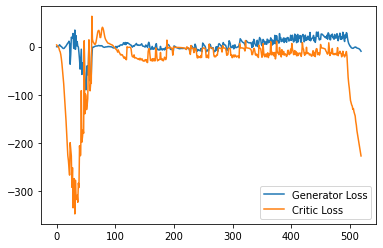

Step 10450: Generator loss: -15.766865634918213, critic loss: -230.5194649047852


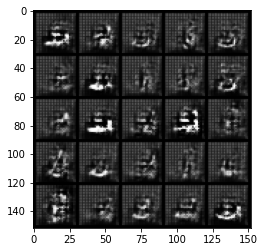

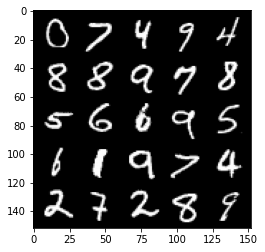

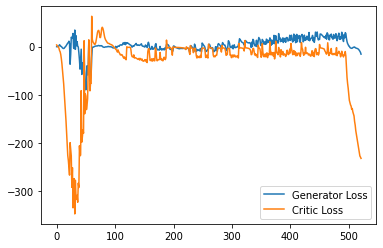

Step 10500: Generator loss: -24.581263847351075, critic loss: -235.14449267578127


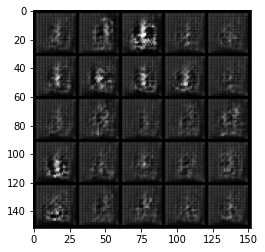

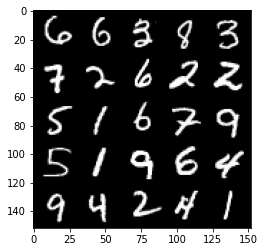

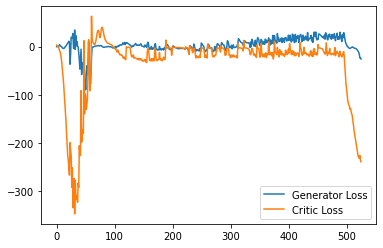

Step 10550: Generator loss: -31.06218029022217, critic loss: -236.1682882080078


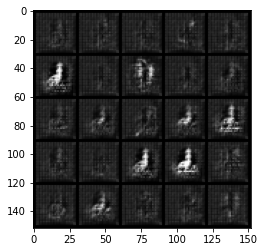

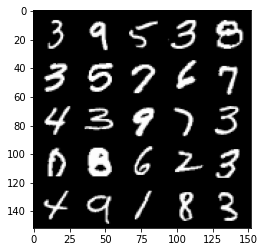

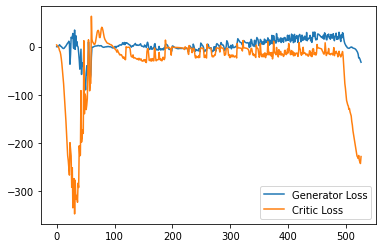

Step 10600: Generator loss: -35.142735137939454, critic loss: -253.30660638427742


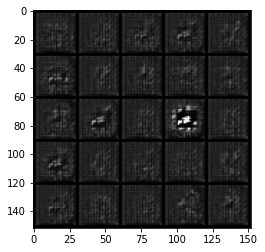

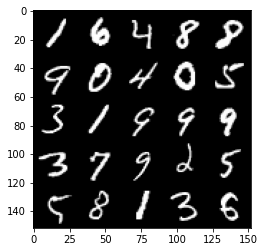

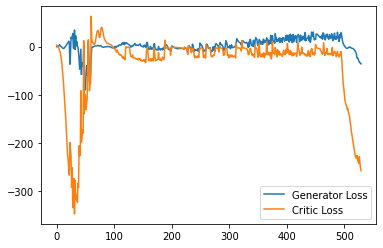

Step 10650: Generator loss: -37.709223709106446, critic loss: -271.04165667724607


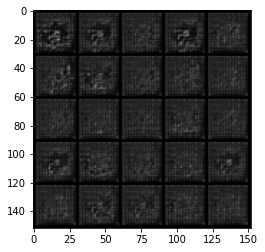

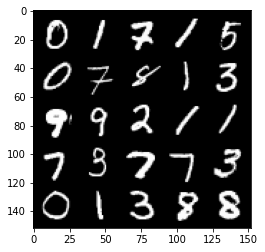

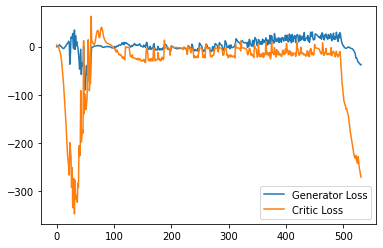

Step 10700: Generator loss: -37.18375221252441, critic loss: -279.65352819824216


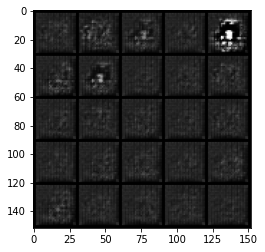

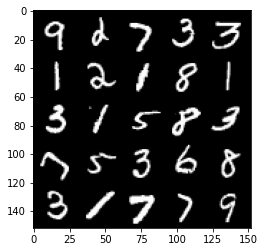

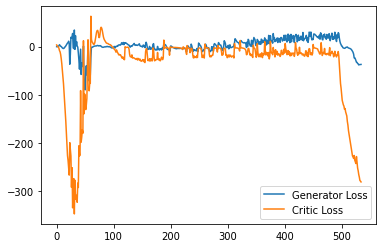

Step 10750: Generator loss: -37.452275085449216, critic loss: -281.5188098144532


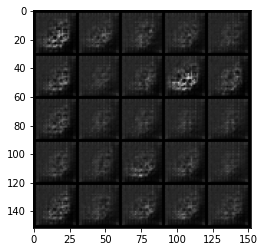

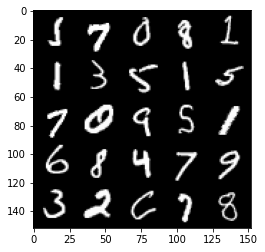

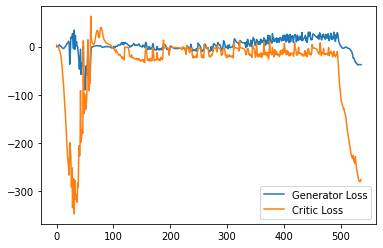

Step 10800: Generator loss: -37.86699363708496, critic loss: -303.40237078857416


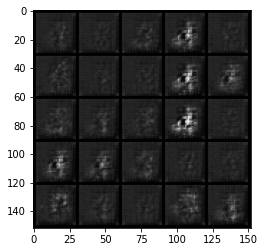

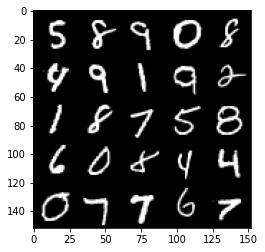

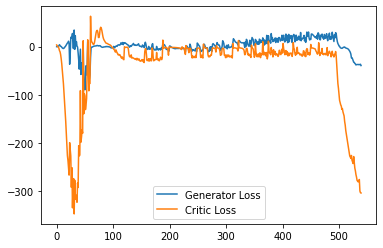

Step 10850: Generator loss: -38.20192687988281, critic loss: -301.71654534912113


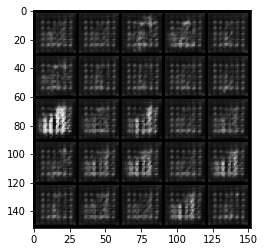

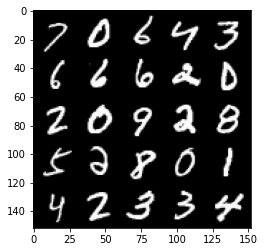

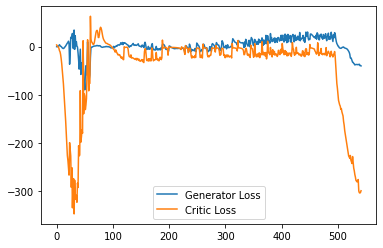

Step 10900: Generator loss: -32.48513339996338, critic loss: -203.34935453796382


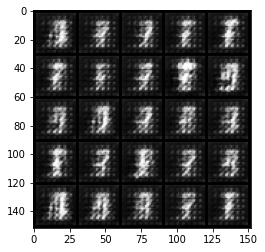

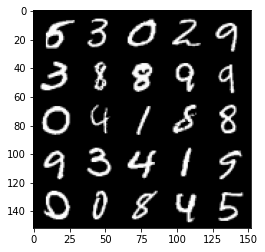

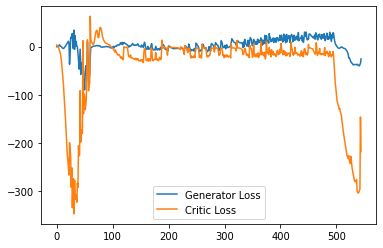

Step 10950: Generator loss: -31.533732261657715, critic loss: -324.74866845703116


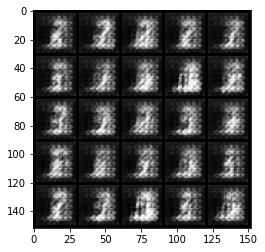

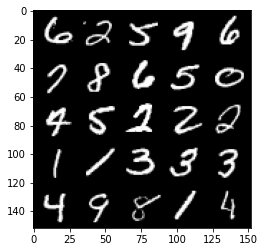

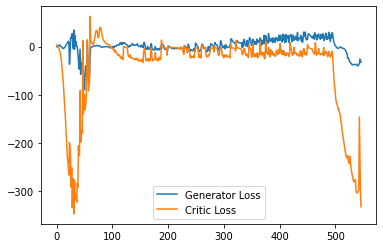

Step 11000: Generator loss: -33.74892822265625, critic loss: -368.18842126464847


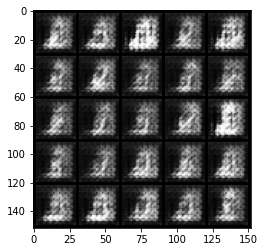

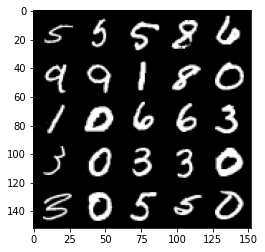

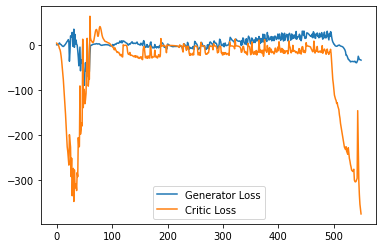

Step 11050: Generator loss: -35.14055976867676, critic loss: -392.5673354492187


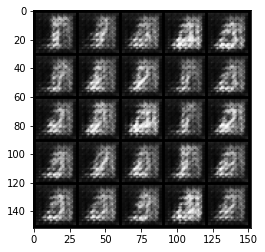

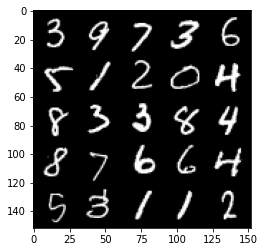

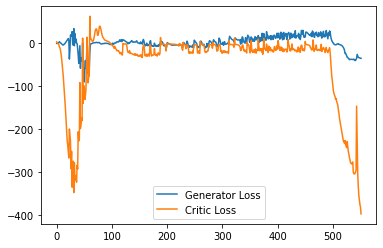

Step 11100: Generator loss: -39.009714431762696, critic loss: -406.1212807617188


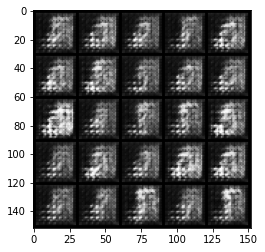

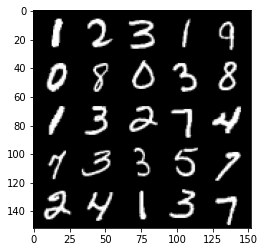

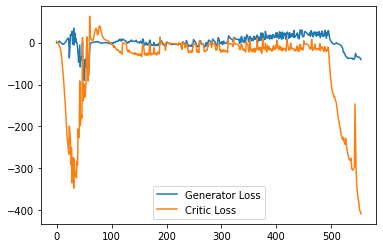

Step 11150: Generator loss: -42.8569603729248, critic loss: -424.28427111816404


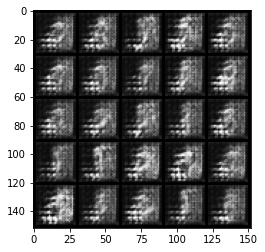

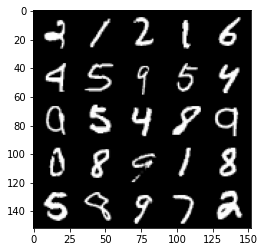

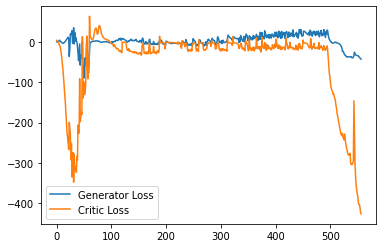

Step 11200: Generator loss: -45.84075080871582, critic loss: -450.46000842285144


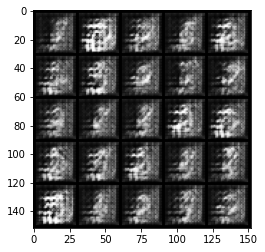

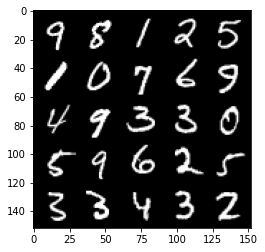

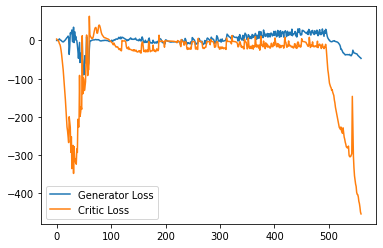

Step 11250: Generator loss: -50.18072998046875, critic loss: -467.40257470703114


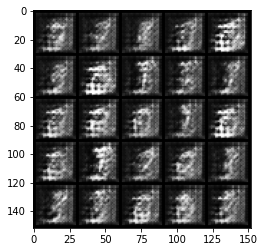

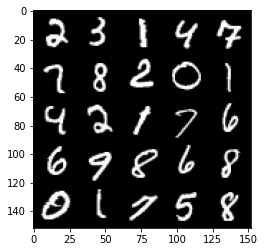

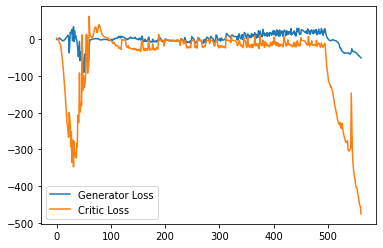

Step 11300: Generator loss: -51.84218963623047, critic loss: -488.93795166015616


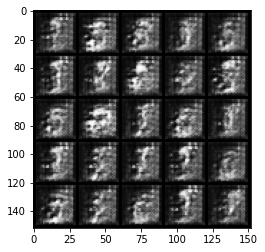

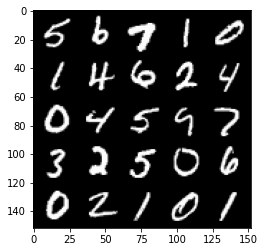

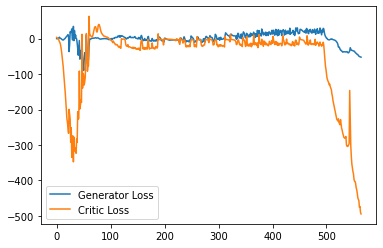

Step 11350: Generator loss: -51.523119888305665, critic loss: -509.8966564941407


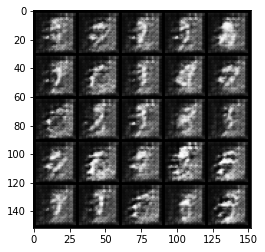

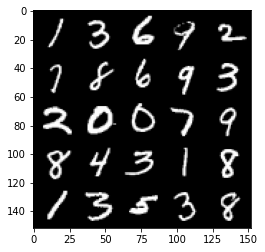

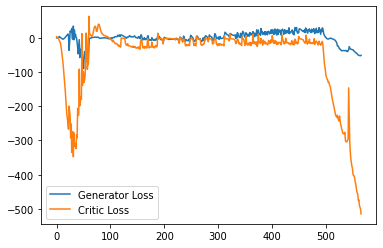

Step 11400: Generator loss: -50.126098709106444, critic loss: -538.8444241943358


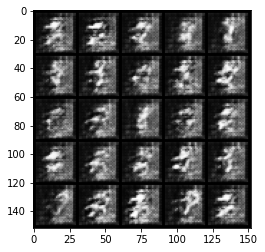

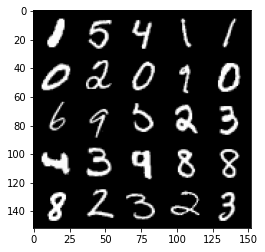

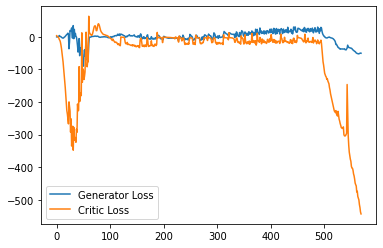

Step 11450: Generator loss: -50.28723091125488, critic loss: -554.7494329833986


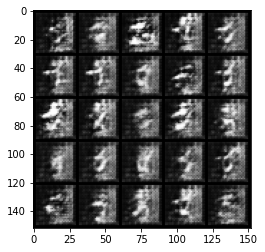

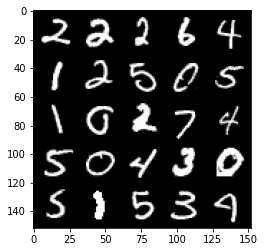

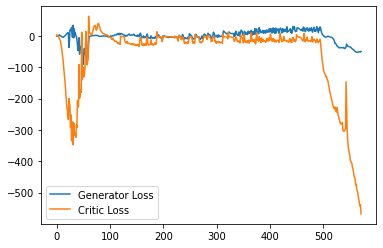

Step 11500: Generator loss: -51.85524032592773, critic loss: -578.1957952880861


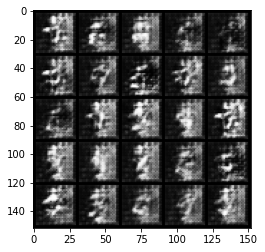

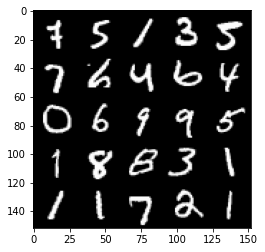

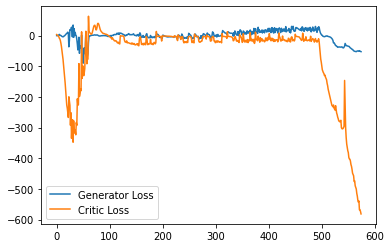

Step 11550: Generator loss: -58.77464012145996, critic loss: -575.6743709716799


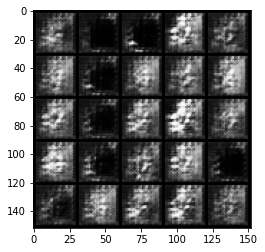

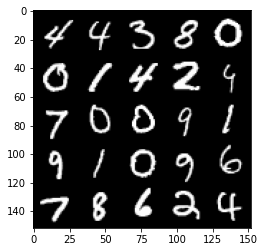

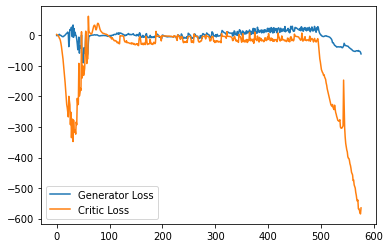

Step 11600: Generator loss: -62.563231506347655, critic loss: -590.9777601318359


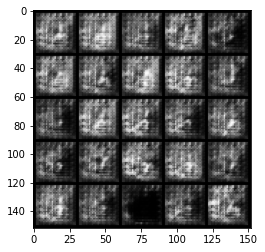

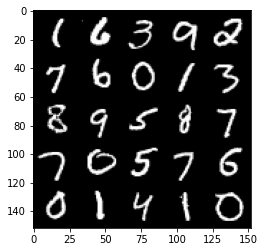

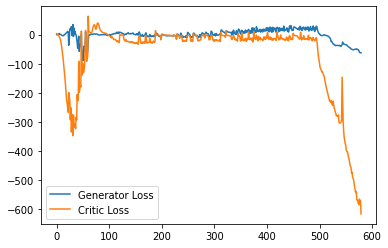

Step 11650: Generator loss: -60.36866516113281, critic loss: -634.3437983398437


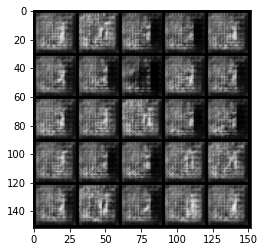

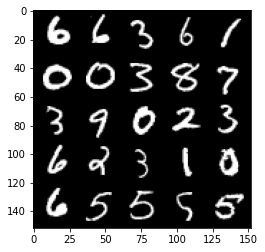

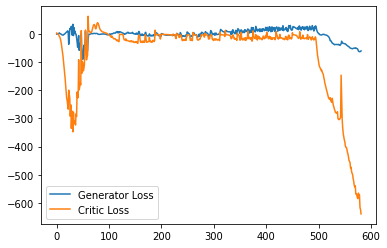

Step 11700: Generator loss: -54.85381477355957, critic loss: -649.779693359375


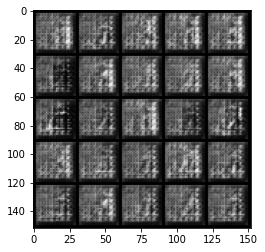

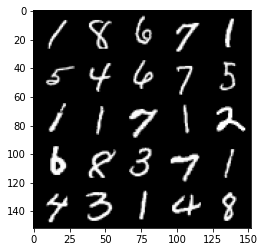

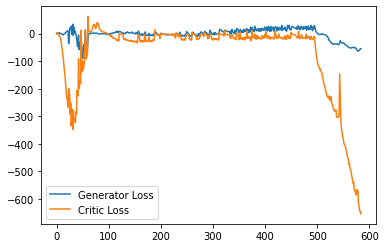

Step 11750: Generator loss: -50.89044292449951, critic loss: -340.598062286377


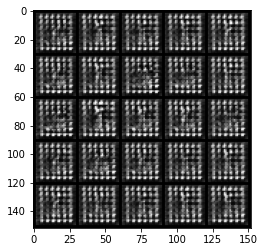

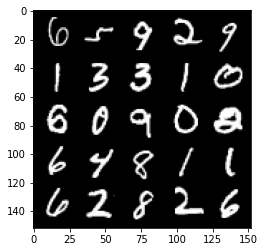

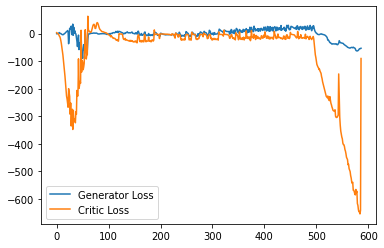

Step 11800: Generator loss: -54.03510601043701, critic loss: -128.38696179199218


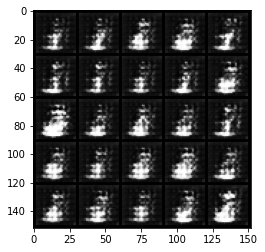

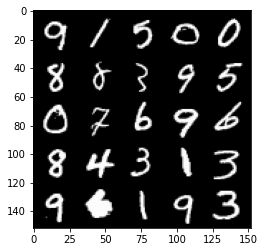

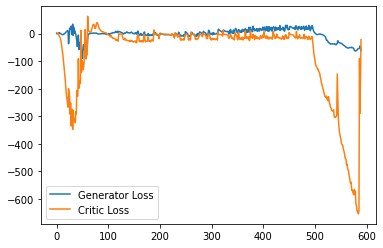

Step 11850: Generator loss: -45.225778121948245, critic loss: -377.44800128173824


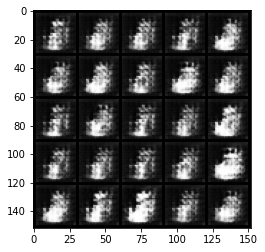

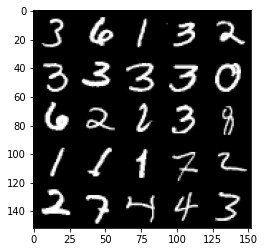

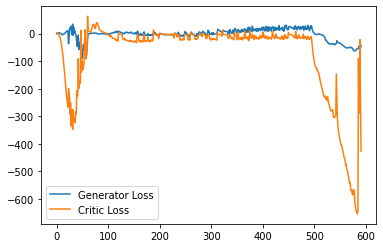

Step 11900: Generator loss: -47.721543350219726, critic loss: -573.7589584960939


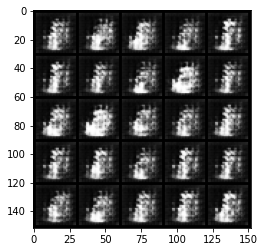

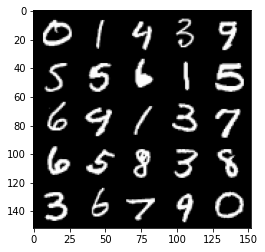

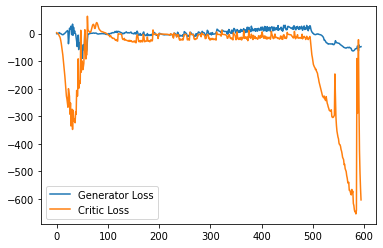

Step 11950: Generator loss: -44.086015167236326, critic loss: -620.050343017578


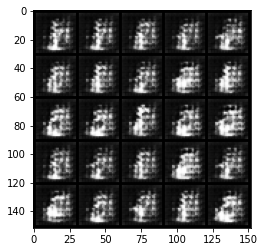

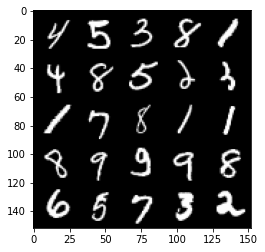

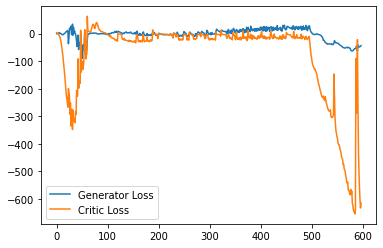

Step 12000: Generator loss: -42.54243415832519, critic loss: -606.4360311889646


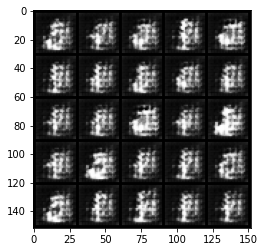

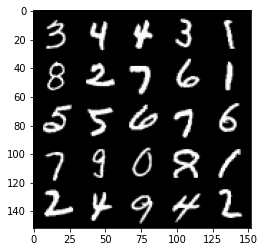

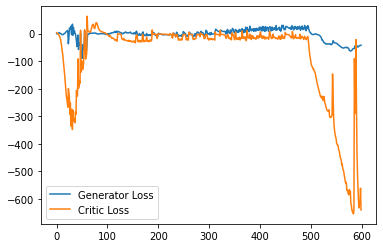

Step 12050: Generator loss: -40.46141090393066, critic loss: -637.0801810302736


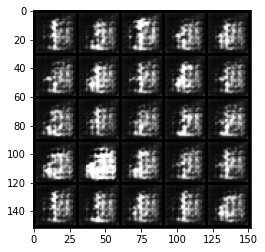

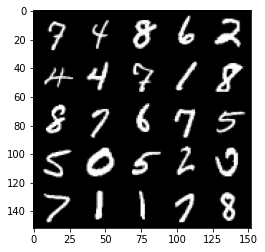

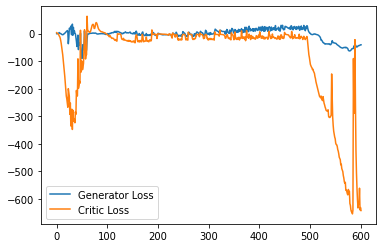

Step 12100: Generator loss: -39.478221054077146, critic loss: -664.6669442138673


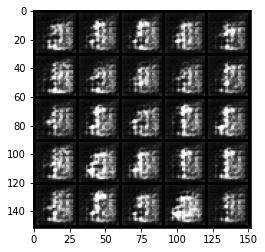

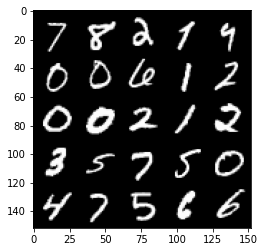

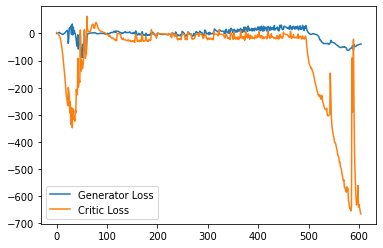

Step 12150: Generator loss: -39.048411254882815, critic loss: -678.9226029052733


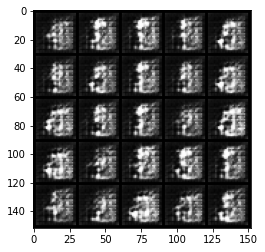

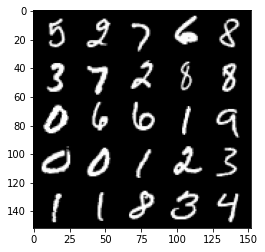

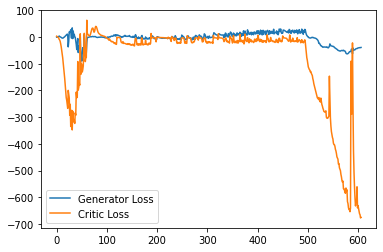

Step 12200: Generator loss: -37.94182090759277, critic loss: -691.0904141845704


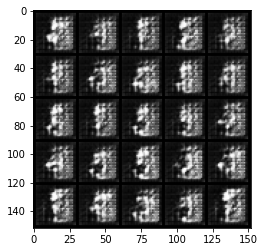

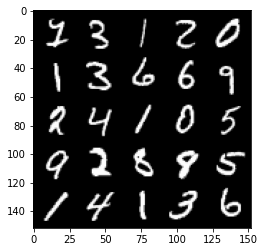

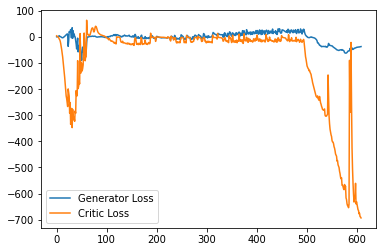

Step 12250: Generator loss: -36.073716201782226, critic loss: -704.6409482421878


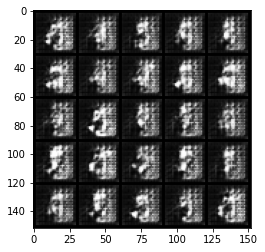

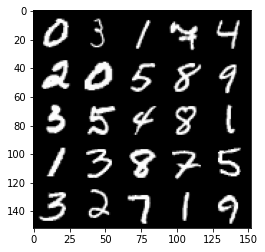

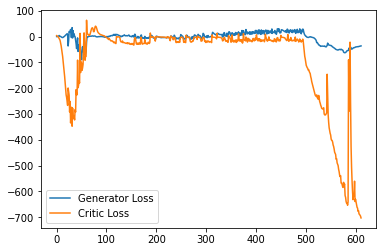

Step 12300: Generator loss: -32.94611797332764, critic loss: -720.2889442138669


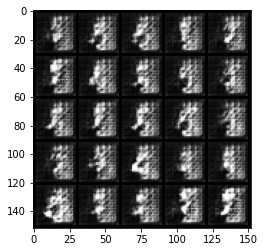

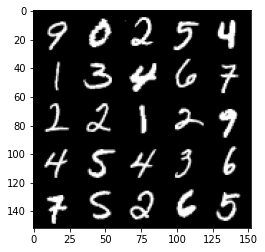

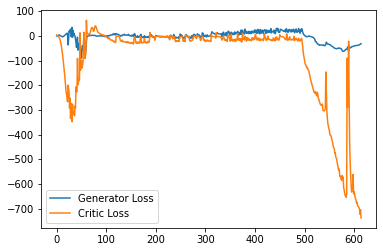

Step 12350: Generator loss: -28.910793533325194, critic loss: -753.1951816406253


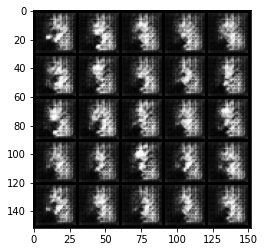

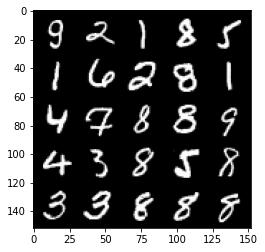

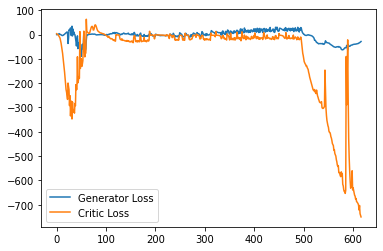

Step 12400: Generator loss: -26.89377616882324, critic loss: -781.6521856689453


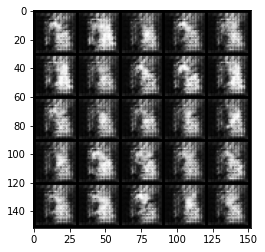

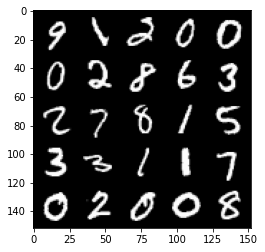

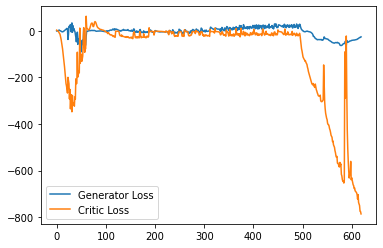

Step 12450: Generator loss: -22.272852935791015, critic loss: -814.093960693359


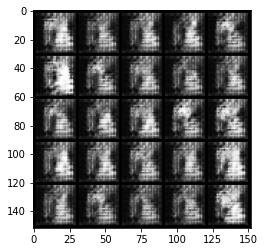

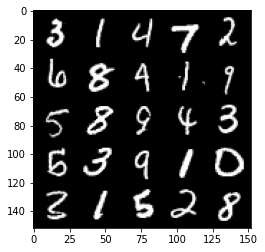

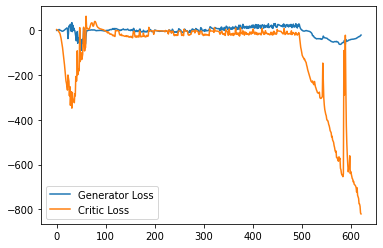

Step 12500: Generator loss: -40.296162643432616, critic loss: -267.0609293823242


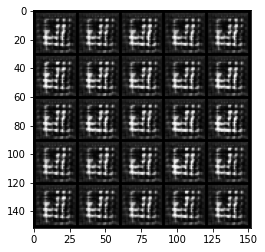

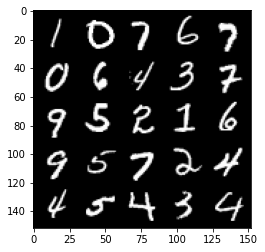

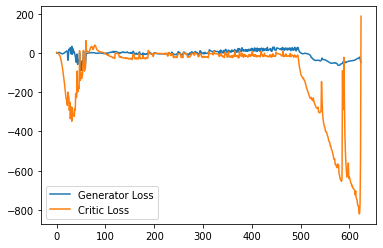

Step 12550: Generator loss: -43.606765942573546, critic loss: 291.7007626342773


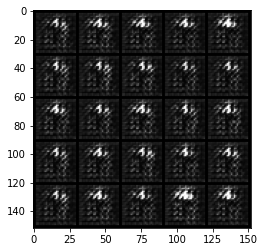

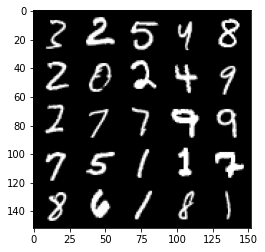

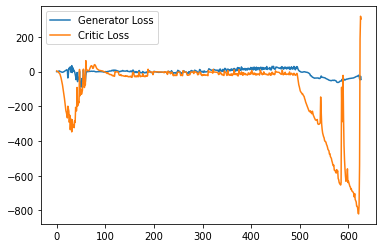

Step 12600: Generator loss: -89.17077865600587, critic loss: 38.292664123535154


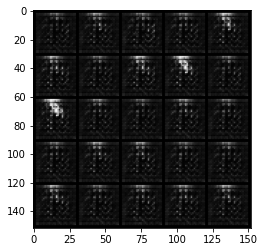

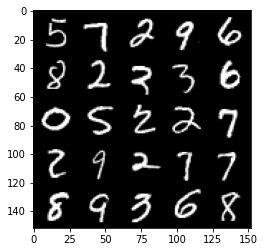

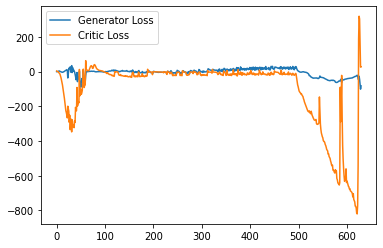

Step 12650: Generator loss: -74.2726806640625, critic loss: -5.207031066894526


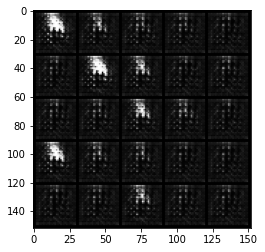

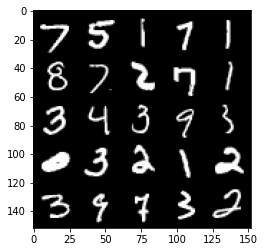

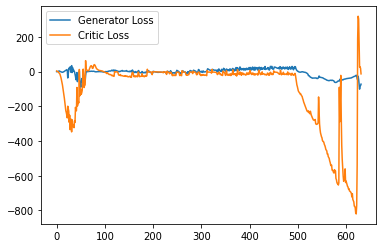

Step 12700: Generator loss: -64.00277244567872, critic loss: -143.96141265869142


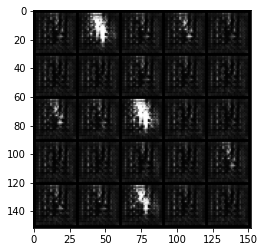

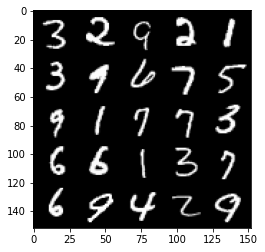

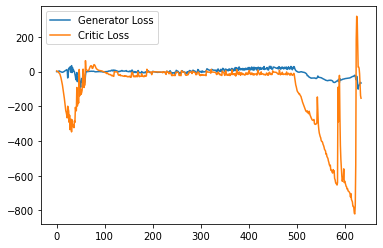

Step 12750: Generator loss: -66.88994575500489, critic loss: -200.64836480712884


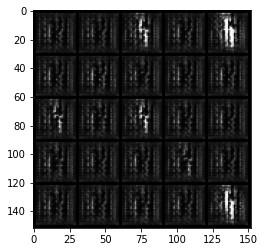

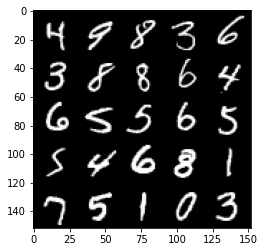

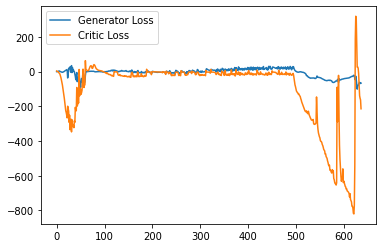

Step 12800: Generator loss: -59.55942108154297, critic loss: -284.8131642456055


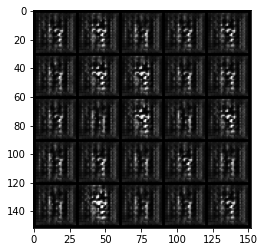

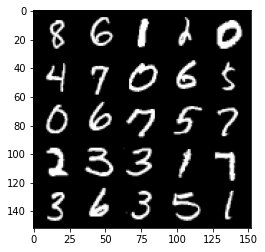

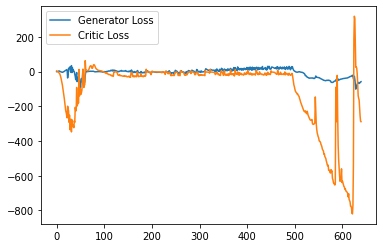

Step 12850: Generator loss: -59.99540664672852, critic loss: -271.7015835571289


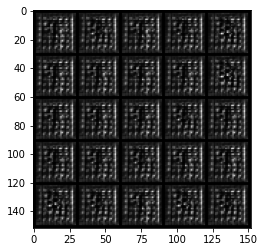

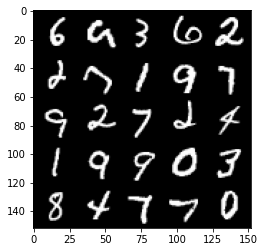

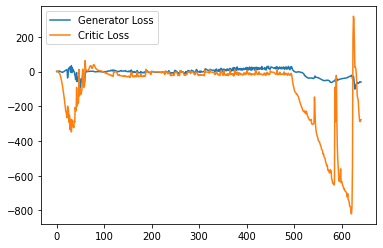

Step 12900: Generator loss: -42.556969165802, critic loss: -176.80019323730482


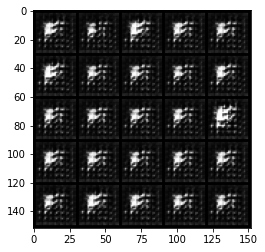

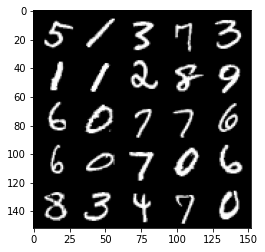

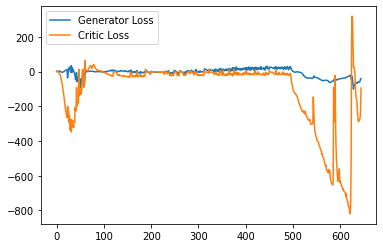

KeyboardInterrupt: 

In [15]:
import matplotlib.pyplot as plt

cur_step = 0
generator_losses = []
critic_losses = []
for epoch in range(n_epochs):
    # Dataloader returns the batches
    for real, _ in tqdm(dataloader):
        cur_batch_size = len(real)
        real = real.to(device)

        mean_iteration_critic_loss = 0
        for _ in range(crit_repeats):
            ### Update critic ###
            crit_opt.zero_grad()
            fake_noise = get_noise(cur_batch_size, z_dim, device=device)
            fake = gen(fake_noise)
            crit_fake_pred = crit(fake.detach())
            crit_real_pred = crit(real)

            epsilon = torch.rand(len(real), 1, 1, 1, device=device, requires_grad=True)
            gradient = get_gradient(crit, real, fake.detach(), epsilon)
            gp = gradient_penalty(gradient)
            crit_loss = get_crit_loss(crit_fake_pred, crit_real_pred, gp, c_lambda)

            # Keep track of the average critic loss in this batch
            mean_iteration_critic_loss += crit_loss.item() / crit_repeats
            # Update gradients
            crit_loss.backward(retain_graph=True)
            # Update optimizer
            crit_opt.step()
        critic_losses += [mean_iteration_critic_loss]

        ### Update generator ###
        gen_opt.zero_grad()
        fake_noise_2 = get_noise(cur_batch_size, z_dim, device=device)
        fake_2 = gen(fake_noise_2)
        crit_fake_pred = crit(fake_2)
        
        gen_loss = get_gen_loss(crit_fake_pred)
        gen_loss.backward()

        # Update the weights
        gen_opt.step()

        # Keep track of the average generator loss
        generator_losses += [gen_loss.item()]

        ### Visualization code ###
        if cur_step % display_step == 0 and cur_step > 0:
            gen_mean = sum(generator_losses[-display_step:]) / display_step
            crit_mean = sum(critic_losses[-display_step:]) / display_step
            print(f"Step {cur_step}: Generator loss: {gen_mean}, critic loss: {crit_mean}")
            show_tensor_images(fake)
            show_tensor_images(real)
            step_bins = 20
            num_examples = (len(generator_losses) // step_bins) * step_bins
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(generator_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Generator Loss"
            )
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(critic_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Critic Loss"
            )
            plt.legend()
            plt.show()

        cur_step += 1
